# 1 - Tests on kernels

With extrapolation

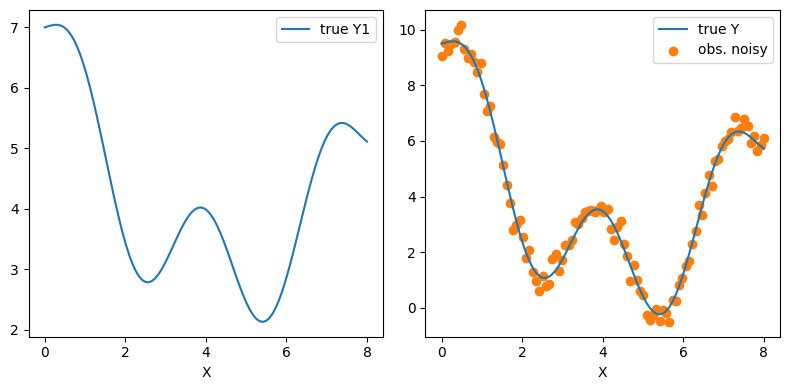

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np

from stheno import Measure, GP, EQ, RQ, Linear, Delta, Exp, B

# Some stupid model with a latent function
nb_samples = 100
x = B.linspace(0, 8, 100)
x_obs = B.linspace(0, 8, nb_samples)

# the latent functions
y1 = np.sin(x*2.)+ 0.2*x+2. +0.2*(x-5)**2
# the final function
y2 = -4.5+2*y1
noise = np.random.randn(nb_samples)*0.3 # some noise
y1_obs = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
y_obs = -4.5+2*y1_obs + noise # Observations

# Make plot
plt.figure(figsize=(8,4), dpi=100)
plt.subplot(1,2,1)
plt.plot(x,y1,label="true Y1")
plt.legend()
plt.xlabel('X')
# plt.ylabel('latent Y1')
plt.subplot(1,2,2)
plt.plot(x,y2,label="true Y")
plt.scatter(x_obs,y_obs,color="C1",label="obs. noisy")
plt.tight_layout()
plt.legend()
plt.xlabel('X')
# plt.ylabel('latent Y')
plt.show()

+ Kernels EQ and Linear

GP(0, EQ() + Linear())
GP(-4.5 * 1, 4.0 * (EQ() + Linear()) + 0.010000000000000002 * Delta())


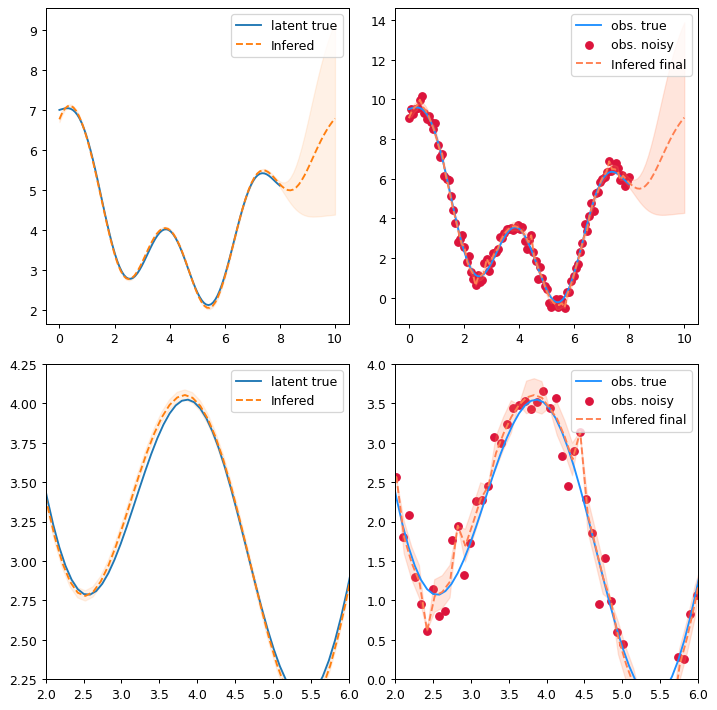

In [2]:
# Using Stheno because it seems easy
prior = Measure()
f1 = GP(EQ(),measure=prior) + GP(Linear(),measure=prior) # Construct Gaussian process.
f_noise = 0.1*GP(Delta(),measure=prior)
f2 = -4.5 + 2.0*f1 + f_noise

# Compute the posterior.
f2_post = f2 | (f2(x_obs), y_obs)            
f1_post = f1 | (f2(x_obs), y_obs) 

# infer at given points
x_preds = np.linspace(0,10,100)
#f1_post(x_preds).mean()
mean_f1, lower_f1, upper_f1 = f1_post(x_preds).marginal_credible_bounds()
mean_f2, lower_f2, upper_f2 = f2_post(x_preds).marginal_credible_bounds()

print(f1.display())
print(f2.display())

# Make plot
plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)

plt.legend()

plt.subplot(224)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()
plt.tight_layout()

plt.show()

+ Kernels EQ, Linear and Exp

GP(0, EQ() + Linear() + Matern12())
GP(-4.5 * 1, 4.0 * (EQ() + Linear() + Matern12()) + 0.010000000000000002 * Delta())


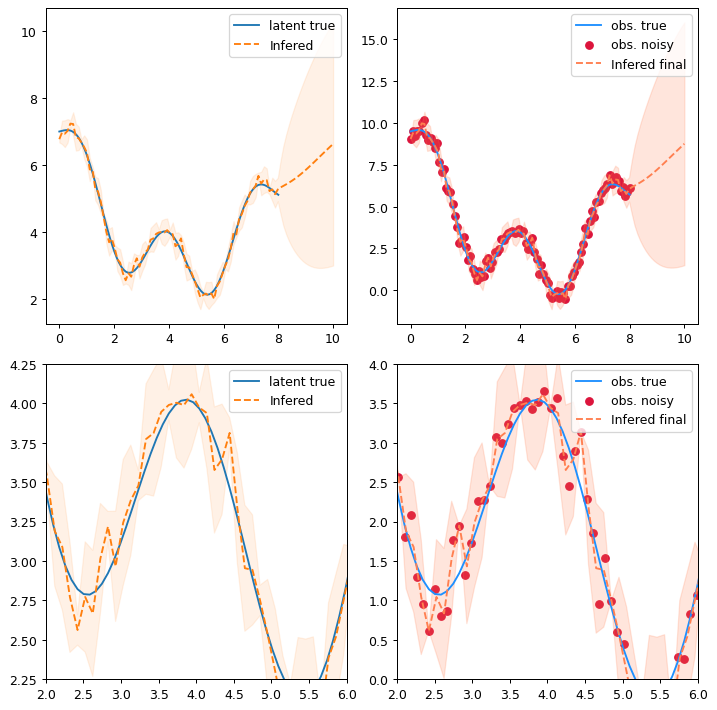

In [3]:
# Using Stheno because it seems easy
prior = Measure()
f1 = GP(EQ(),measure=prior) + GP(Linear(),measure=prior) +GP(Exp(), measure=prior) # Construct Gaussian process.
f_noise = 0.1*GP(Delta(),measure=prior)
f2 = -4.5 + 2.0*f1 + f_noise

# Compute the posterior.
f2_post = f2 | (f2(x_obs), y_obs)            
f1_post = f1 | (f2(x_obs), y_obs) 

# infer at given points
x_preds = np.linspace(0,10,100)
#f1_post(x_preds).mean()
mean_f1, lower_f1, upper_f1 = f1_post(x_preds).marginal_credible_bounds()
mean_f2, lower_f2, upper_f2 = f2_post(x_preds).marginal_credible_bounds()

print(f1.display())
print(f2.display())

# Make plot
plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)

plt.legend()

plt.subplot(224)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()

plt.tight_layout()

plt.show()

+ Kernels EQ and Exp

GP(0, EQ() + Matern12())
GP(-4.5 * 1, 4.0 * (EQ() + Matern12()) + 0.010000000000000002 * Delta())


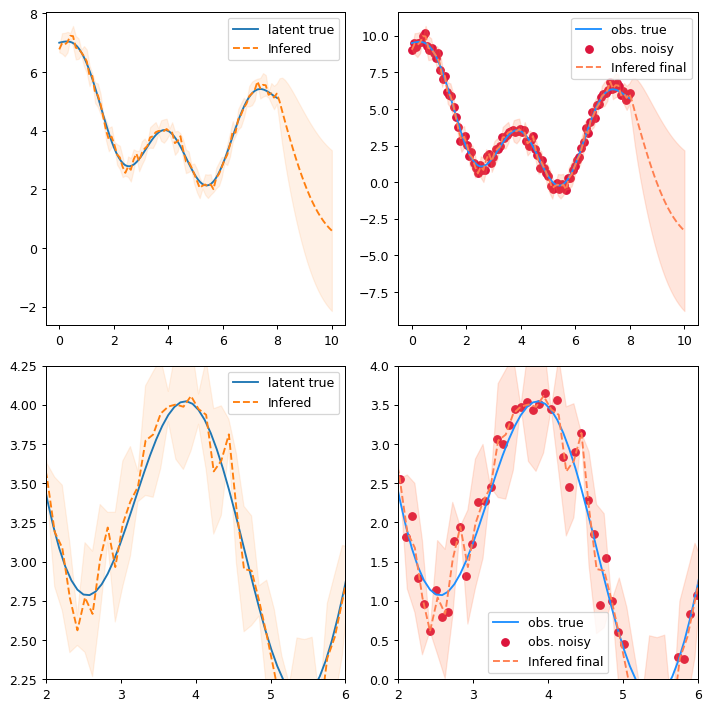

In [4]:
# Using Stheno because it seems easy
prior = Measure()
f1 = GP(EQ(),measure=prior) +GP(Exp(), measure=prior) # Construct Gaussian process.
f_noise = 0.1*GP(Delta(),measure=prior)
f2 = -4.5 + 2.0*f1 + f_noise

# Compute the posterior.
f2_post = f2 | (f2(x_obs), y_obs)            
f1_post = f1 | (f2(x_obs), y_obs) 

# infer at given points
x_preds = np.linspace(0,10,100)
#f1_post(x_preds).mean()
mean_f1, lower_f1, upper_f1 = f1_post(x_preds).marginal_credible_bounds()
mean_f2, lower_f2, upper_f2 = f2_post(x_preds).marginal_credible_bounds()

print(f1.display())
print(f2.display())

# Make plot
plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)

plt.legend()

plt.subplot(224)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()

plt.tight_layout()

plt.show()

+ Kernel RQ

GP(0, RQ(2))
GP(-4.5 * 1, 4.0 * RQ(2) + 0.010000000000000002 * Delta())


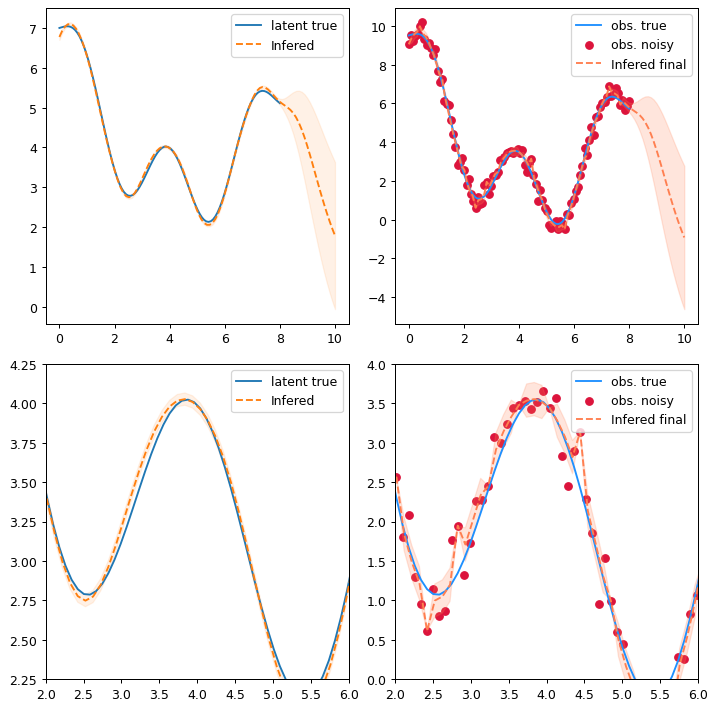

In [5]:
# Using Stheno because it seems easy
prior = Measure()
f1 = GP(RQ(2), measure=prior) # Construct Gaussian process.
f_noise = 0.1*GP(Delta(),measure=prior)
f2 = -4.5 + 2.0*f1 + f_noise

# Compute the posterior.
f2_post = f2 | (f2(x_obs), y_obs)            
f1_post = f1 | (f2(x_obs), y_obs) 

# infer at given points
x_preds = np.linspace(0,10,100)
#f1_post(x_preds).mean()
mean_f1, lower_f1, upper_f1 = f1_post(x_preds).marginal_credible_bounds()
mean_f2, lower_f2, upper_f2 = f2_post(x_preds).marginal_credible_bounds()

print(f1.display())
print(f2.display())

# Make plot
plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x,y1,label="latent true")
plt.plot(x_preds, mean_f1, "--", color="C1", label="Infered")
plt.fill_between(x_preds, lower_f1, upper_f1, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)

plt.legend()

plt.subplot(224)

plt.plot(x,y2,color='dodgerblue',label="obs. true")
plt.scatter(x_obs,y_obs,color="crimson",label="obs. noisy")
plt.plot(x_preds,mean_f2, "--",color="coral",label="Infered final")
plt.fill_between(x_preds, lower_f2, upper_f2, color="coral", alpha = 0.2)
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()

plt.tight_layout()

plt.show()

# 2 - Parameters optimisation

With kernel EQ and Linear

### 1 parameter to optimise (u_var + noise)

+ 100 observed data

+ 200 observed data

Prior:      GP(-4.5 * 1, 4.0 * (6.688 * EQ() + Linear()))
u_var:      2.586
noise:      0.07739


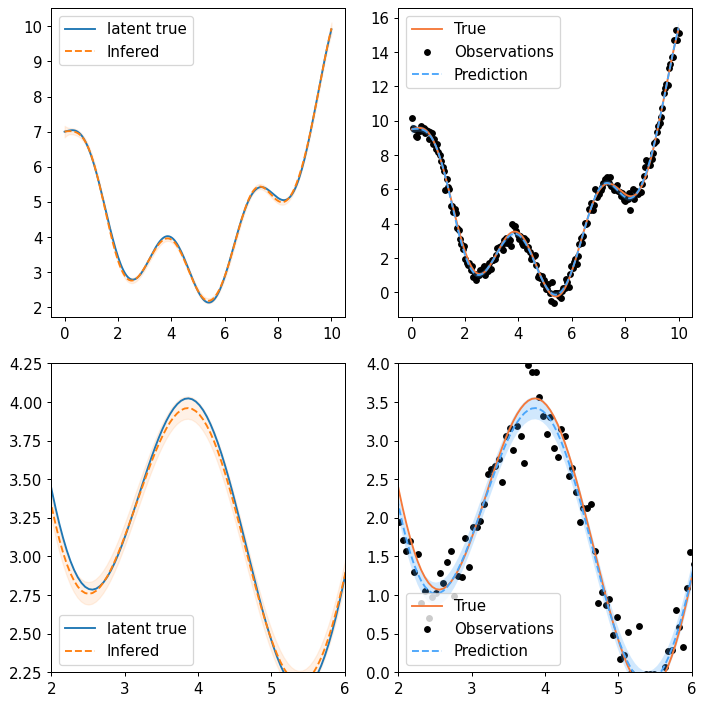

In [7]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 200

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()) + GP(Linear()) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

# Plot result.

plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()

plt.tight_layout()
plt.show()

+ 500 observed data

Prior:      GP(-4.5 * 1, 4.0 * (4.837 * EQ() + Linear()))
u_var:      2.199
noise:      0.08257


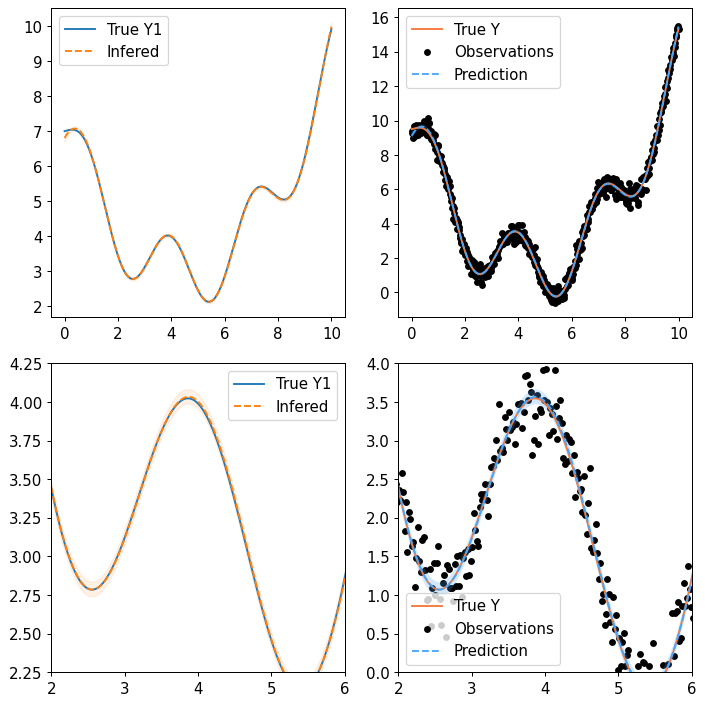

In [8]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 500

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()) + GP(Linear()) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

# Plot result.

plt.figure(figsize=(8,8), dpi=90)

plt.subplot(221)

plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)

plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend()

plt.subplot(223)

xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.legend()

plt.tight_layout()
plt.show()


### Using train test split

Define the function of predicting and plotting gaussian process

In [12]:
def gp_dummy_compute_plot(train_size,nb_sample,x_obs,x_model,y1,y2, plot, scale, optimize):
    
    # Some stupid model with a latent function
    print(f'\n\nSetting up the dummy function and its latent function using nb_samples = {nb_sample} ...')
    
    noise = np.random.randn(nb_sample) * 0.3 # some noise, use the same multiplier with data on NN (0.3)
    y_obs = y2(x_obs) + noise # Observations
    
    if scale == True:
        from sklearn.preprocessing import StandardScaler
        X_scaler = StandardScaler()
        Y1_scaler = StandardScaler()
        Y2_scaler = StandardScaler()

        x_obs = X_scaler.fit_transform(x_obs.reshape(-1,1))
        y_obs = Y2_scaler.fit_transform(y_obs.reshape(-1,1))
        y1 = Y1_scaler.fit_transform(y1.reshape(-1,1))
        y2 = Y2_scaler.fit_transform(y2.reshape(-1,1))
#       scaler.inverse_transform(x)
    
    # test train data split
    print(f'Splitting {train_size*100}% of {nb_sample} data set into training set ...')
    x_train, x_test, y_train, y_test = train_test_split(x_obs, y_obs,train_size = train_size, random_state=42)
    x_train, x_valid, y_train, y_valid = train_test_split(x_train, y_train,train_size = 0.8, random_state=42)

    if optimize == True:
        print('Building the Gaussian Process model without optimization ...')
        # Sample a true, underlying function and observations.
        vs = Vars(tf.float64)

        def objective(vs):
            f, f2, noise = model(vs)
            evidence = f2(x_obs, noise).logpdf(y_obs)
            return -evidence

        # Learn hyperparameters.
        print('Learning the hyperparameters ...')
        minimise_l_bfgs_b(objective, vs, jit=True)

        print('Building the Gaussian Process model ...')
        f, f2, noise = model(vs)

        # Print the learned parameters.
        print('Selected parameters:')
        out.kv("Prior", f2.display(out.format))
        vs.print()

        # Condition on the observations to make predictions.
        print('Making posterior Gaussian Process model ...')
        f2_post = f2 | (f2(x_train, noise), y_train)
        f_post = f | (f2(x_train, noise), y_train)
                

    else:
        # if not using optimization
        # Using Stheno because it seems easy
        print('Building the Gaussian Process model without optimization ...')
        prior = Measure()
        f1 = GP(EQ(),measure=prior) + GP(Linear(),measure=prior) # Construct Gaussian process.
        f_noise = 0.3*GP(Delta(),measure=prior)
        f2 = -4.5 + 2.0*f1 + f_noise

        # Compute the posterior.
        print('Making posterior Gaussian Process model ...')
        f2_post = f2 | (f2(x_train), y_train)            
        f_post = f1 | (f2(x_train), y_train)
    
    print('Making prediction in each point ...')
    
    # GP model using desired x interval
    mean, lower, upper = f_post(x_model).marginal_credible_bounds()
    mean2, lower2, upper2 = f2_post(x_model).marginal_credible_bounds()
    
    # GP model of true latent function
    mean_train, lower_train, upper_train = f_post(x_train).marginal_credible_bounds()
    mean_valid, lower_valid, upper_valid = f_post(x_valid).marginal_credible_bounds()
    mean_test, lower_test, upper_test = f_post(x_test).marginal_credible_bounds()
    
    # GP model of observed function
    mean2_train, lower2_train, upper2_train = f2_post(x_train).marginal_credible_bounds()
    mean2_valid, lower2_valid, upper2_valid = f2_post(x_valid).marginal_credible_bounds()
    mean2_test, lower2_test, upper2_test = f2_post(x_test).marginal_credible_bounds()

    # to compute test error
    print('Calculating the RMSE Error ...')
    
    # error on latent function Y1
    RMSE1_train = np.sqrt(mean_squared_error(y1(x_train), mean_train))
    RMSE1_test = np.sqrt(mean_squared_error(y1(x_test), mean_test))
    
    # error on observed data and actual Y function
    RMSE2_train = np.sqrt(mean_squared_error(y2(x_train), mean2_train)) # using only the training dataset only
    RMSE2_train_true = np.sqrt(mean_squared_error(y2(x_train), mean2_train)) # using actual Y function instead of latent function Y1
    RMSE2_valid = np.sqrt(mean_squared_error(y_valid, mean2_valid)) # using only the validation dataset only\
    RMSE2_test = np.sqrt(mean_squared_error(y_test, mean2_test)) # using only the test dataset only
    RMSE2_test_true = np.sqrt(mean_squared_error(y2(x_test), mean2_test)) # using actual Y function instead of latent function Y1
    
    print("Train RMSE of observed values: {:0.5f}" .format(RMSE2_train))
    print("Test RMSE of observed values: {:0.5f}" .format(RMSE2_test))
    
    print("Train RMSE of observed true values: {:0.5f}" .format(RMSE2_train_true))
    print("Test RMSE of observed true values: {:0.5f}" .format(RMSE2_test_true))
    
    print("Train RMSE of observed values: {:0.5f}" .format(RMSE1_train))
    print("Test RMSE of latent function: {:0.5f}" .format(RMSE1_test))\
    

    # Plot results.
    if plot == True:
        print('Plotting results ...')
        plt.figure(figsize=(8,8), dpi=90)

        plt.subplot(221)

        plt.plot(x_model, y1(x_model),label="true Y1")
        plt.plot(x_model, mean, "--", color="C1", label="Prediction")
        plt.fill_between(x_model, lower, upper, color="C1", alpha = 0.1)

        plt.legend(fontsize=10)

        plt.subplot(222)

        plt.plot(x_model, y2(x_model), label="true Y", style="test")
        plt.scatter(x_train, y_train, label="Observations", style="train", s=20)
        plt.plot(x_model, mean2, label="Prediction", style="pred")
        plt.fill_between(x_model, lower2, upper2, style="pred")
        #plt.xlim(2,6)
        #plt.ylim(0,4)
        plt.legend(fontsize=10)

        plt.subplot(223)

        xlg = 2
        xld = 6
        ylb = 0
        ylh = 4

        plt.plot(x_model,y1(x_model),label="true Y1")
        plt.plot(x_model, mean, "--", color="C1", label="Prediction")
        plt.fill_between(x_model, lower, upper, color="C1", alpha = 0.1)
        plt.xlim(xlg,xld)
        plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
        plt.legend(fontsize=10)

        plt.subplot(224)

        plt.plot(x_model, y2(x_model), label="true Y", style="test")
        plt.scatter(x_train, y_train, label="Observations", style="train", s=20)
        plt.plot(x_model, mean2, label="Prediction", style="pred")
        plt.fill_between(x_model, lower2, upper2, style="pred")
        plt.xlim(xlg,xld)
        plt.ylim(ylb,ylh)
        plt.legend(fontsize=10)

        plt.tight_layout()
        plt.show()
        
    else:
        print('Not plotting picture. To plot, activate it using the function key.')
    
    c1 = 'dodgerblue'
    c2 = 'tomato'
    c3 = 'limegreen'
    
    plt.figure(figsize=(10,5),dpi=100)
    plt.subplot(121)
    plt.scatter(mean2_train,y2(x_train),s=6,color=c1,label='train')
    plt.scatter(mean2_valid,y_valid,s=6,color=c2,label='valid')
    plt.scatter(mean2_test,y_test,s=6,color=c3,label='test')
    plt.plot([-1,10],[-1,10],'k--',color="grey",linewidth=2,label='1:1')
    plt.xlabel('Y observation')
    plt.ylabel('Y predictions')
    plt.legend()
    
    plt.subplot(122)
    plt.scatter(mean2_train,y_train,s=6,color=c1,label='train')
    plt.scatter(mean2_valid,y2(x_valid),s=6,color=c2,label='valid')
    plt.scatter(mean2_test,y2(x_test),s=6,color=c3,label='test')
    plt.plot([-1,10],[-1,10],'k--',color="grey",linewidth=2,label='1:1')
    plt.xlabel('True Y')
    plt.ylabel('Y predictions')
    plt.legend()
    
#     plt.figure(figsize=(8,6),dpi=100)
#     plt.scatter(mean_train,y1(x_train),s=6,color=c1,label='train')
#     plt.scatter(mean_valid,y1(x_valid),s=6,color=c2,label='valid')
#     plt.scatter(mean_test,y1(x_test),s=6,color=c3,label='test')
# #     plt.plot([-1,10],[-1,10],'k--',color="grey",linewidth=2,label='1:1')
#     plt.plot([2,7],[2,7],'k--',color="grey",linewidth=2,label='1:1')
# #     plt.title("Preds vs measurements")
#     plt.xlabel('True Y1')
#     plt.ylabel('Y1 predictions')
#     plt.legend()
    
    plt.show()

    return RMSE2_test, RMSE2_valid, RMSE2_train






No optimization



Setting up the dummy function and its latent function using nb_samples = 20 ...
Splitting 70.0% of 20 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.35179
Test RMSE of observed values: 2.87916
Train RMSE of observed true values: 0.35179
Test RMSE of observed true values: 2.72296
Train RMSE of observed values: 0.16682
Test RMSE of latent function: 1.36148
Plotting results ...


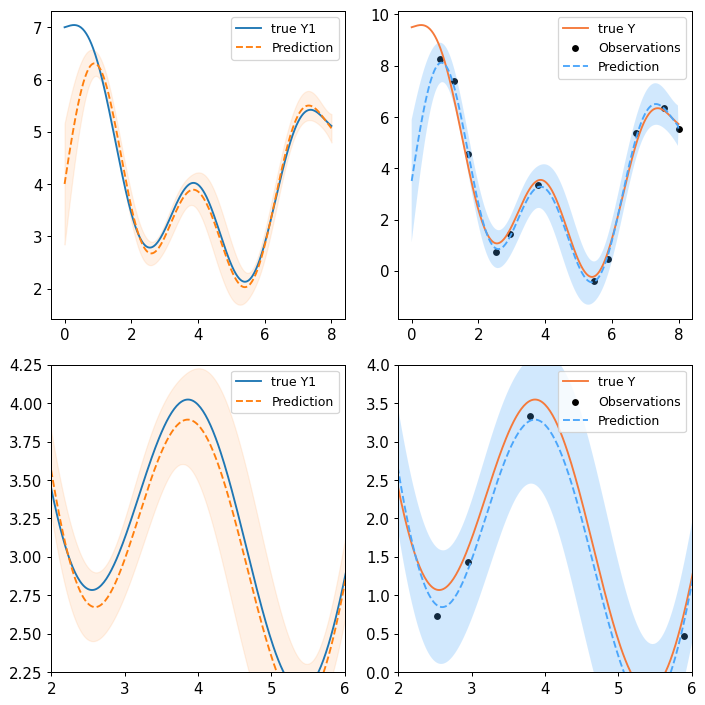

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


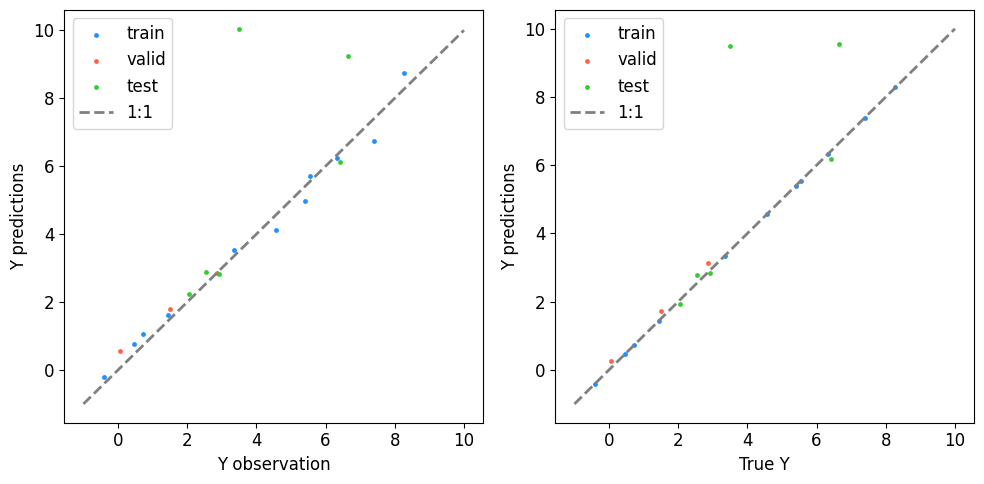



Setting up the dummy function and its latent function using nb_samples = 70 ...
Splitting 70.0% of 70 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27758
Test RMSE of observed values: 0.36216
Train RMSE of observed true values: 0.27758
Test RMSE of observed true values: 0.16810
Train RMSE of observed values: 0.05149
Test RMSE of latent function: 0.08405
Plotting results ...


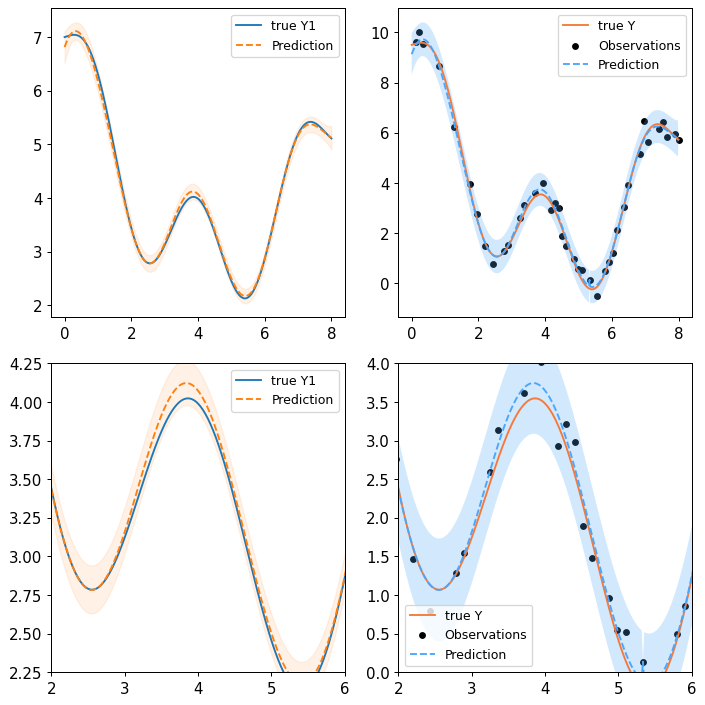

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


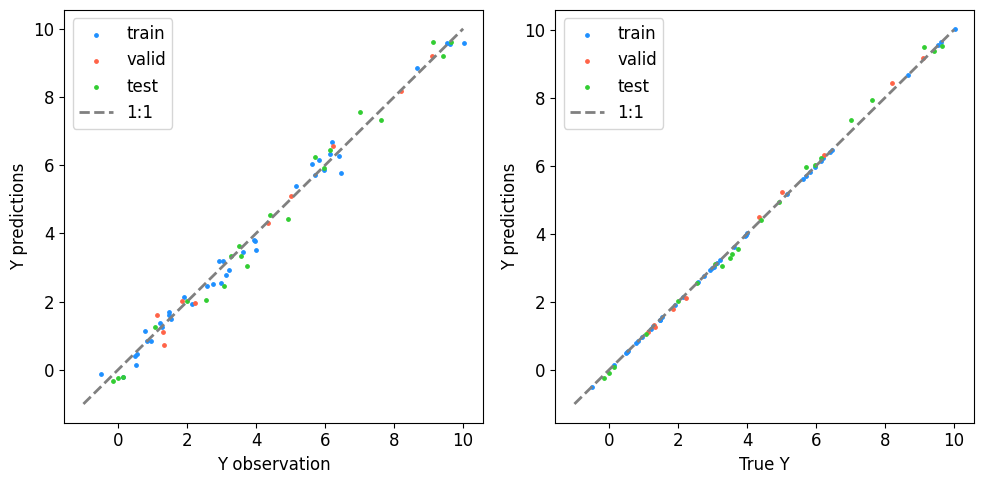



Setting up the dummy function and its latent function using nb_samples = 120 ...
Splitting 70.0% of 120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27198
Test RMSE of observed values: 0.30023
Train RMSE of observed true values: 0.27198
Test RMSE of observed true values: 0.15625
Train RMSE of observed values: 0.06305
Test RMSE of latent function: 0.07812
Plotting results ...


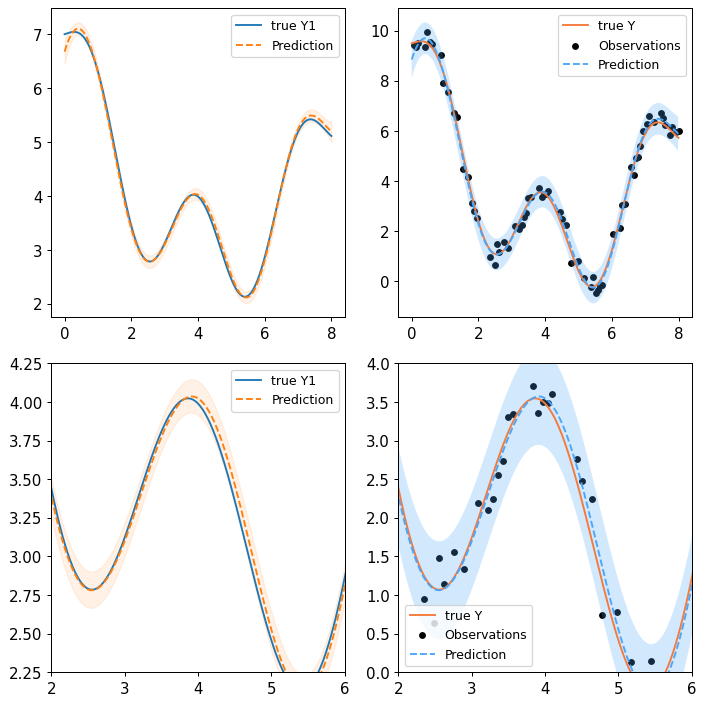

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


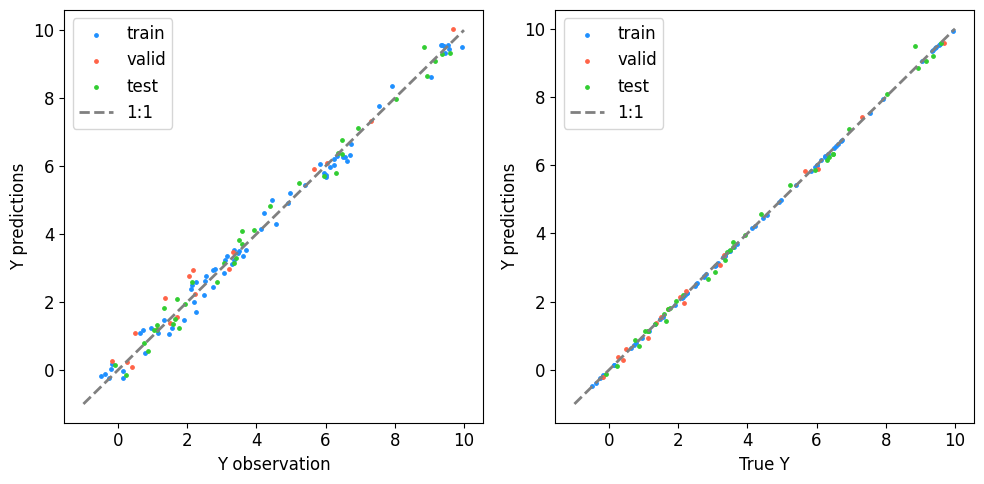



Setting up the dummy function and its latent function using nb_samples = 170 ...
Splitting 70.0% of 170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29013
Test RMSE of observed values: 0.30643
Train RMSE of observed true values: 0.29013
Test RMSE of observed true values: 0.11218
Train RMSE of observed values: 0.04814
Test RMSE of latent function: 0.05609
Plotting results ...


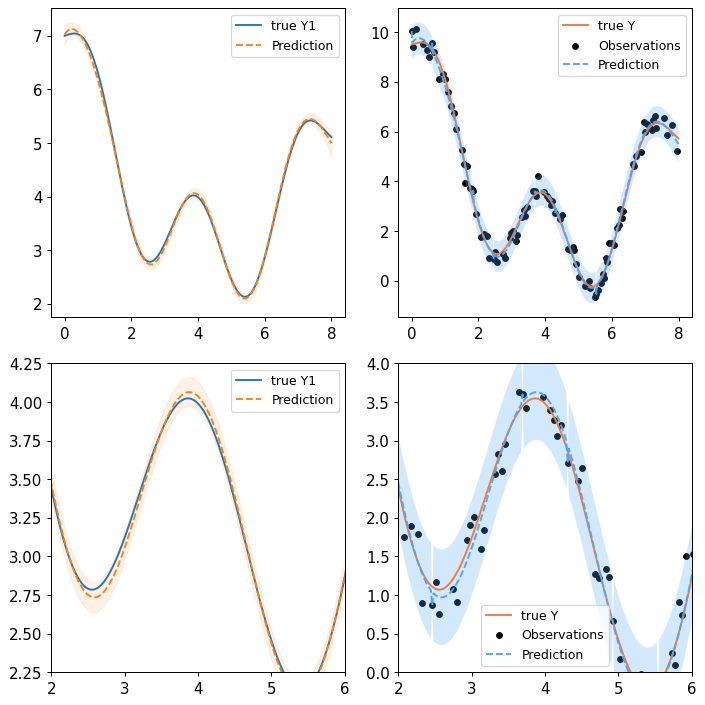

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


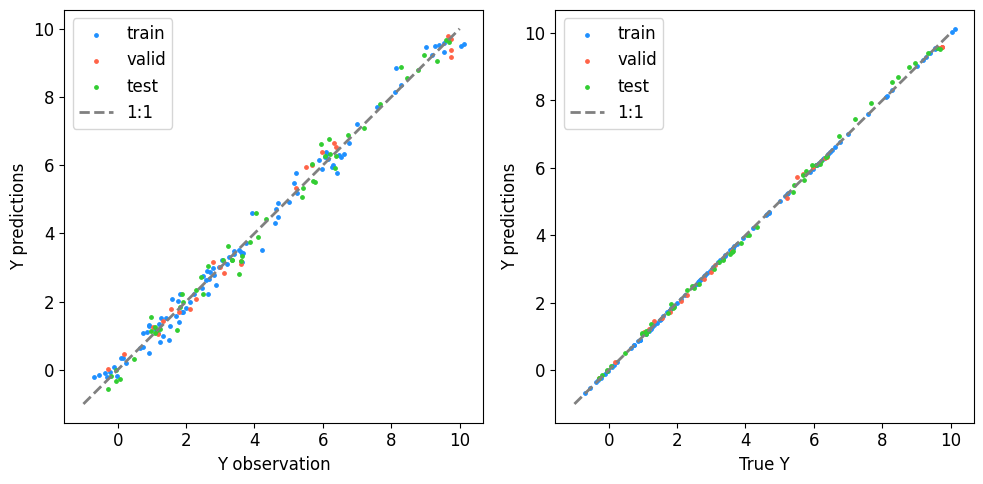



Setting up the dummy function and its latent function using nb_samples = 220 ...
Splitting 70.0% of 220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.34764
Test RMSE of observed values: 0.33081
Train RMSE of observed true values: 0.34764
Test RMSE of observed true values: 0.07555
Train RMSE of observed values: 0.04116
Test RMSE of latent function: 0.03777
Plotting results ...


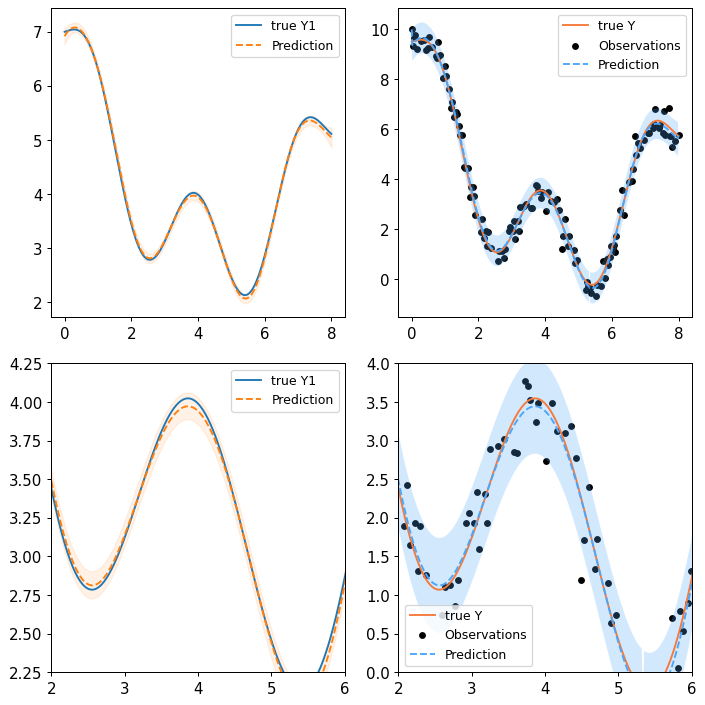

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


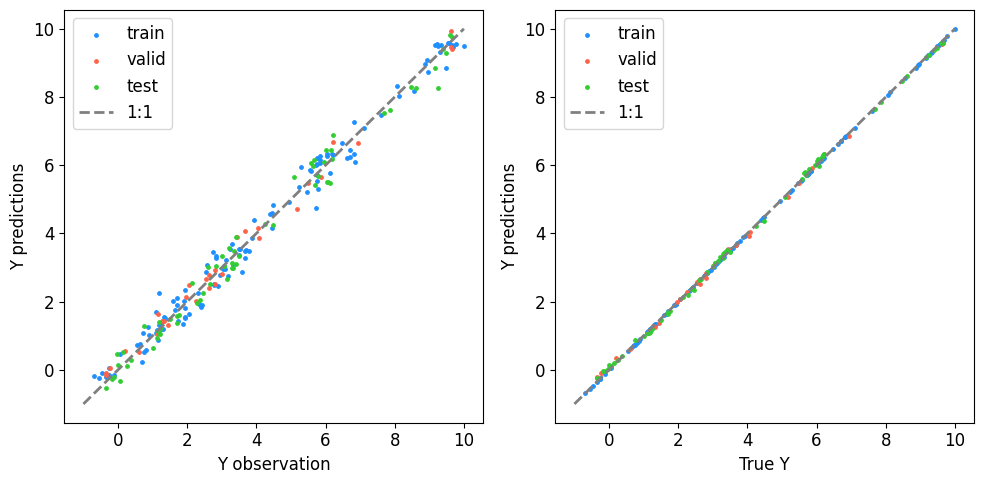



Setting up the dummy function and its latent function using nb_samples = 270 ...
Splitting 70.0% of 270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28515
Test RMSE of observed values: 0.36923
Train RMSE of observed true values: 0.28515
Test RMSE of observed true values: 0.09156
Train RMSE of observed values: 0.05077
Test RMSE of latent function: 0.04578
Plotting results ...


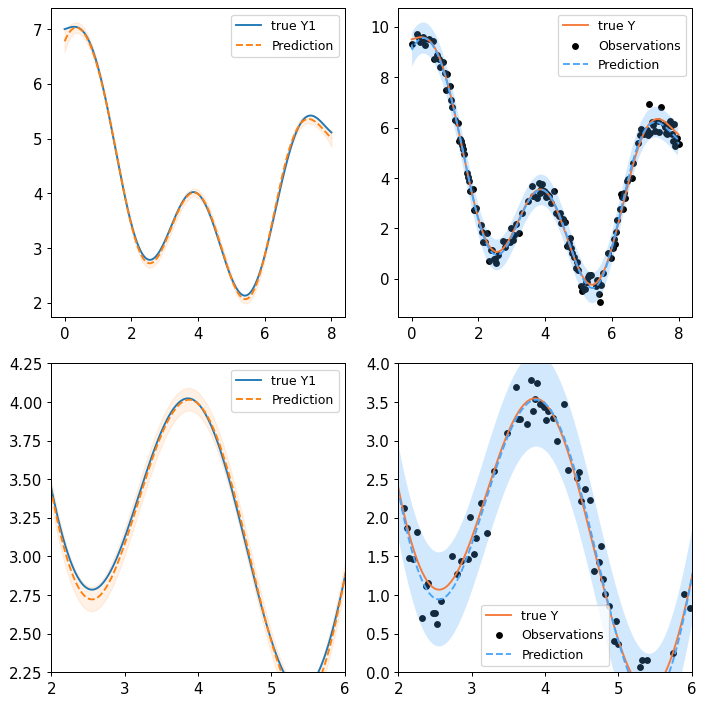

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


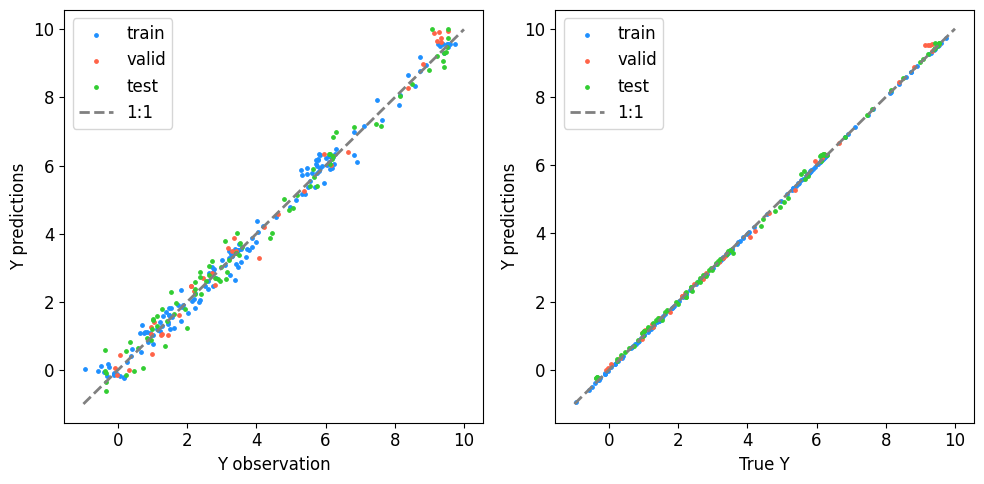



Setting up the dummy function and its latent function using nb_samples = 320 ...
Splitting 70.0% of 320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29889
Test RMSE of observed values: 0.30156
Train RMSE of observed true values: 0.29889
Test RMSE of observed true values: 0.07933
Train RMSE of observed values: 0.04448
Test RMSE of latent function: 0.03966
Plotting results ...


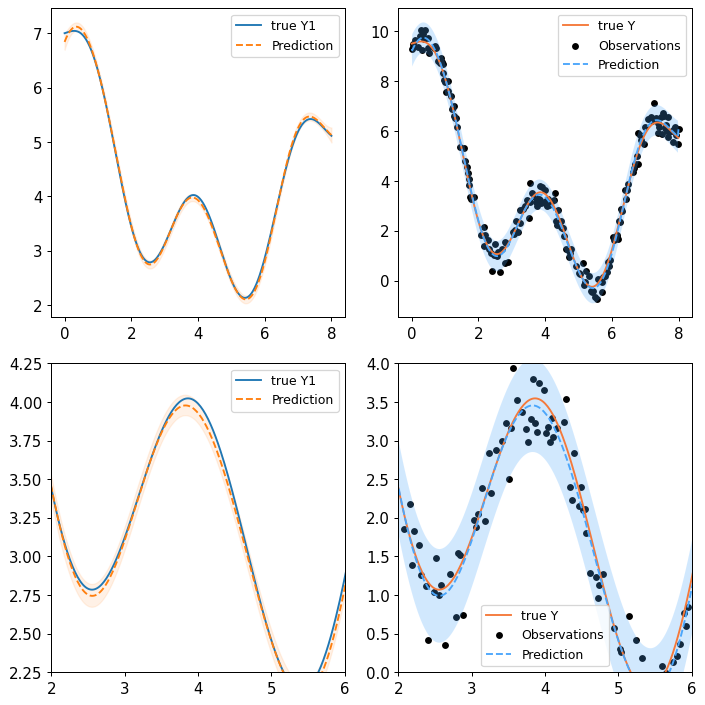

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


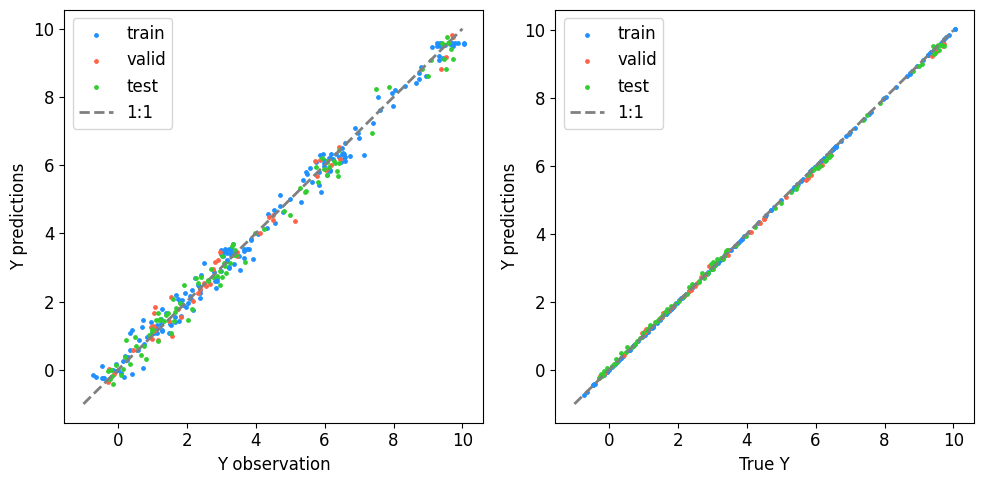



Setting up the dummy function and its latent function using nb_samples = 370 ...
Splitting 70.0% of 370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28213
Test RMSE of observed values: 0.29019
Train RMSE of observed true values: 0.28213
Test RMSE of observed true values: 0.08220
Train RMSE of observed values: 0.03918
Test RMSE of latent function: 0.04110
Plotting results ...


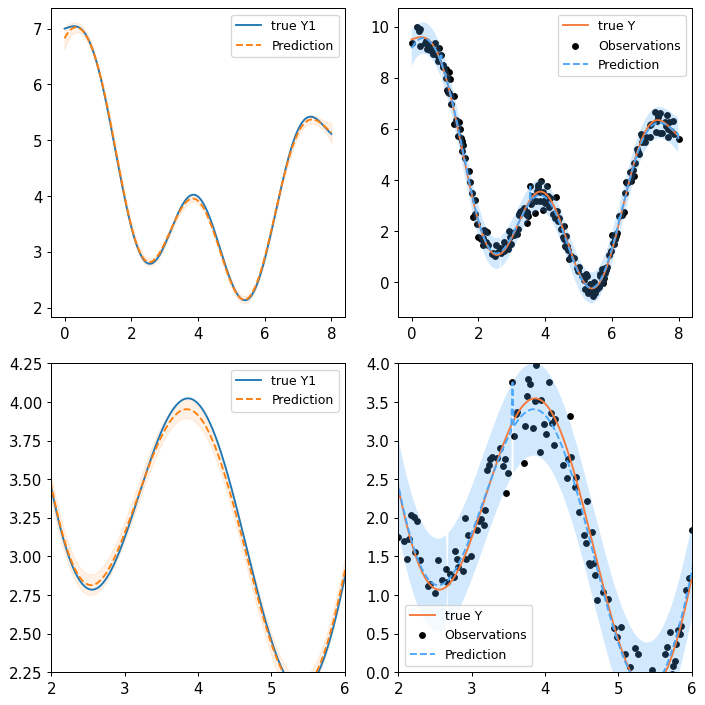

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


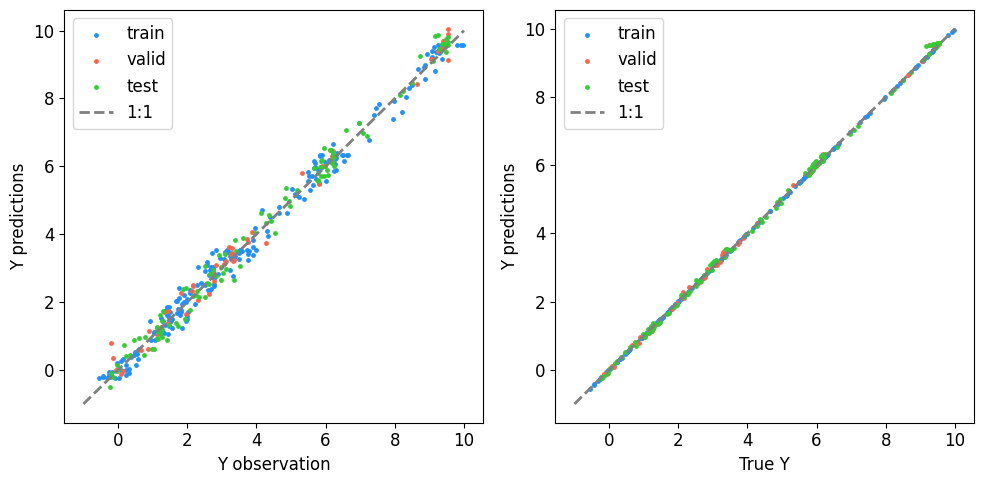



Setting up the dummy function and its latent function using nb_samples = 420 ...
Splitting 70.0% of 420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29701
Test RMSE of observed values: 0.31789
Train RMSE of observed true values: 0.29701
Test RMSE of observed true values: 0.09284
Train RMSE of observed values: 0.03832
Test RMSE of latent function: 0.04642
Plotting results ...


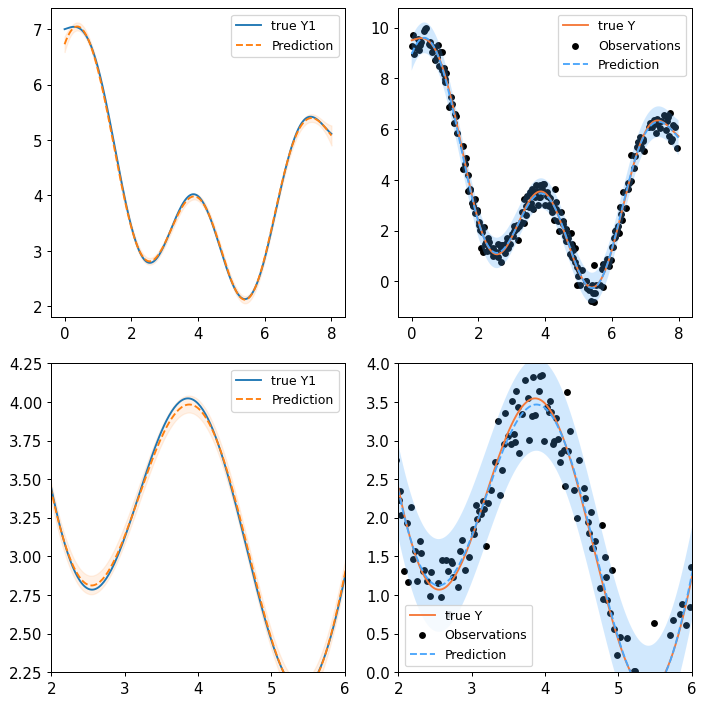

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


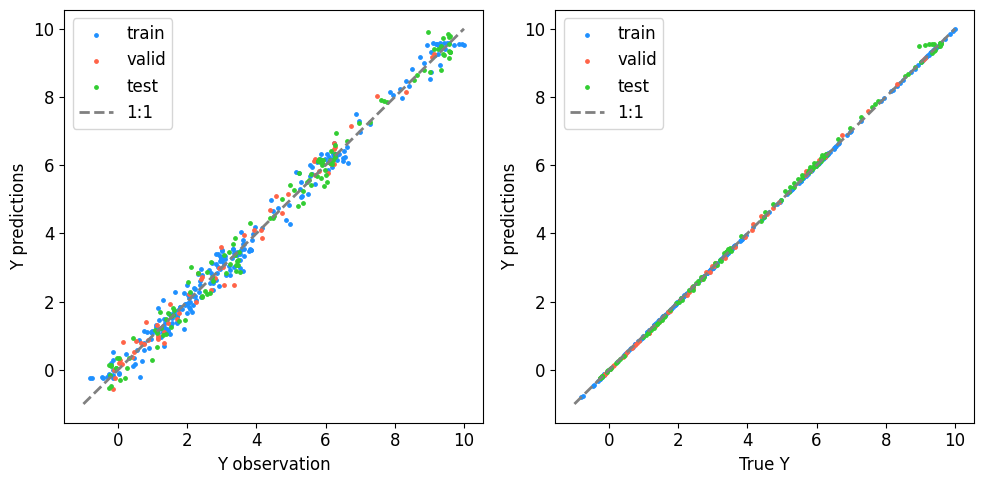



Setting up the dummy function and its latent function using nb_samples = 470 ...
Splitting 70.0% of 470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28872
Test RMSE of observed values: 0.28753
Train RMSE of observed true values: 0.28872
Test RMSE of observed true values: 0.07610
Train RMSE of observed values: 0.03469
Test RMSE of latent function: 0.03805
Plotting results ...


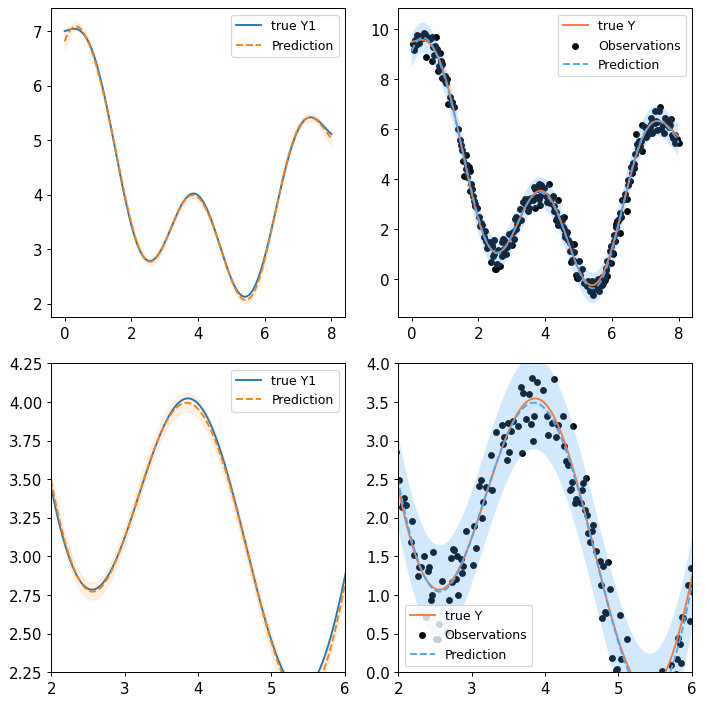

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


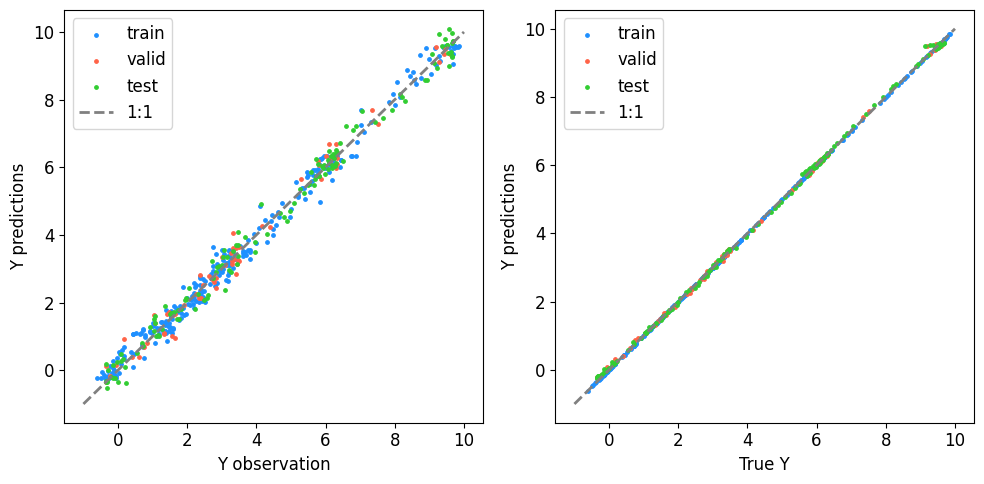

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_squared_error
    
def y1(x):
    return np.sin(x*2.)+ 0.2*x+2. +0.2*(x-5)**2

def y2(x):
    return -4.5+2*y1(x)

plot = True
scale =  False
optimize = False
train_size = 0.7

# nb_samples = np.arange(20,200,20) # regularly spaced number of sample
# nb_samples = [15,50,1000] # customized number of sample
nb_samples = np.arange(20,520,50)

rms = []
for nb_sample in nb_samples:
    
    x_obs = B.linspace(0.,8.,nb_sample)
    x_model = B.linspace(0.,8.,max(nb_samples)-1)
    
    rms_test, rms_valid, rms_train = gp_dummy_compute_plot(train_size, nb_sample, x_obs, x_model, y1, y2, plot, scale, optimize)
    rms.append([rms_test, rms_valid, rms_train])
    
    

[0.3517906135051088, 0.2775779117217427, 0.27197641065443856, 0.2901319087202984, 0.3476414318104242, 0.28515411336115526, 0.29889469892454656, 0.2821252102324867, 0.29701454227461754, 0.28872497387042523]


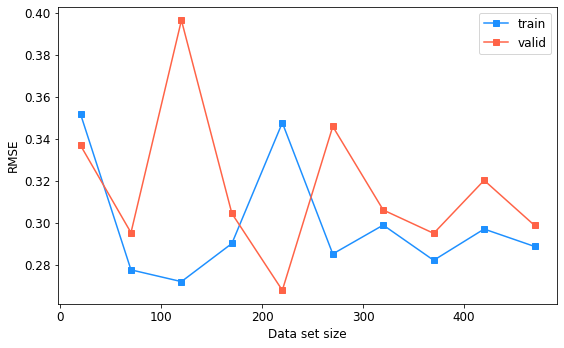

In [14]:
rms_test = [rms[i][0] for i in range(len(rms))]
rms_valid = [rms[i][1] for i in range(len(rms))]
rms_train = [rms[i][2] for i in range(len(rms))]
print(rms_train)

plt.figure(figsize=(8,5))
# plt.style.use('seaborn-whitegrid') # nice and clean grid
# plt.plot(train_sizes,rms1_test,'-o',label='Training')

c1 = 'dodgerblue'
c2 = 'tomato'
c3 = 'limegreen'

plt.plot(nb_samples,rms_train,'s-',color=c1, label='train')
plt.plot(nb_samples,rms_valid,'s-',color=c2, label='valid')
# plt.plot(nb_samples,rms_test,'o-',color=c3, label='test')

plt.xlabel('Data set size')
plt.ylabel('RMSE')
plt.legend()
# plt.ylim(0,1)
plt.show()

Using EQ and Linear kernel



Setting up the dummy function and its latent function using nb_samples = 20 ...
Splitting 56.00000000000001% of 20 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.20990
Test RMSE of observed values: 2.12363
Train RMSE of observed true values: 0.20990
Test RMSE of observed true values: 2.23777
Train RMSE of observed values: 0.13887
Test RMSE of latent function: 1.11888
Plotting results ...


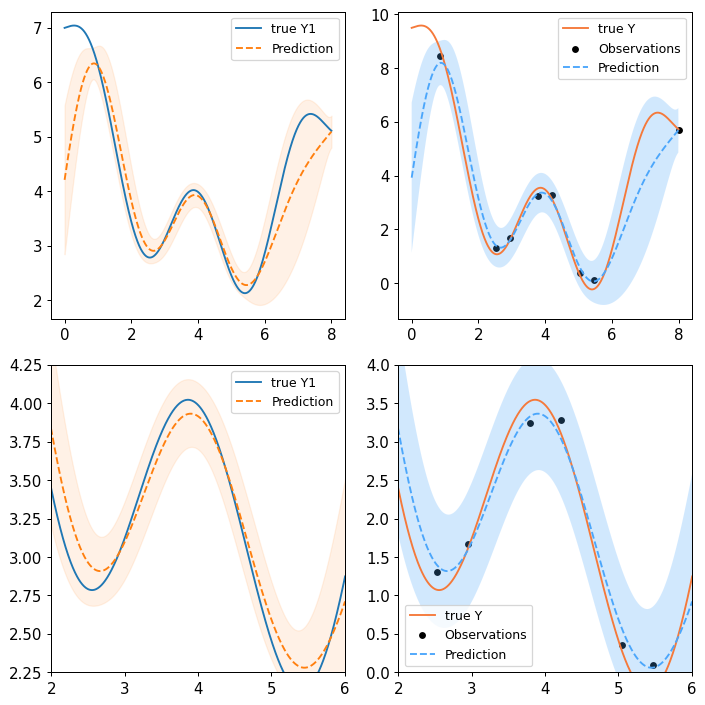

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


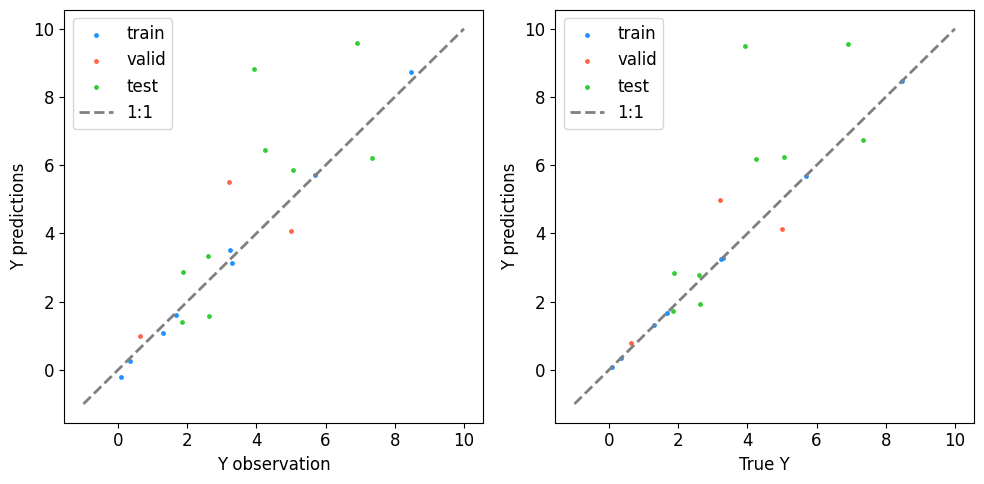



Setting up the dummy function and its latent function using nb_samples = 70 ...
Splitting 56.00000000000001% of 70 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.22001
Test RMSE of observed values: 0.41063
Train RMSE of observed true values: 0.22001
Test RMSE of observed true values: 0.28571
Train RMSE of observed values: 0.05121
Test RMSE of latent function: 0.14286
Plotting results ...


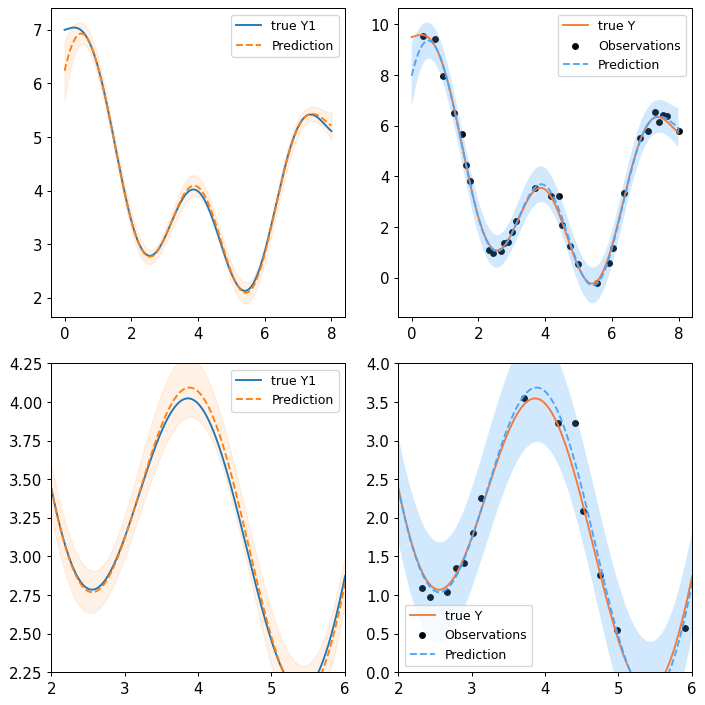

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


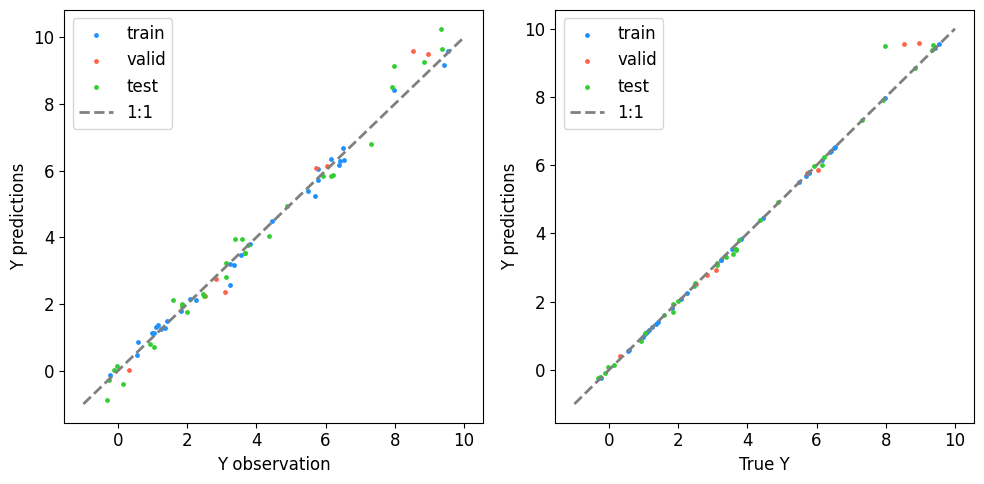



Setting up the dummy function and its latent function using nb_samples = 120 ...
Splitting 56.00000000000001% of 120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.26951
Test RMSE of observed values: 0.35050
Train RMSE of observed true values: 0.26951
Test RMSE of observed true values: 0.14038
Train RMSE of observed values: 0.06174
Test RMSE of latent function: 0.07019
Plotting results ...


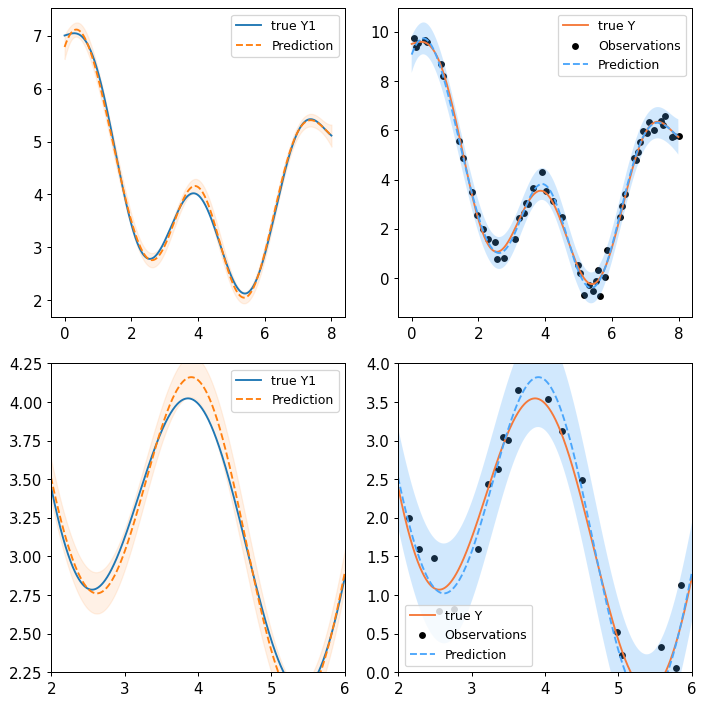

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


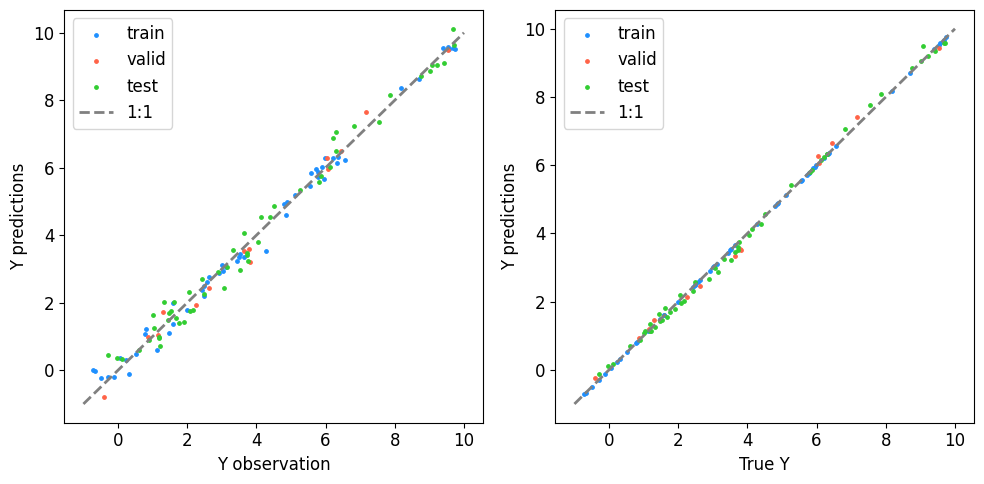



Setting up the dummy function and its latent function using nb_samples = 170 ...
Splitting 56.00000000000001% of 170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32480
Test RMSE of observed values: 0.30785
Train RMSE of observed true values: 0.32480
Test RMSE of observed true values: 0.10350
Train RMSE of observed values: 0.04668
Test RMSE of latent function: 0.05175
Plotting results ...


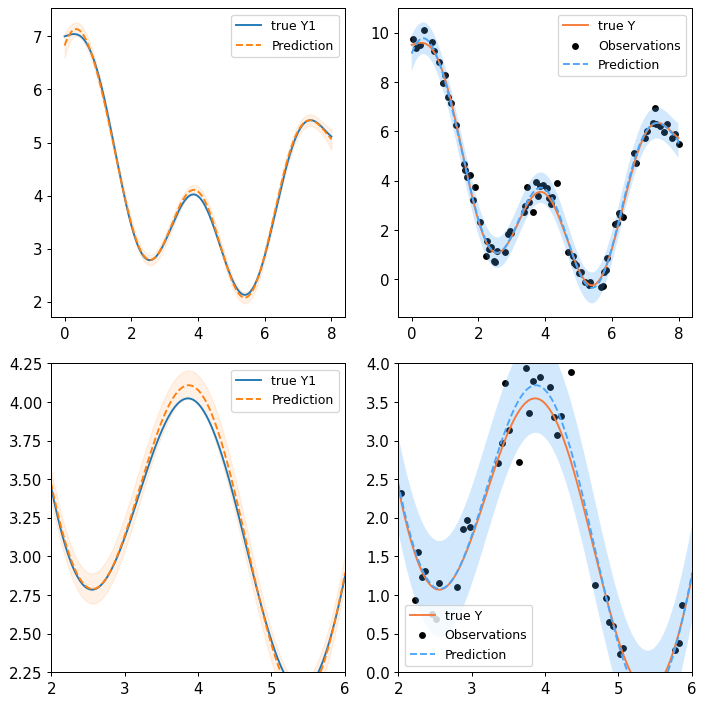

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


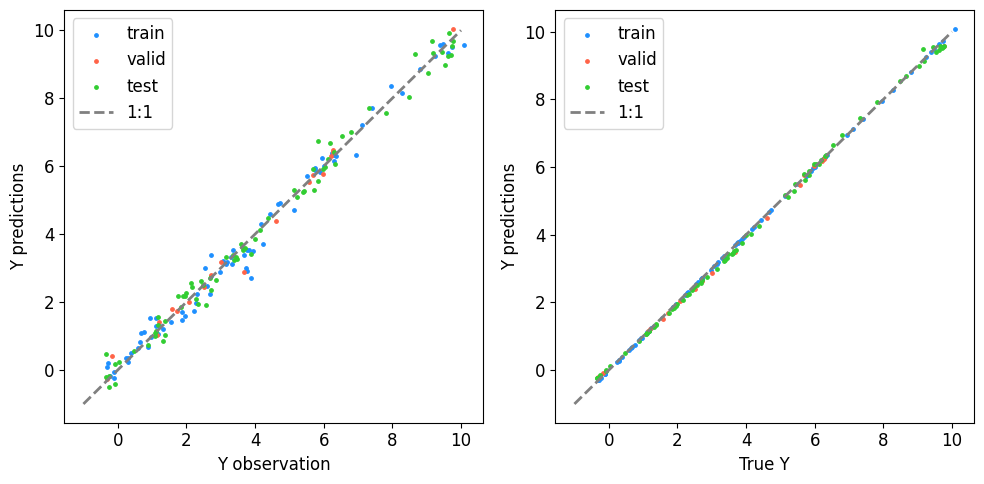



Setting up the dummy function and its latent function using nb_samples = 220 ...
Splitting 56.00000000000001% of 220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28808
Test RMSE of observed values: 0.37712
Train RMSE of observed true values: 0.28808
Test RMSE of observed true values: 0.12067
Train RMSE of observed values: 0.05403
Test RMSE of latent function: 0.06034
Plotting results ...


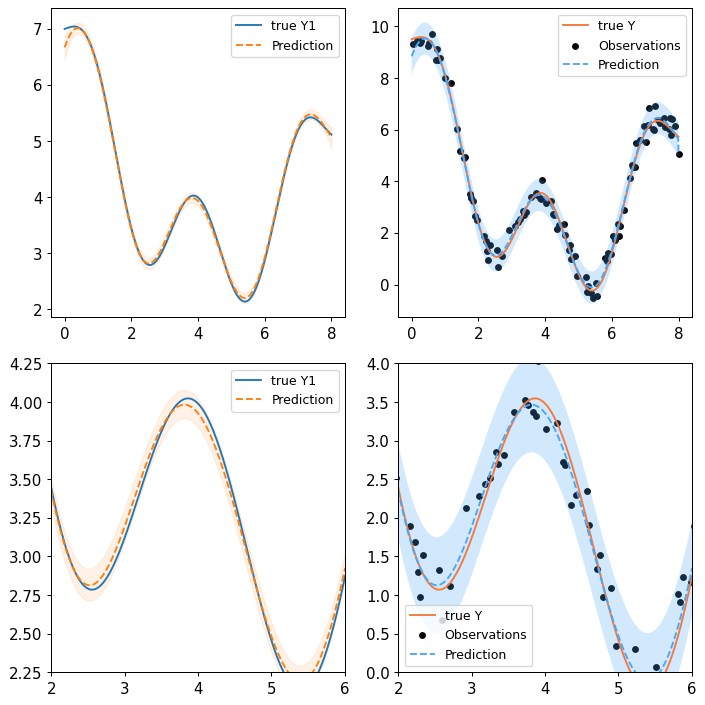

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


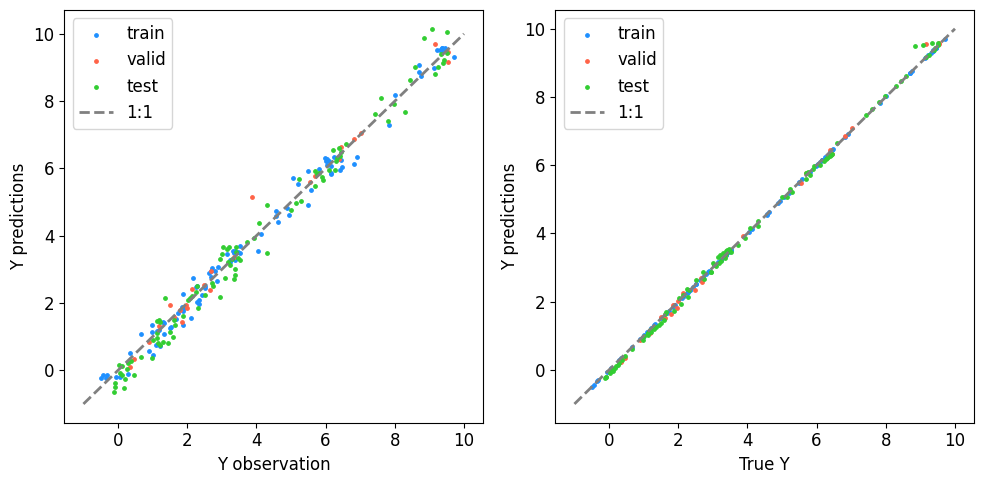



Setting up the dummy function and its latent function using nb_samples = 270 ...
Splitting 56.00000000000001% of 270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32821
Test RMSE of observed values: 0.31753
Train RMSE of observed true values: 0.32821
Test RMSE of observed true values: 0.11366
Train RMSE of observed values: 0.05816
Test RMSE of latent function: 0.05683
Plotting results ...


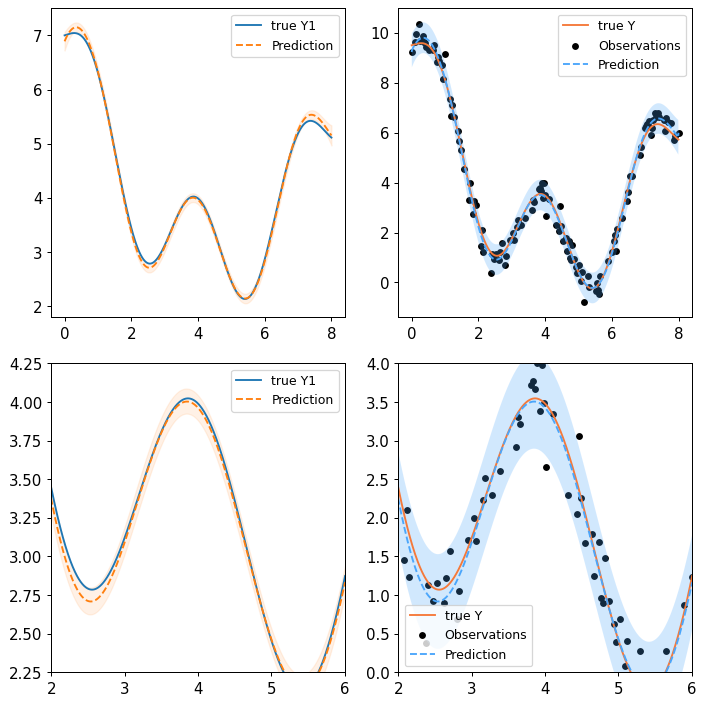

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


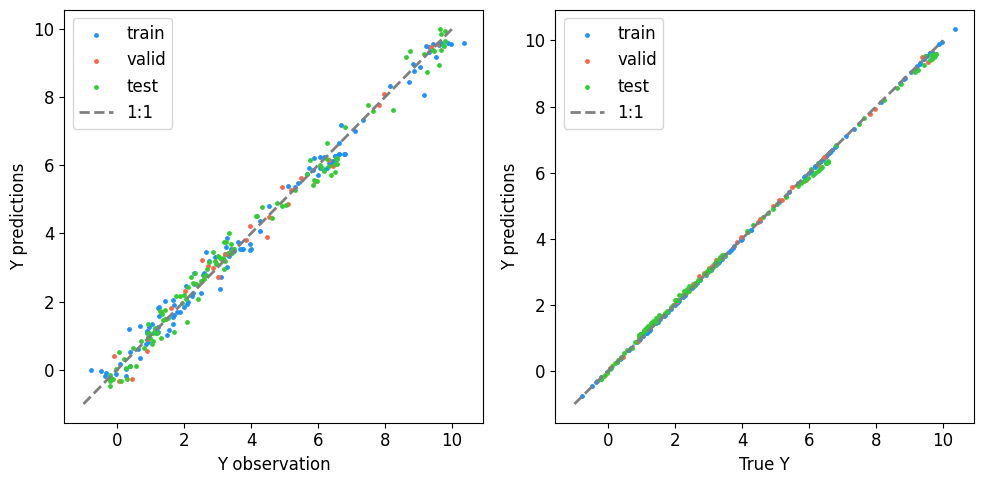



Setting up the dummy function and its latent function using nb_samples = 320 ...
Splitting 56.00000000000001% of 320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31606
Test RMSE of observed values: 0.32257
Train RMSE of observed true values: 0.31606
Test RMSE of observed true values: 0.07296
Train RMSE of observed values: 0.04284
Test RMSE of latent function: 0.03648
Plotting results ...


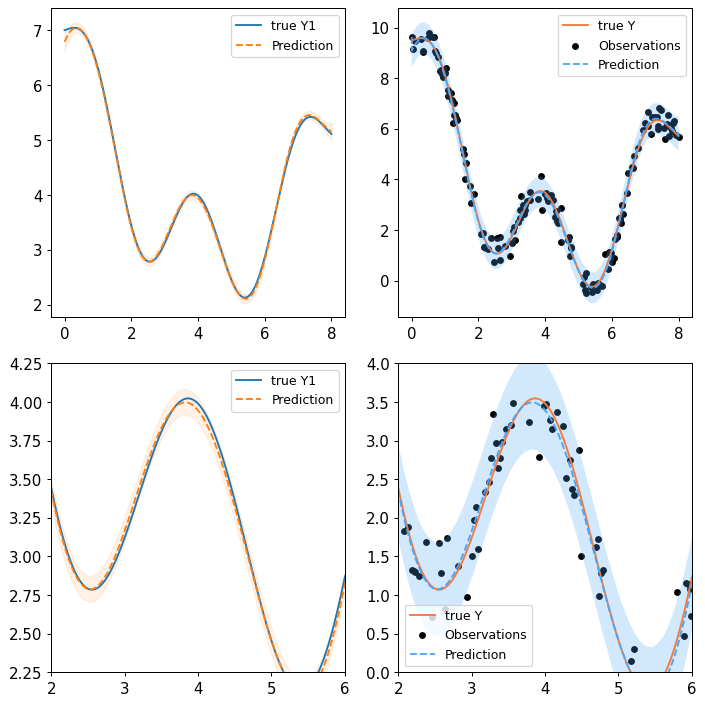

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


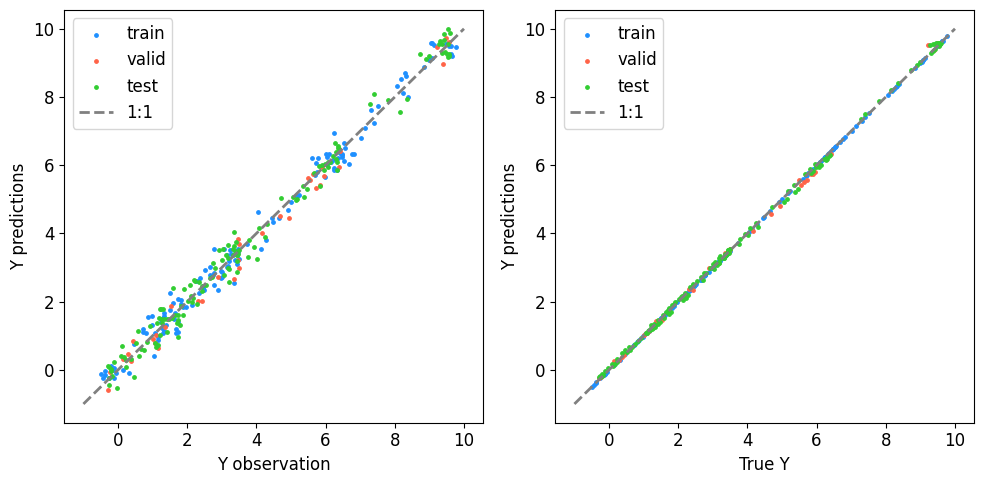



Setting up the dummy function and its latent function using nb_samples = 370 ...
Splitting 56.00000000000001% of 370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32699
Test RMSE of observed values: 0.32779
Train RMSE of observed true values: 0.32699
Test RMSE of observed true values: 0.07827
Train RMSE of observed values: 0.03571
Test RMSE of latent function: 0.03914
Plotting results ...


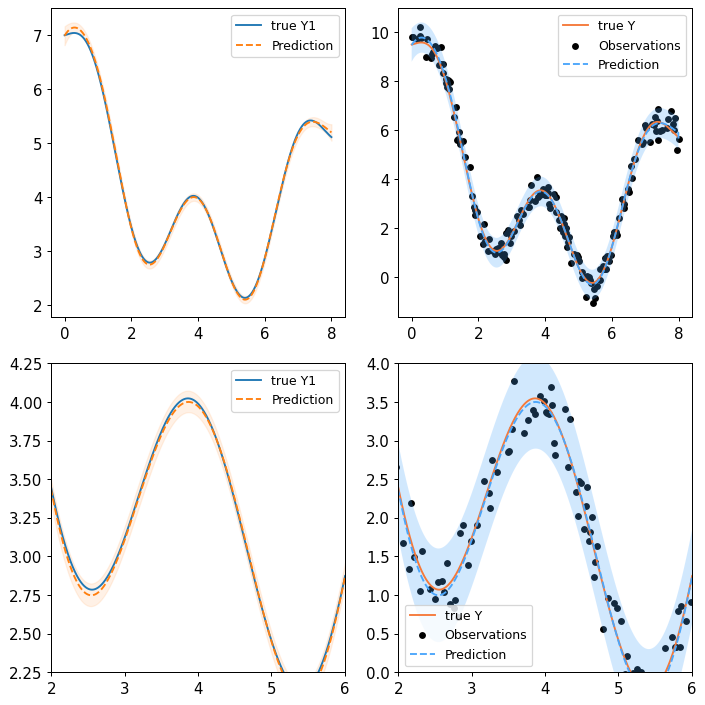

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


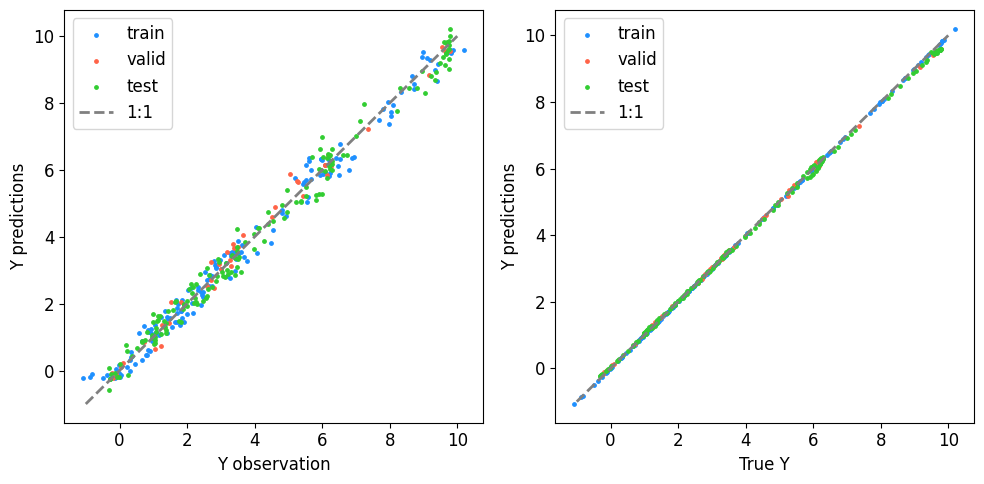



Setting up the dummy function and its latent function using nb_samples = 420 ...
Splitting 56.00000000000001% of 420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29908
Test RMSE of observed values: 0.30744
Train RMSE of observed true values: 0.29908
Test RMSE of observed true values: 0.06174
Train RMSE of observed values: 0.02797
Test RMSE of latent function: 0.03087
Plotting results ...


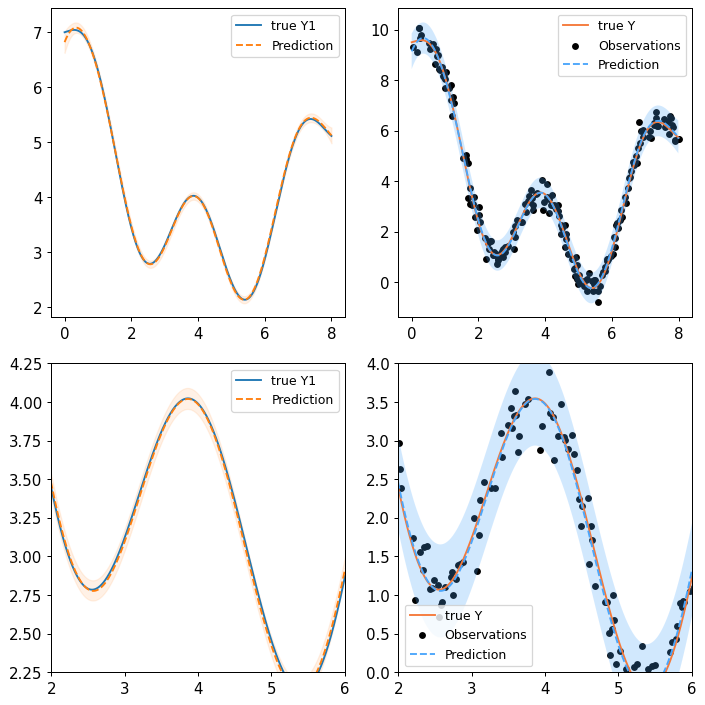

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


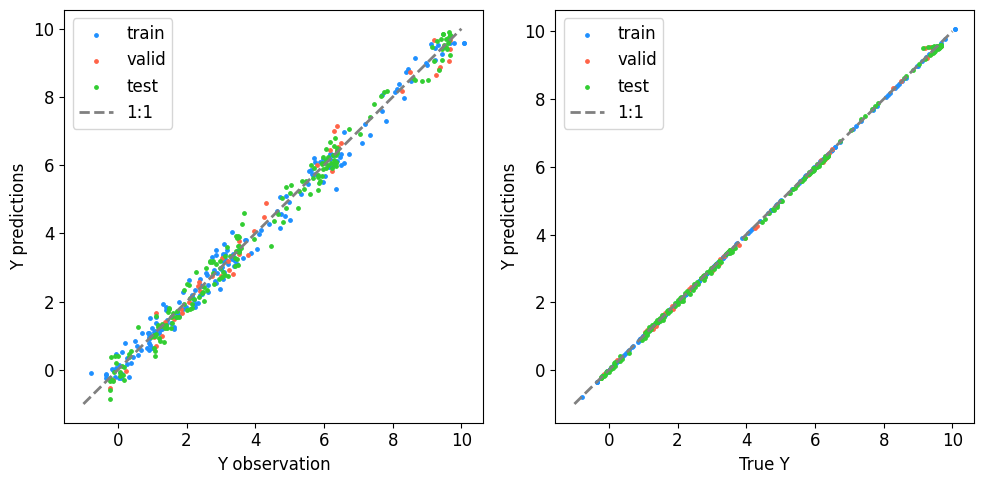



Setting up the dummy function and its latent function using nb_samples = 470 ...
Splitting 56.00000000000001% of 470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32359
Test RMSE of observed values: 0.31165
Train RMSE of observed true values: 0.32359
Test RMSE of observed true values: 0.08278
Train RMSE of observed values: 0.03700
Test RMSE of latent function: 0.04139
Plotting results ...


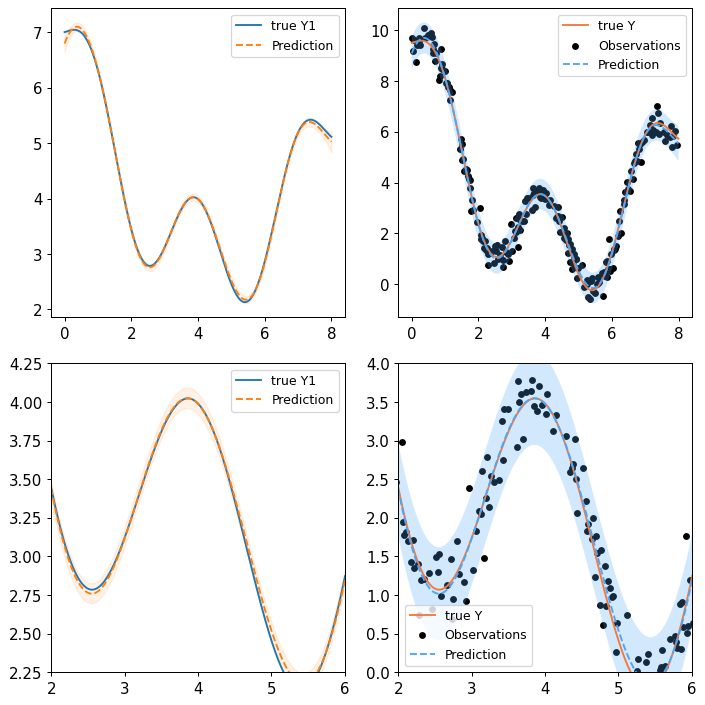

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


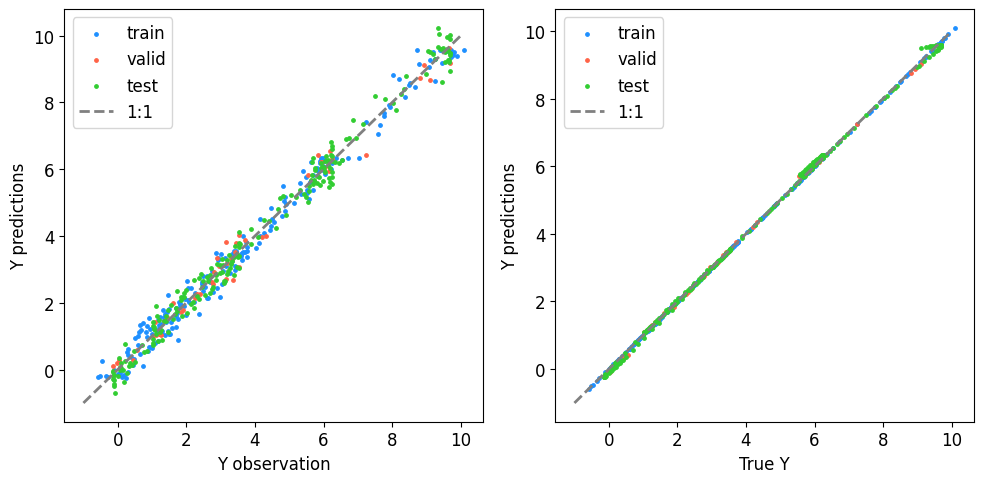



Setting up the dummy function and its latent function using nb_samples = 520 ...
Splitting 56.00000000000001% of 520 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27654
Test RMSE of observed values: 0.30607
Train RMSE of observed true values: 0.27654
Test RMSE of observed true values: 0.05647
Train RMSE of observed values: 0.02615
Test RMSE of latent function: 0.02823
Plotting results ...


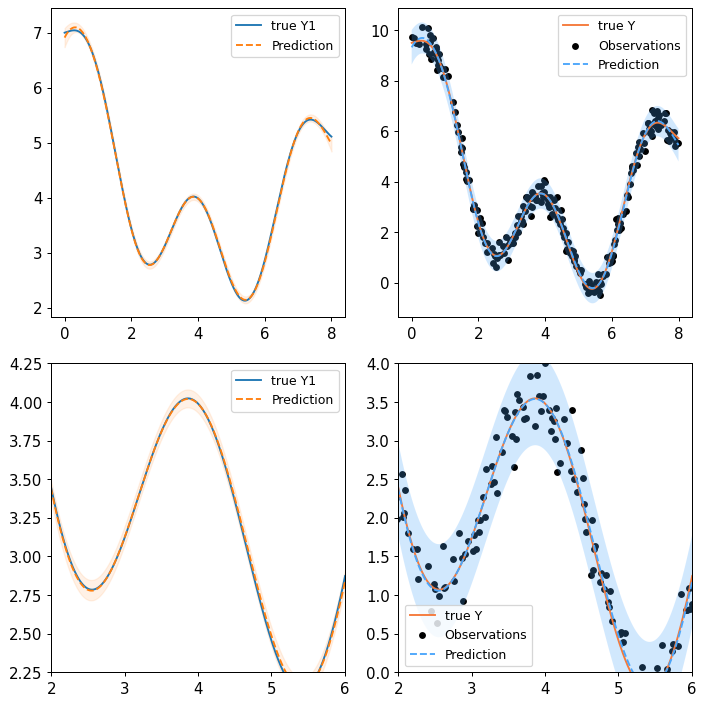

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


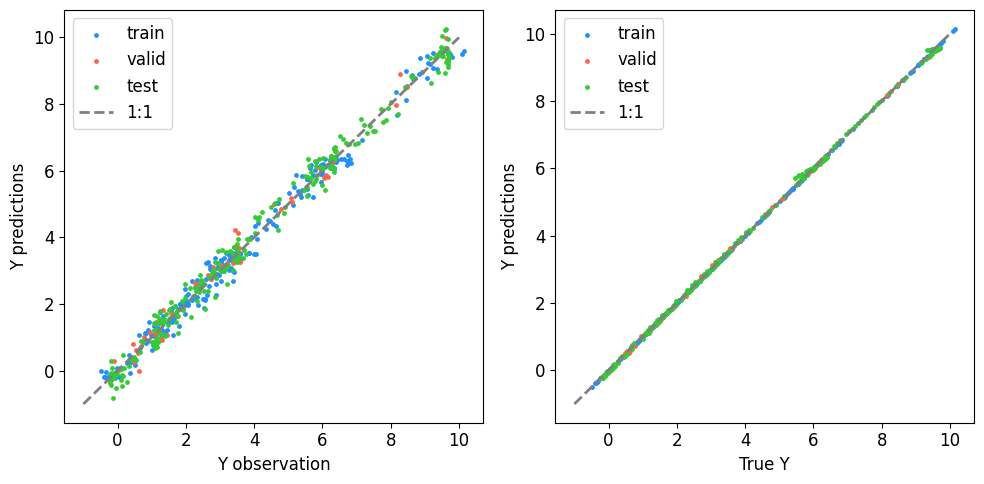



Setting up the dummy function and its latent function using nb_samples = 570 ...
Splitting 56.00000000000001% of 570 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30459
Test RMSE of observed values: 0.30197
Train RMSE of observed true values: 0.30459
Test RMSE of observed true values: 0.05436
Train RMSE of observed values: 0.02602
Test RMSE of latent function: 0.02718
Plotting results ...


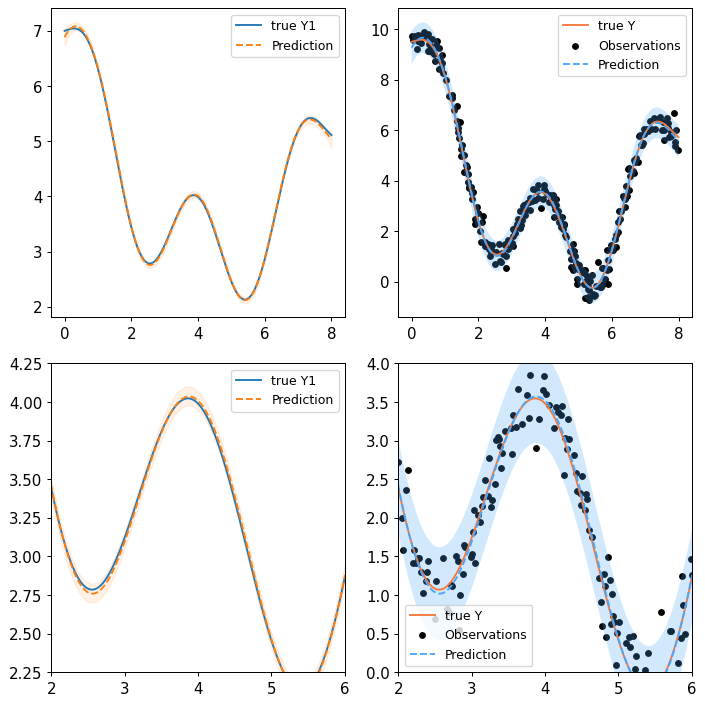

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


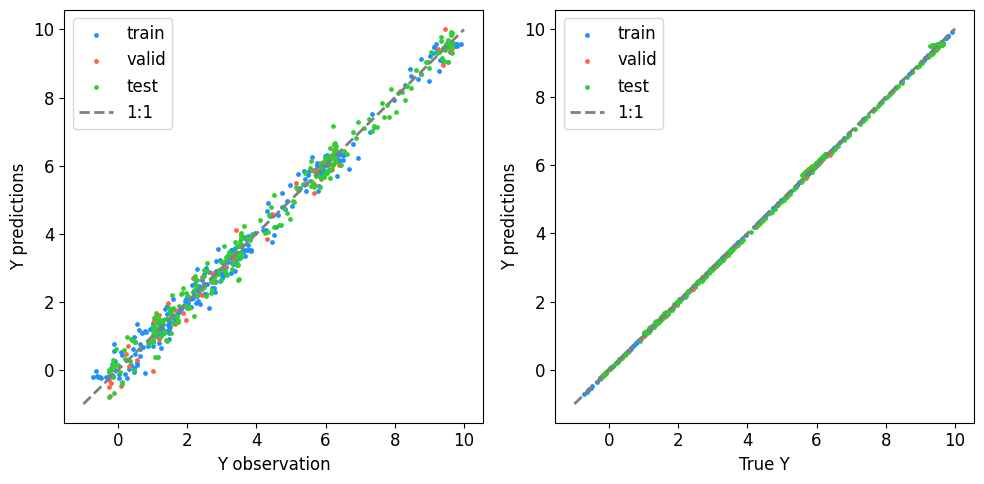



Setting up the dummy function and its latent function using nb_samples = 620 ...
Splitting 56.00000000000001% of 620 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29462
Test RMSE of observed values: 0.30975
Train RMSE of observed true values: 0.29462
Test RMSE of observed true values: 0.06606
Train RMSE of observed values: 0.03091
Test RMSE of latent function: 0.03303
Plotting results ...


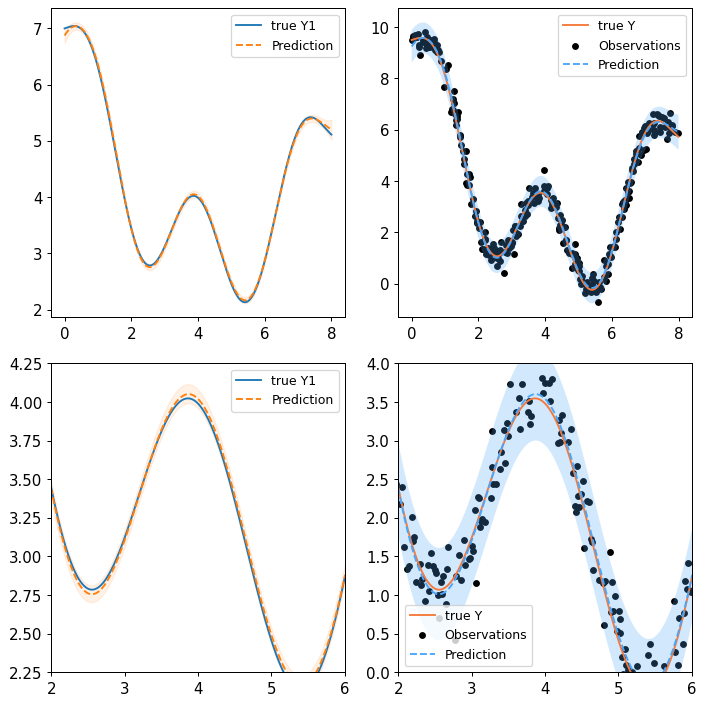

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


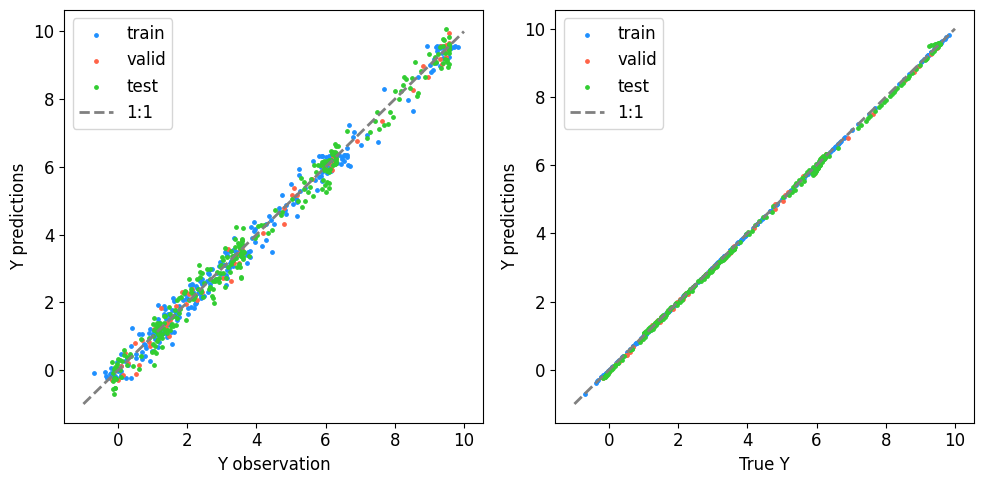



Setting up the dummy function and its latent function using nb_samples = 670 ...
Splitting 56.00000000000001% of 670 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31903
Test RMSE of observed values: 0.31594
Train RMSE of observed true values: 0.31903
Test RMSE of observed true values: 0.08773
Train RMSE of observed values: 0.03833
Test RMSE of latent function: 0.04386
Plotting results ...


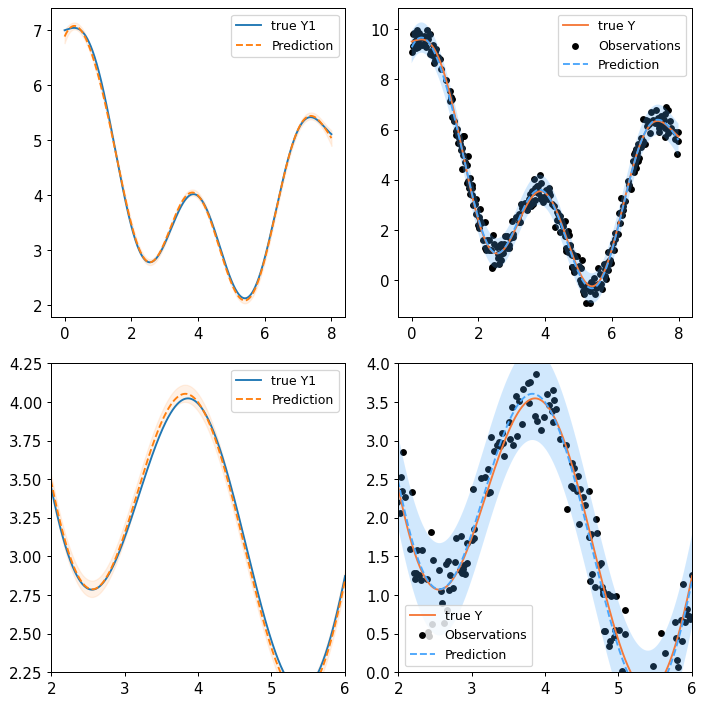

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


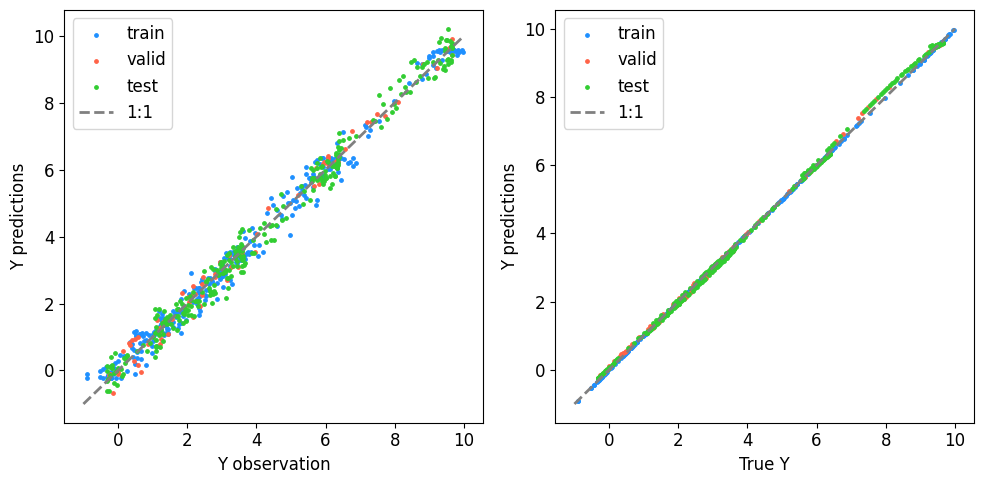



Setting up the dummy function and its latent function using nb_samples = 720 ...
Splitting 56.00000000000001% of 720 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30015
Test RMSE of observed values: 0.30764
Train RMSE of observed true values: 0.30015
Test RMSE of observed true values: 0.05016
Train RMSE of observed values: 0.02525
Test RMSE of latent function: 0.02508
Plotting results ...


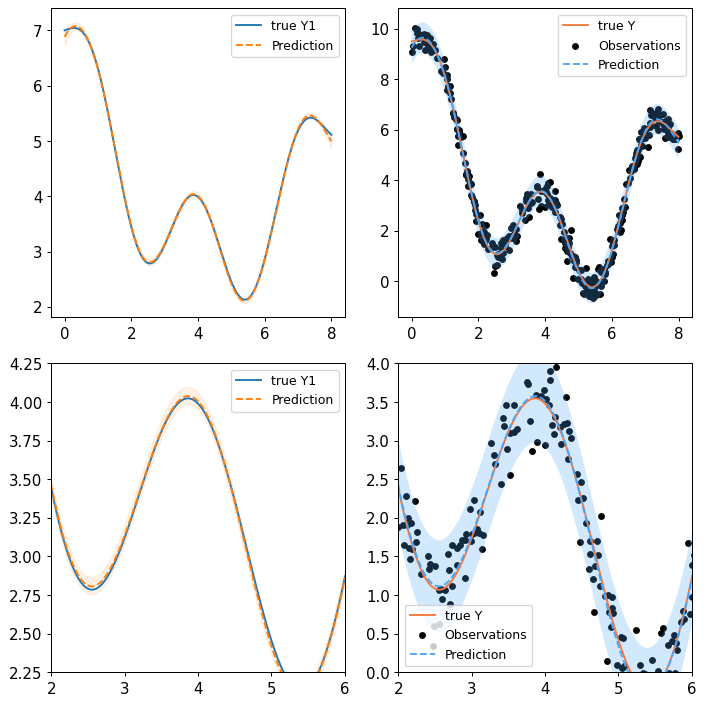

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


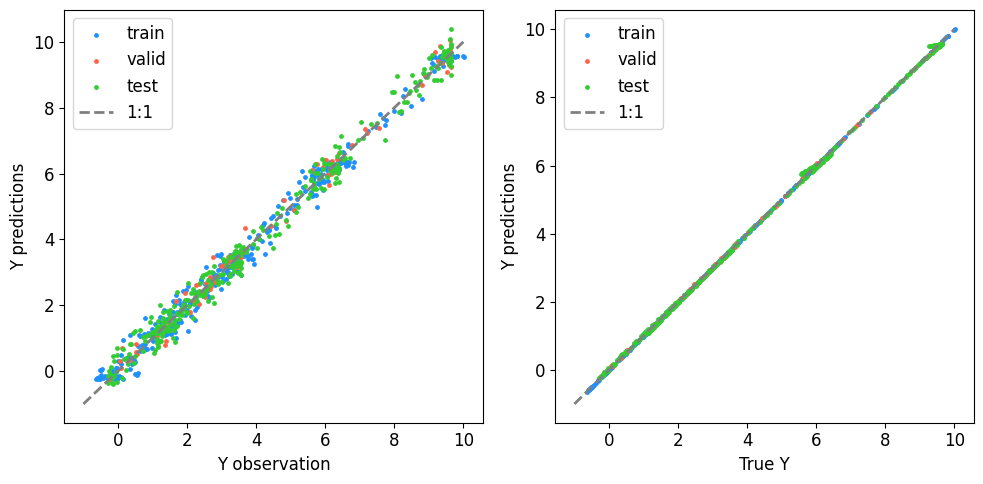



Setting up the dummy function and its latent function using nb_samples = 770 ...
Splitting 56.00000000000001% of 770 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29338
Test RMSE of observed values: 0.30856
Train RMSE of observed true values: 0.29338
Test RMSE of observed true values: 0.06073
Train RMSE of observed values: 0.03017
Test RMSE of latent function: 0.03036
Plotting results ...


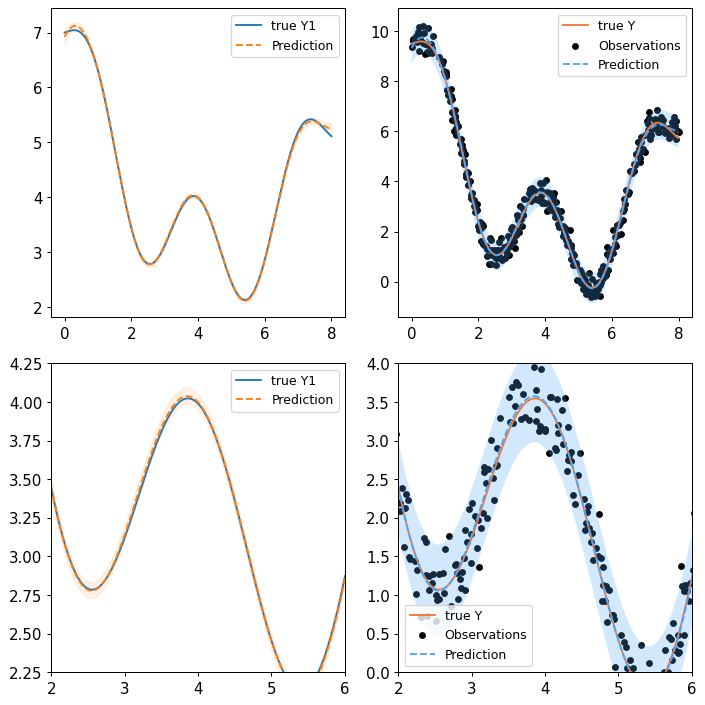

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


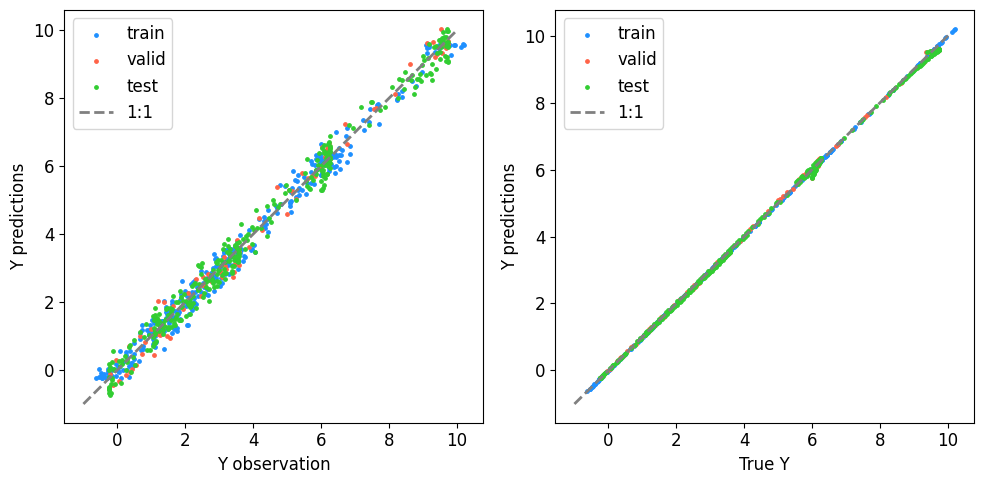



Setting up the dummy function and its latent function using nb_samples = 820 ...
Splitting 56.00000000000001% of 820 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29270
Test RMSE of observed values: 0.30873
Train RMSE of observed true values: 0.29270
Test RMSE of observed true values: 0.05034
Train RMSE of observed values: 0.02551
Test RMSE of latent function: 0.02517
Plotting results ...


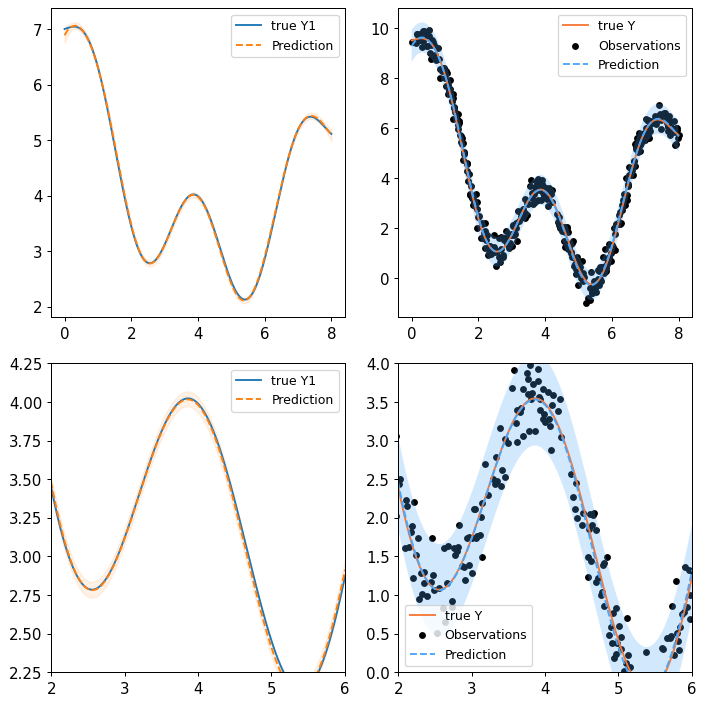

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


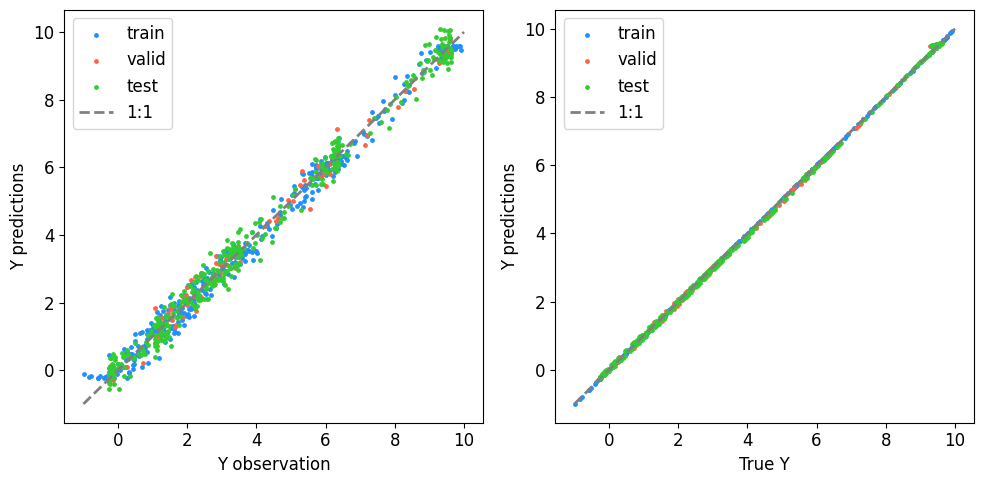



Setting up the dummy function and its latent function using nb_samples = 870 ...
Splitting 56.00000000000001% of 870 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30414
Test RMSE of observed values: 0.29918
Train RMSE of observed true values: 0.30414
Test RMSE of observed true values: 0.06725
Train RMSE of observed values: 0.03290
Test RMSE of latent function: 0.03362
Plotting results ...


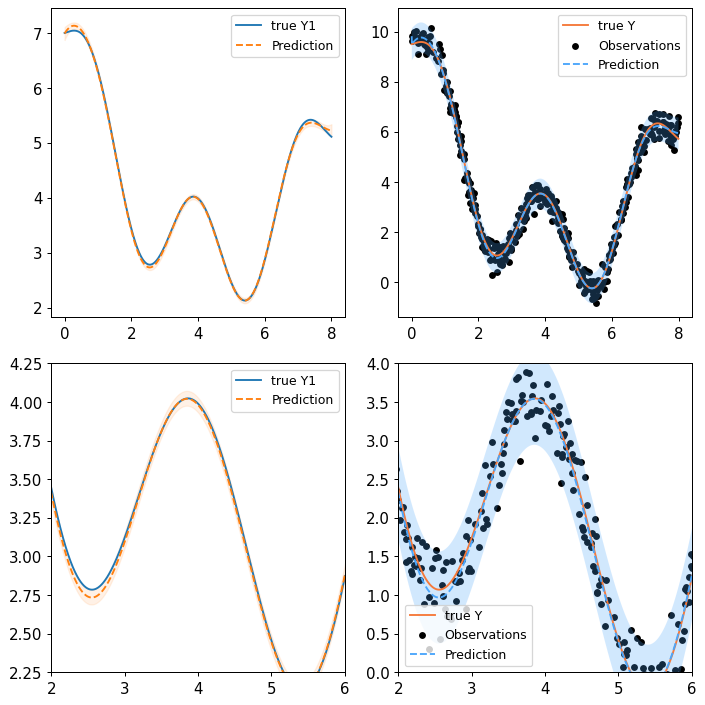

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


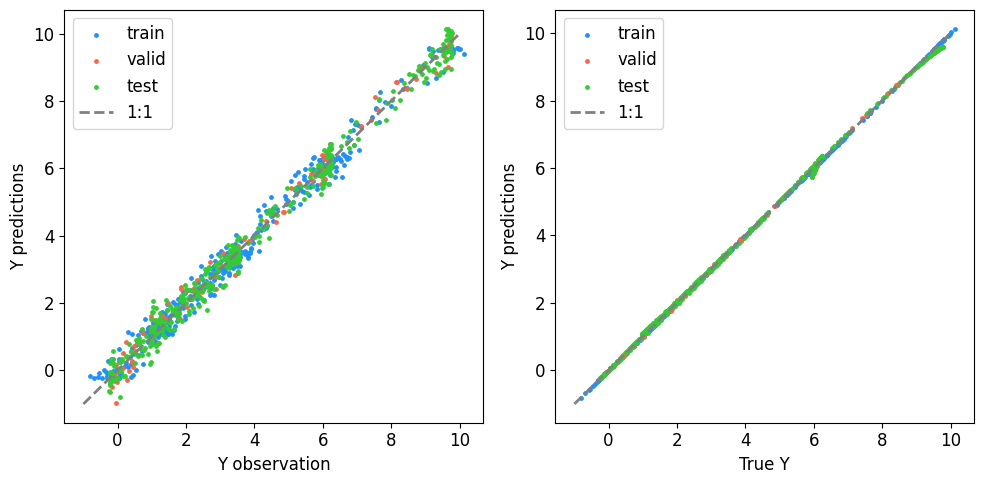



Setting up the dummy function and its latent function using nb_samples = 920 ...
Splitting 56.00000000000001% of 920 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31341
Test RMSE of observed values: 0.29514
Train RMSE of observed true values: 0.31341
Test RMSE of observed true values: 0.03344
Train RMSE of observed values: 0.01725
Test RMSE of latent function: 0.01672
Plotting results ...


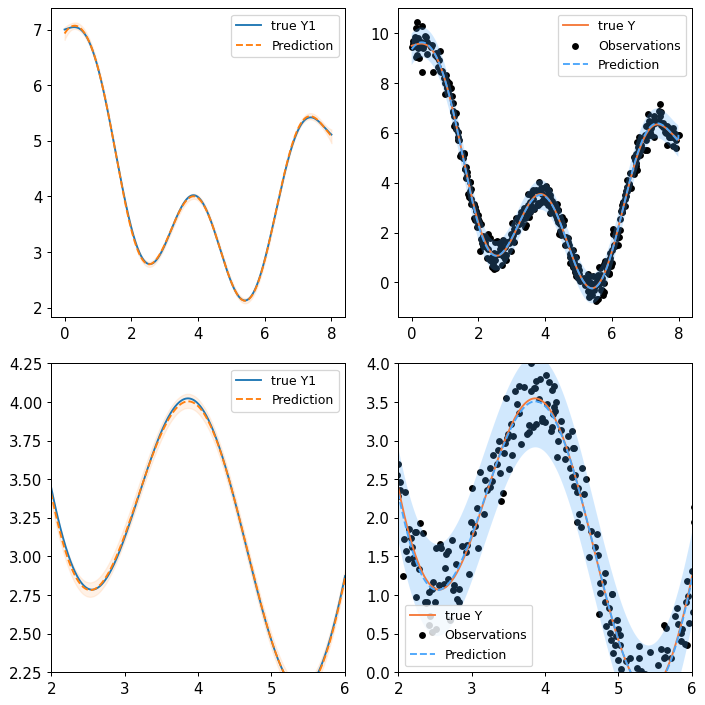

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


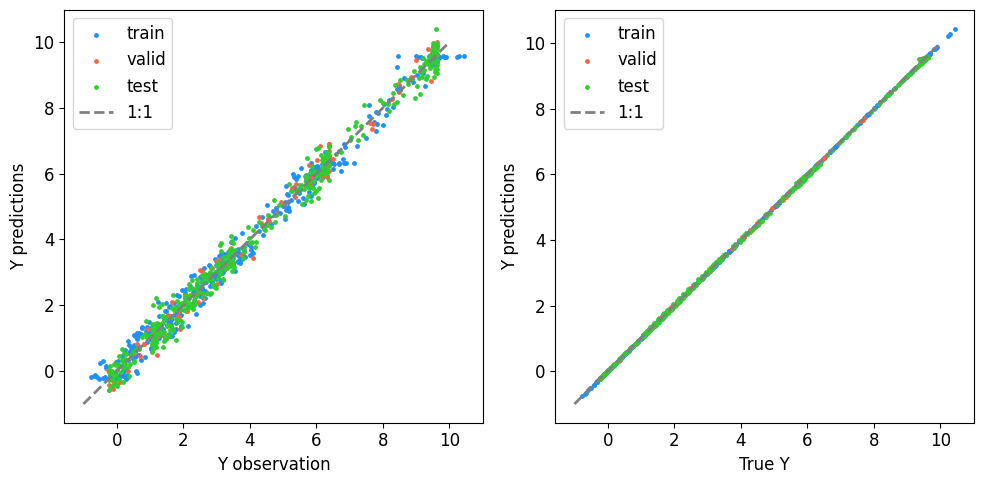



Setting up the dummy function and its latent function using nb_samples = 970 ...
Splitting 56.00000000000001% of 970 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28898
Test RMSE of observed values: 0.29346
Train RMSE of observed true values: 0.28898
Test RMSE of observed true values: 0.04584
Train RMSE of observed values: 0.02258
Test RMSE of latent function: 0.02292
Plotting results ...


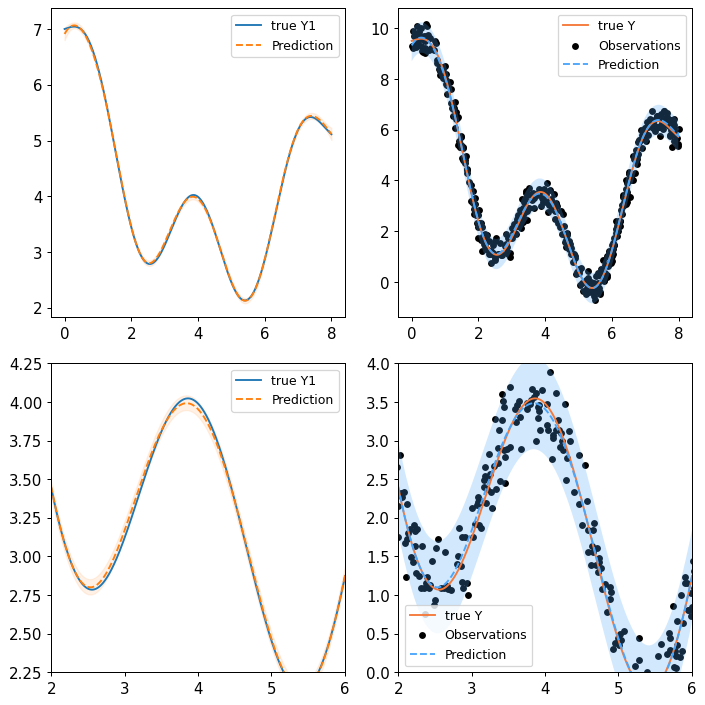

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


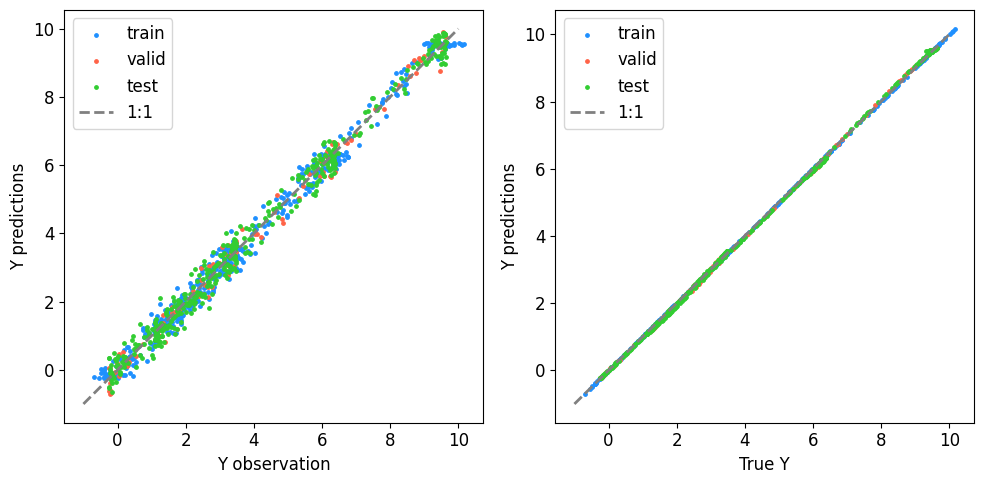



Setting up the dummy function and its latent function using nb_samples = 1020 ...
Splitting 56.00000000000001% of 1020 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30571
Test RMSE of observed values: 0.30484
Train RMSE of observed true values: 0.30571
Test RMSE of observed true values: 0.05577
Train RMSE of observed values: 0.02623
Test RMSE of latent function: 0.02789
Plotting results ...


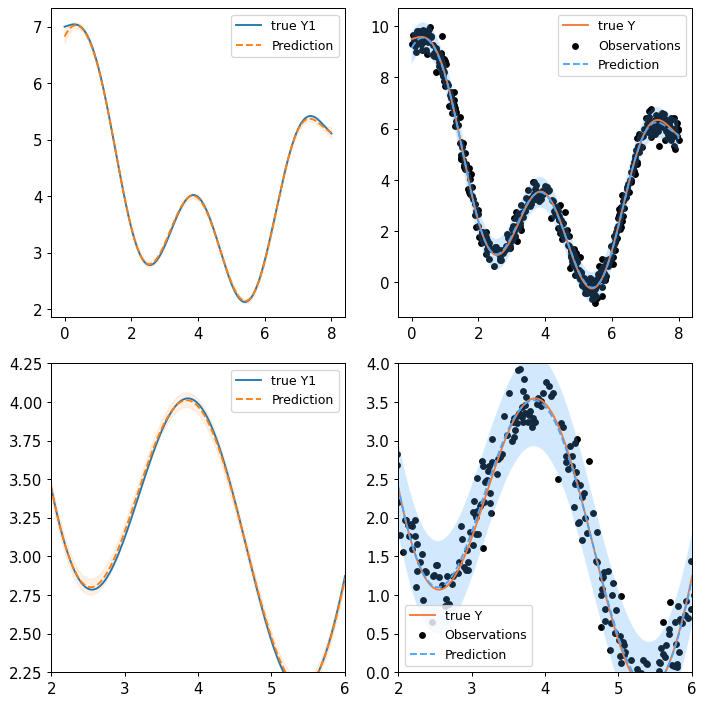

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


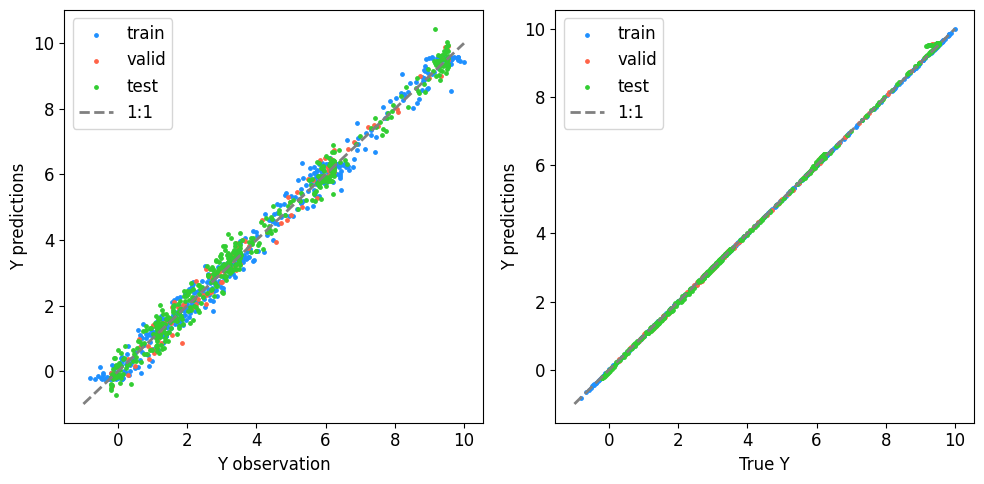



Setting up the dummy function and its latent function using nb_samples = 1070 ...
Splitting 56.00000000000001% of 1070 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30333
Test RMSE of observed values: 0.31915
Train RMSE of observed true values: 0.30333
Test RMSE of observed true values: 0.05084
Train RMSE of observed values: 0.02300
Test RMSE of latent function: 0.02542
Plotting results ...


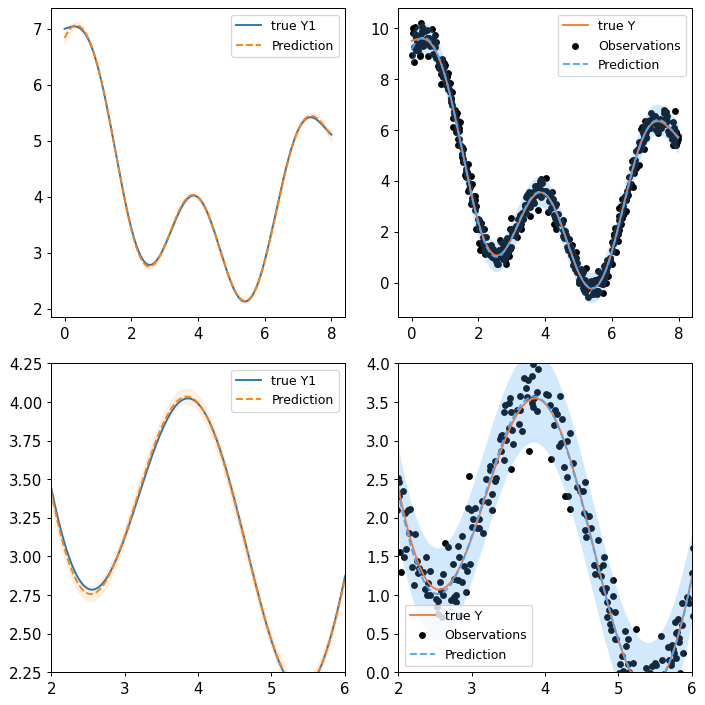

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


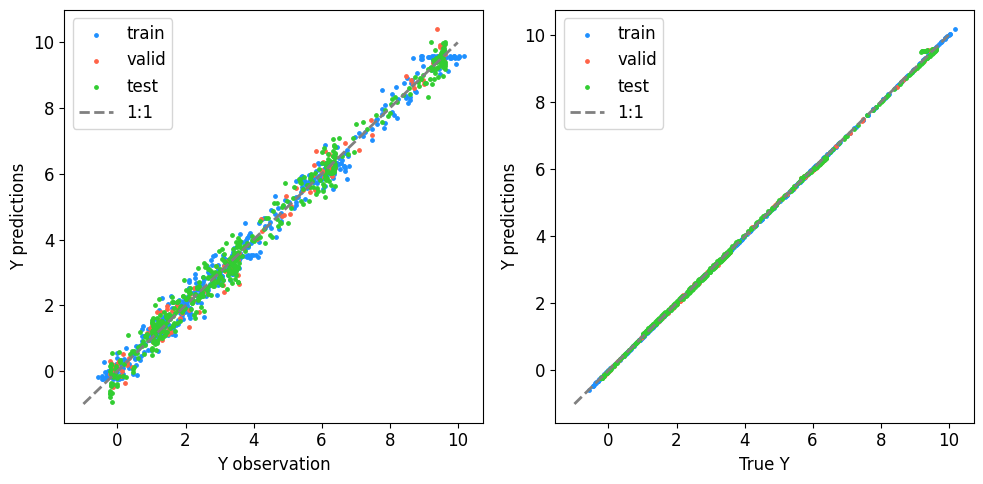



Setting up the dummy function and its latent function using nb_samples = 1120 ...
Splitting 56.00000000000001% of 1120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30018
Test RMSE of observed values: 0.30860
Train RMSE of observed true values: 0.30018
Test RMSE of observed true values: 0.04058
Train RMSE of observed values: 0.01854
Test RMSE of latent function: 0.02029
Plotting results ...


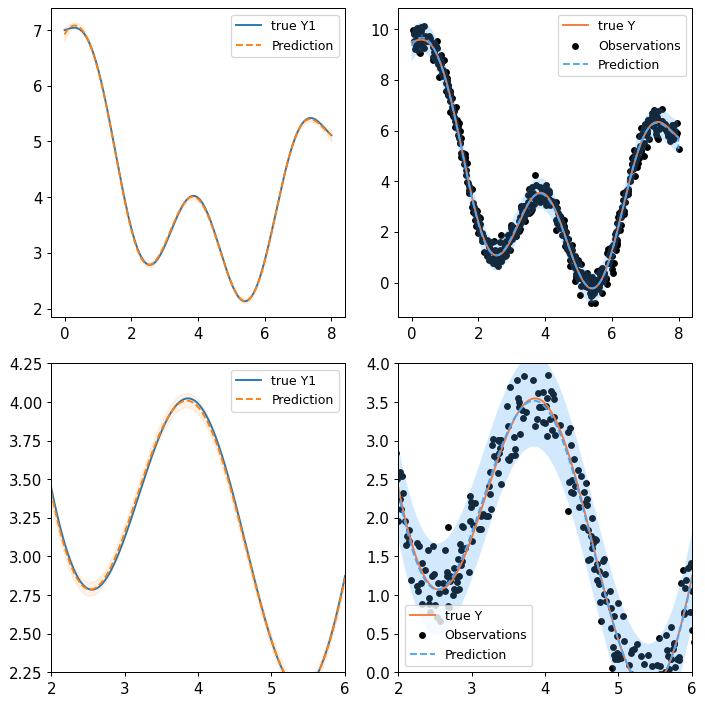

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


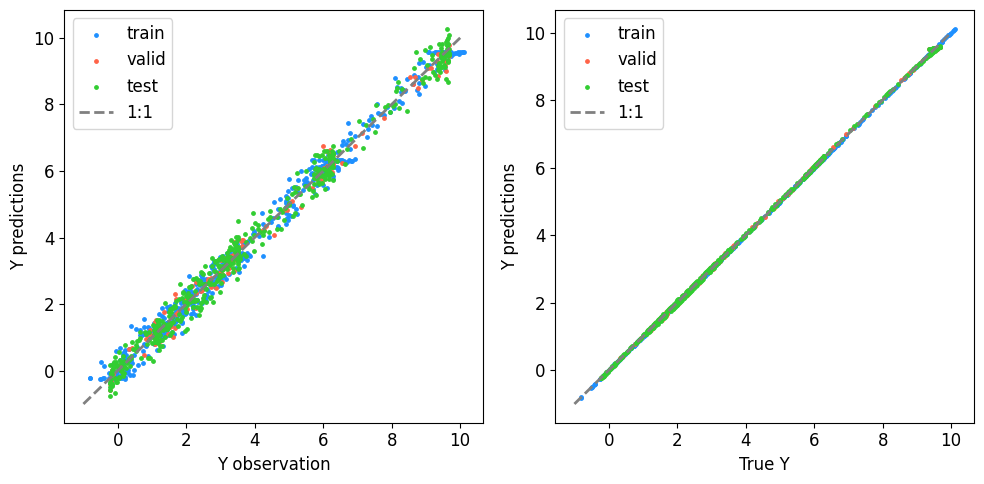



Setting up the dummy function and its latent function using nb_samples = 1170 ...
Splitting 56.00000000000001% of 1170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31439
Test RMSE of observed values: 0.30091
Train RMSE of observed true values: 0.31439
Test RMSE of observed true values: 0.05466
Train RMSE of observed values: 0.02991
Test RMSE of latent function: 0.02733
Plotting results ...


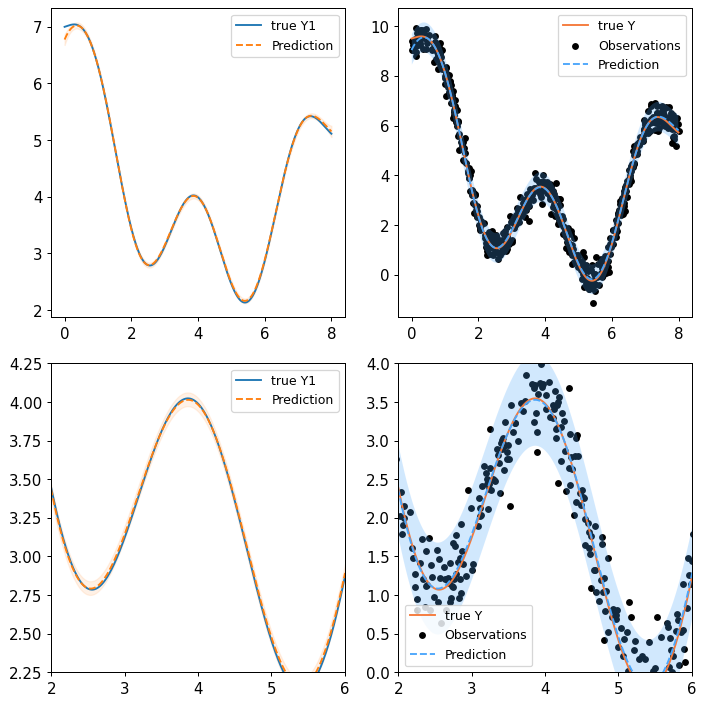

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


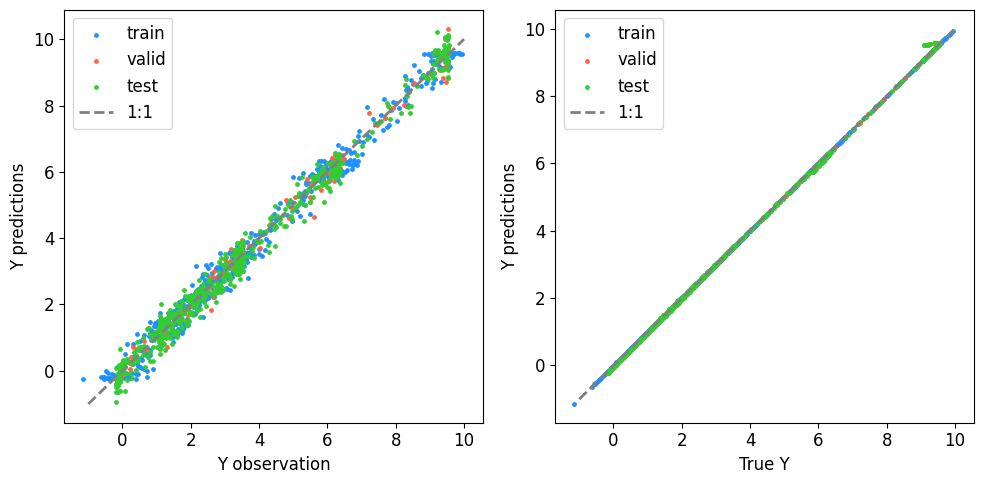



Setting up the dummy function and its latent function using nb_samples = 1220 ...
Splitting 56.00000000000001% of 1220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29366
Test RMSE of observed values: 0.29655
Train RMSE of observed true values: 0.29366
Test RMSE of observed true values: 0.04881
Train RMSE of observed values: 0.02387
Test RMSE of latent function: 0.02441
Plotting results ...


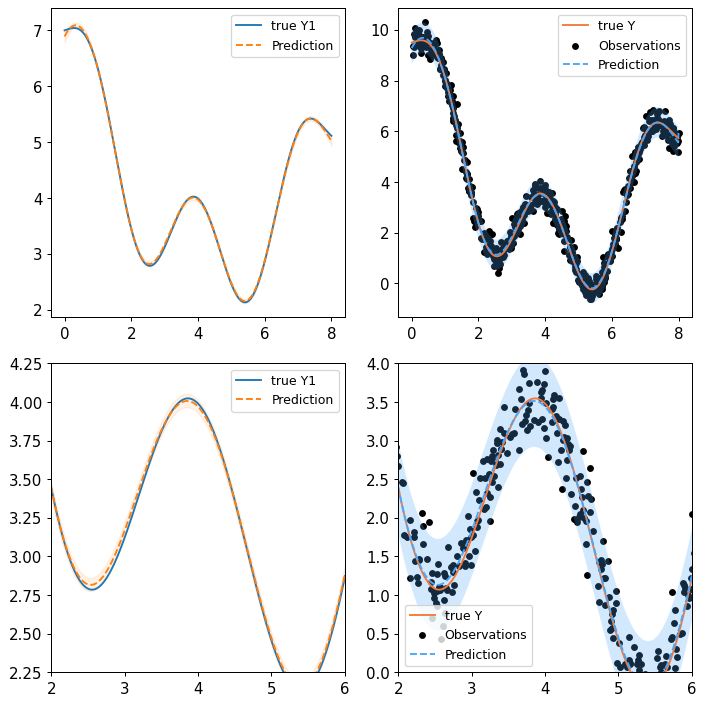

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


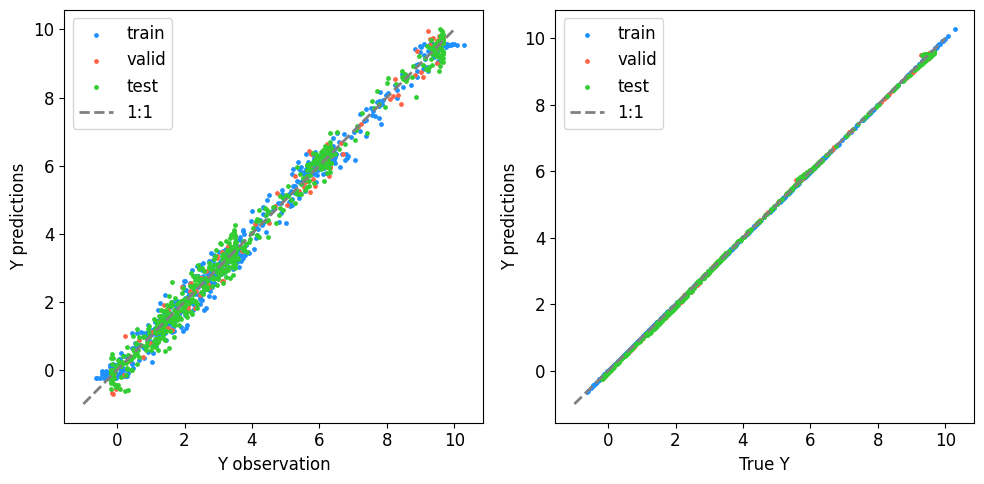



Setting up the dummy function and its latent function using nb_samples = 1270 ...
Splitting 56.00000000000001% of 1270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32237
Test RMSE of observed values: 0.29387
Train RMSE of observed true values: 0.32237
Test RMSE of observed true values: 0.04790
Train RMSE of observed values: 0.02422
Test RMSE of latent function: 0.02395
Plotting results ...


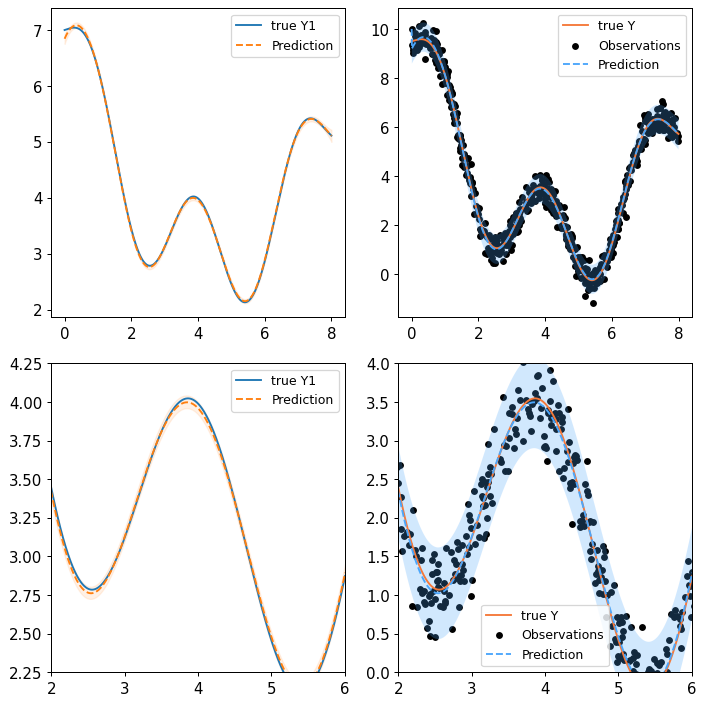

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


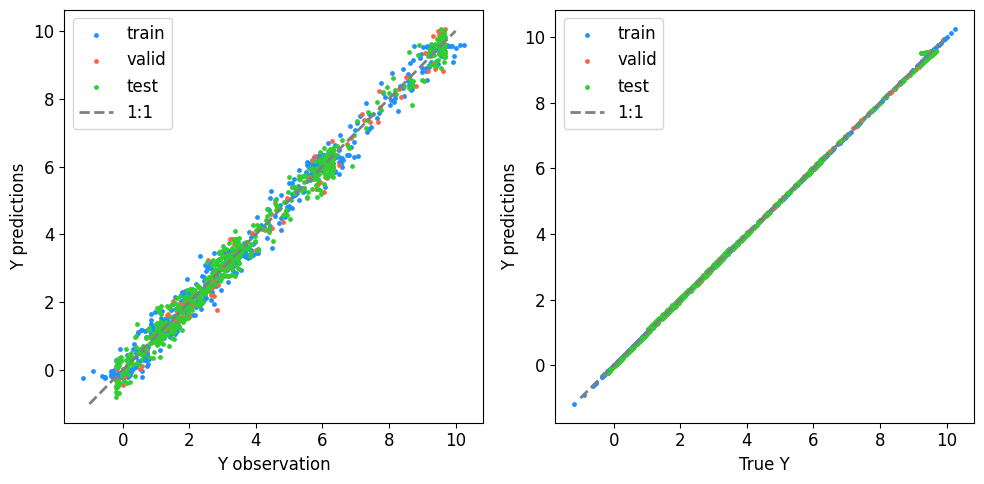



Setting up the dummy function and its latent function using nb_samples = 1320 ...
Splitting 56.00000000000001% of 1320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29321
Test RMSE of observed values: 0.29295
Train RMSE of observed true values: 0.29321
Test RMSE of observed true values: 0.03451
Train RMSE of observed values: 0.01849
Test RMSE of latent function: 0.01725
Plotting results ...


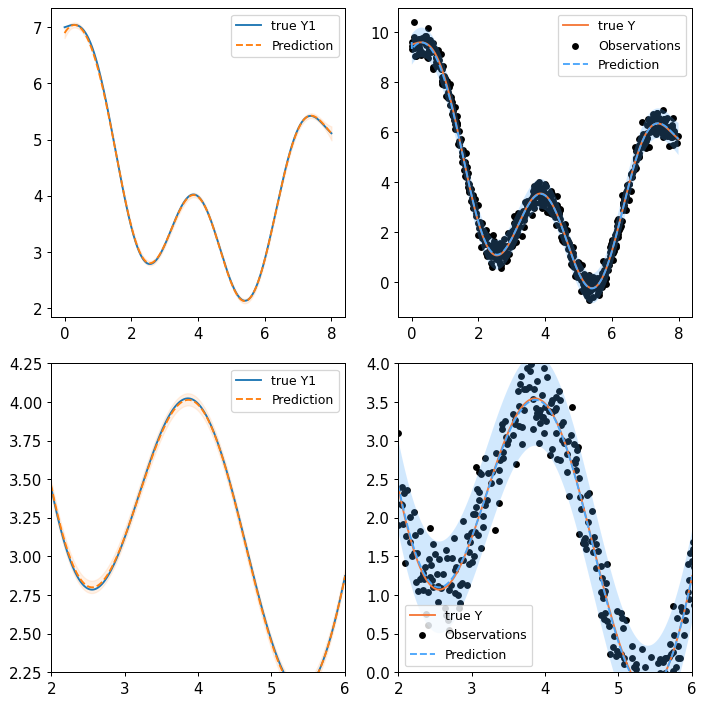

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


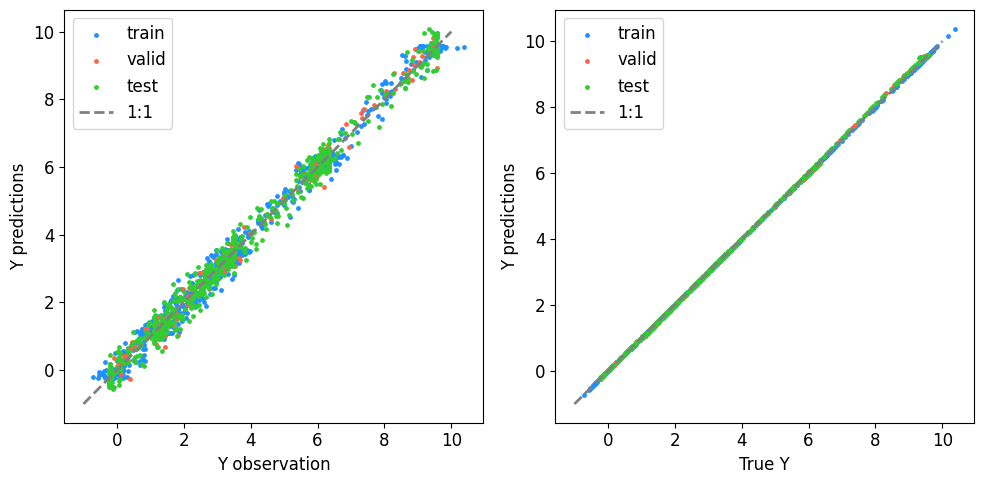



Setting up the dummy function and its latent function using nb_samples = 1370 ...
Splitting 56.00000000000001% of 1370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30845
Test RMSE of observed values: 0.30052
Train RMSE of observed true values: 0.30845
Test RMSE of observed true values: 0.05077
Train RMSE of observed values: 0.02547
Test RMSE of latent function: 0.02539
Plotting results ...


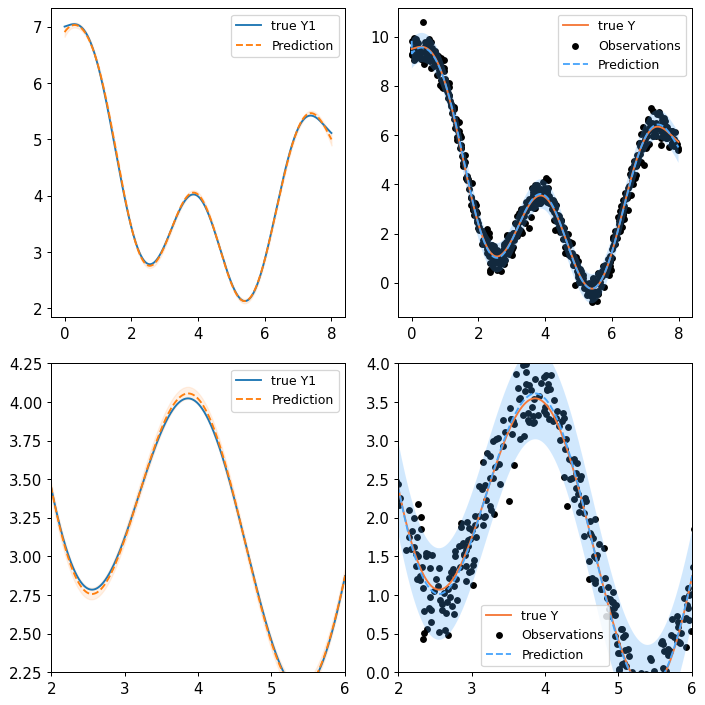

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


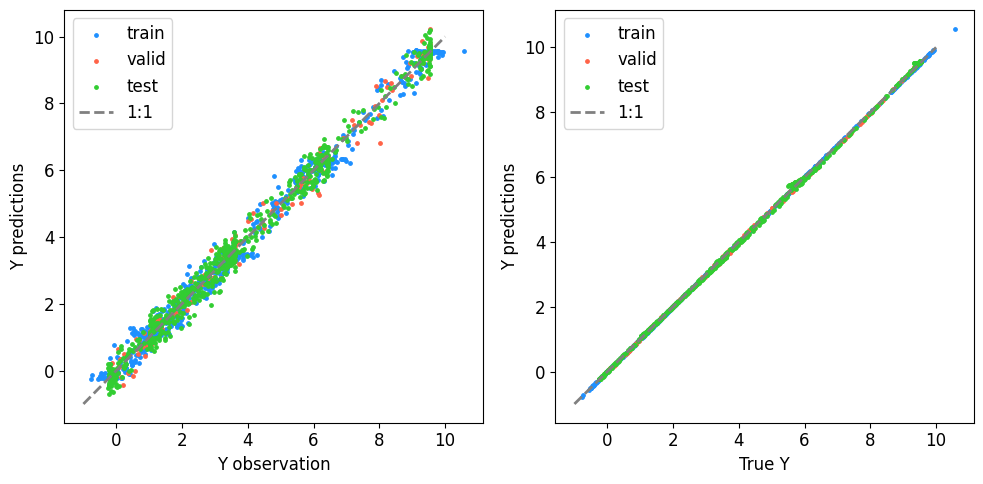



Setting up the dummy function and its latent function using nb_samples = 1420 ...
Splitting 56.00000000000001% of 1420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29500
Test RMSE of observed values: 0.28917
Train RMSE of observed true values: 0.29500
Test RMSE of observed true values: 0.03579
Train RMSE of observed values: 0.01822
Test RMSE of latent function: 0.01790
Plotting results ...


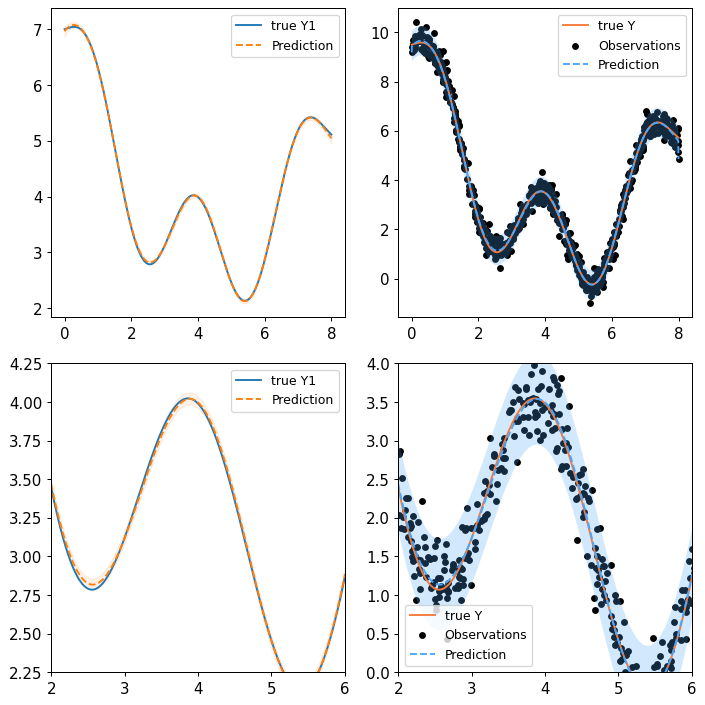

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


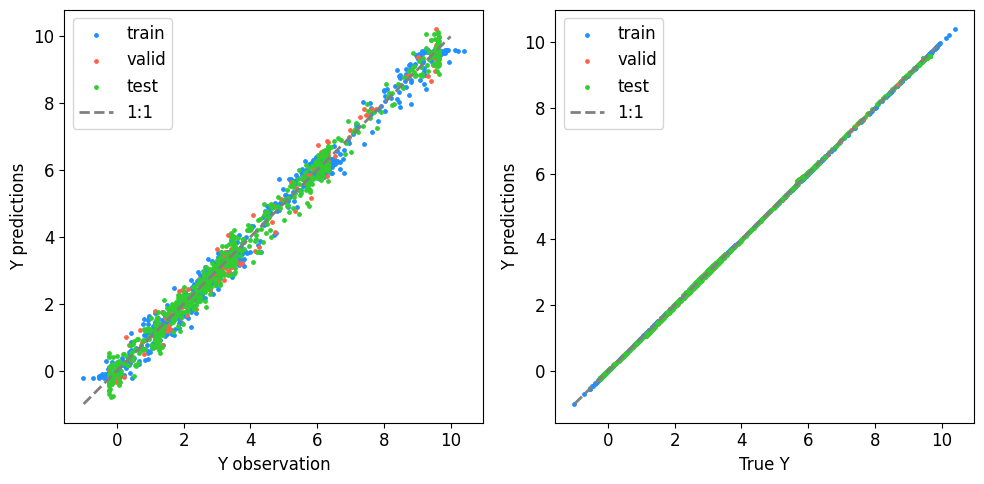



Setting up the dummy function and its latent function using nb_samples = 1470 ...
Splitting 56.00000000000001% of 1470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30518
Test RMSE of observed values: 0.31124
Train RMSE of observed true values: 0.30518
Test RMSE of observed true values: 0.05103
Train RMSE of observed values: 0.02475
Test RMSE of latent function: 0.02552
Plotting results ...


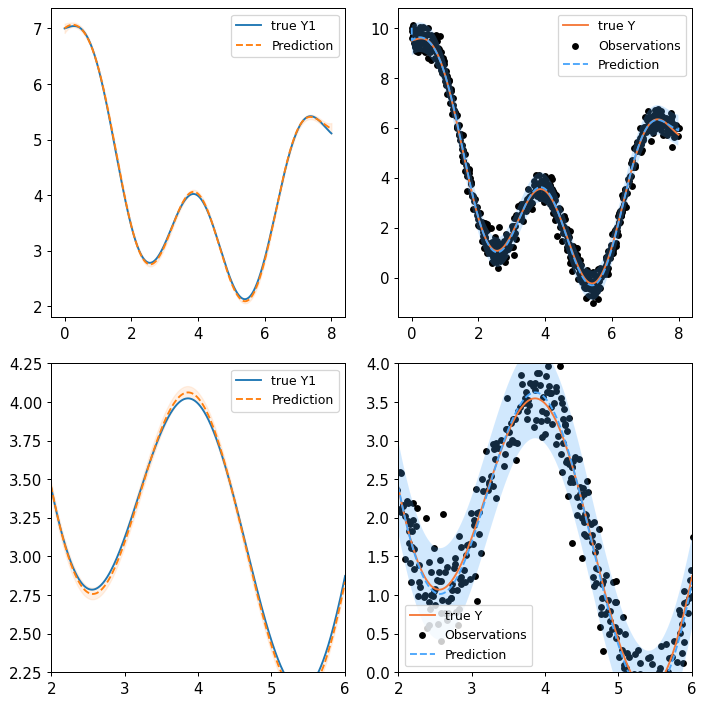

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


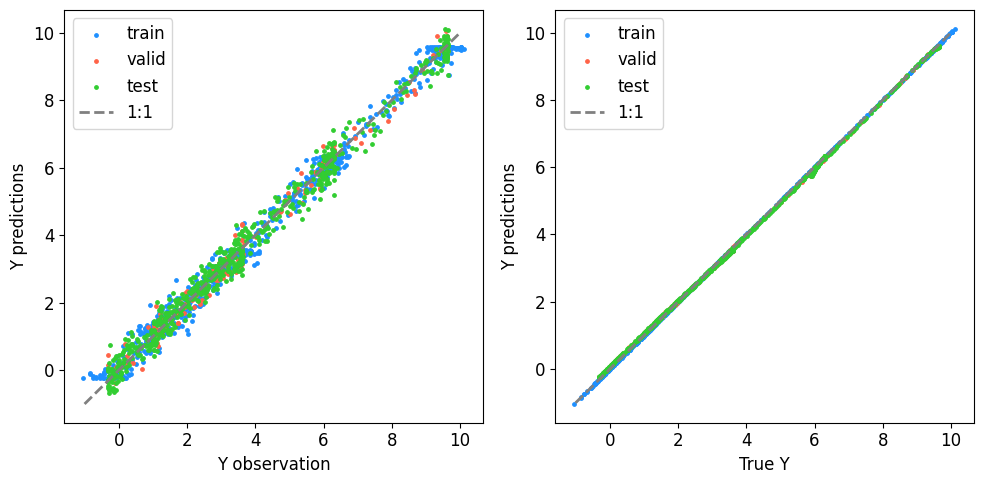



Setting up the dummy function and its latent function using nb_samples = 1520 ...
Splitting 56.00000000000001% of 1520 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30270
Test RMSE of observed values: 0.30002
Train RMSE of observed true values: 0.30270
Test RMSE of observed true values: 0.04170
Train RMSE of observed values: 0.02073
Test RMSE of latent function: 0.02085
Plotting results ...


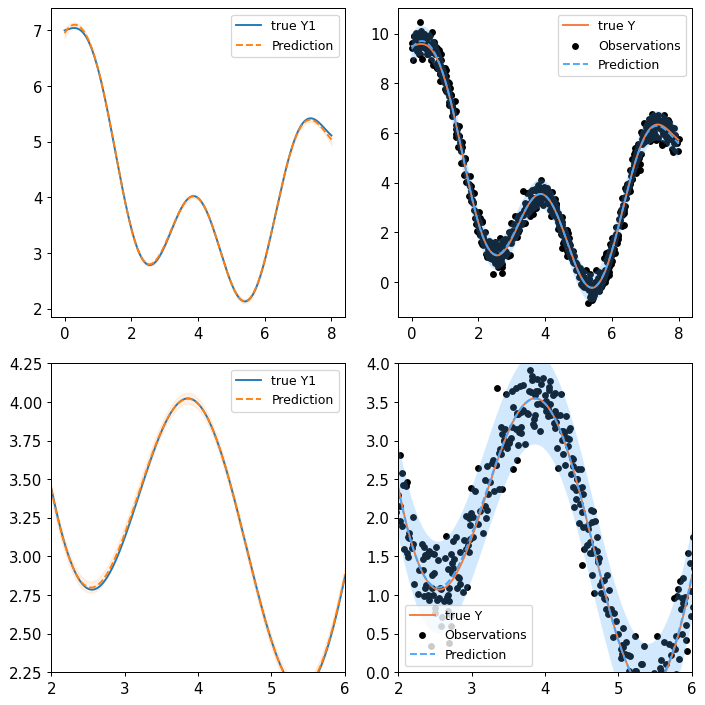

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


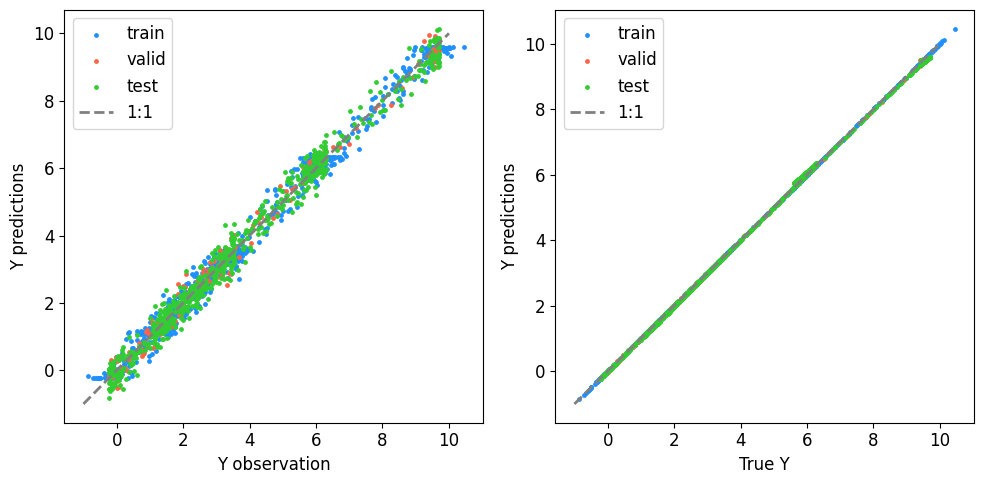

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_squared_error

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    u_scale2: Positive = 1,
    noise: Positive = 0.1,
    
):
    with Measure():
        f = u_var*GP(EQ()) + u_var2*GP(Linear()) # Construct Gaussian process.
        f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f

    return f, f2, noise

def y1(x):
    return np.sin(x*2.)+ 0.2*x+2. +0.2*(x-5)**2

def y2(x):
    return -4.5+2*y1(x)

plot = True
scale =  False
optimize = False
train_size = 0.56

nb_samples = np.arange(20,1570,50)

rms = []
for nb_sample in nb_samples:
    
    x_obs = B.linspace(0.,8.,nb_sample)
    x_model = B.linspace(0.,8.,int(max(nb_samples)-0.1*max(nb_samples)))
    
    rms_test, rms_valid, rms_train = gp_dummy_compute_plot(train_size, nb_sample, x_obs, x_model, y1, y2, plot, scale, optimize)
    rms.append([rms_test, rms_valid, rms_train])
    

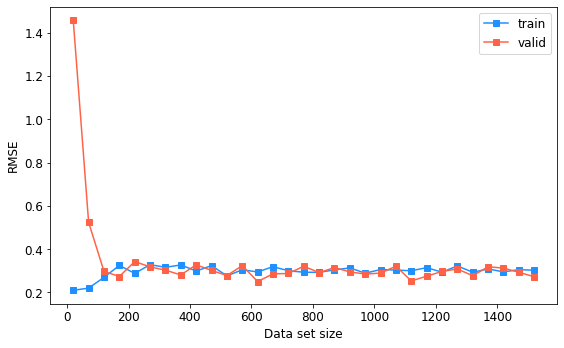

In [16]:
rms_test = [rms[i][0] for i in range(len(rms))]
rms_valid = [rms[i][1] for i in range(len(rms))]
rms_train = [rms[i][2] for i in range(len(rms))]
# print(rms_train)

plt.figure(figsize=(8,5))
# plt.style.use('seaborn-whitegrid') # nice and clean grid
# plt.plot(train_sizes,rms1_test,'-o',label='Training')

c1 = 'dodgerblue'
c2 = 'tomato'
c3 = 'limegreen'

plt.plot(nb_samples,rms_train,'s-',color=c1, label='train')
plt.plot(nb_samples,rms_valid,'s-',color=c2, label='valid')
# plt.plot(nb_samples,rms_test,'o-',color=c2, label='test')

plt.xlabel('Data set size')
plt.ylabel('RMSE')
plt.legend()
# plt.ylim(0,1)
plt.show()

Using exp kernel in addition



Setting up the dummy function and its latent function using nb_samples = 20 ...
Splitting 56.00000000000001% of 20 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.10658
Test RMSE of observed values: 2.27271
Train RMSE of observed true values: 0.10658
Test RMSE of observed true values: 2.17380
Train RMSE of observed values: 0.07882
Test RMSE of latent function: 1.08690
Plotting results ...


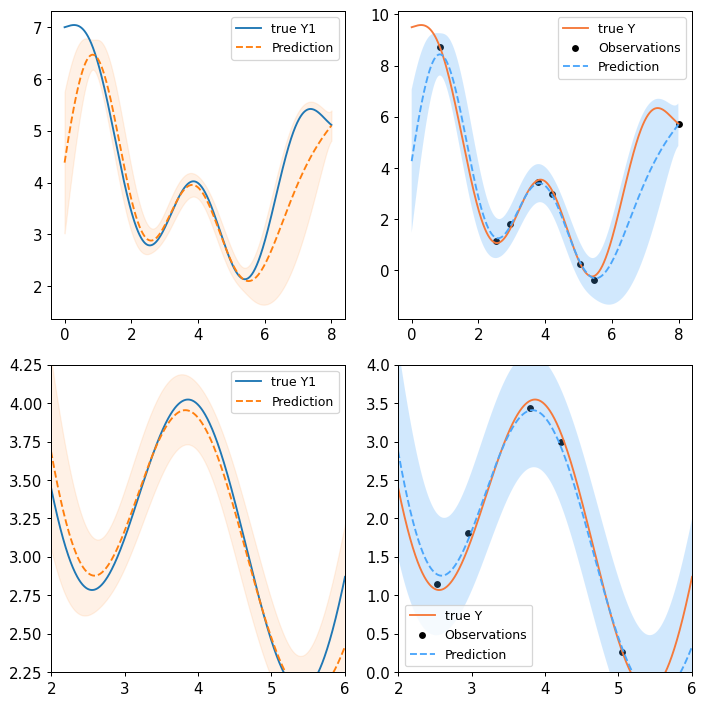

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


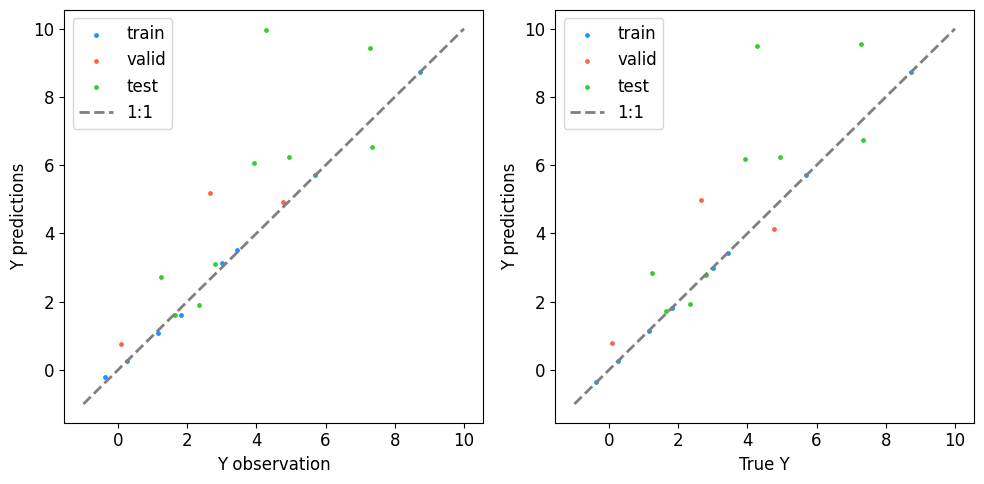



Setting up the dummy function and its latent function using nb_samples = 70 ...
Splitting 56.00000000000001% of 70 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.24197
Test RMSE of observed values: 0.40361
Train RMSE of observed true values: 0.24197
Test RMSE of observed true values: 0.31819
Train RMSE of observed values: 0.08132
Test RMSE of latent function: 0.15909
Plotting results ...


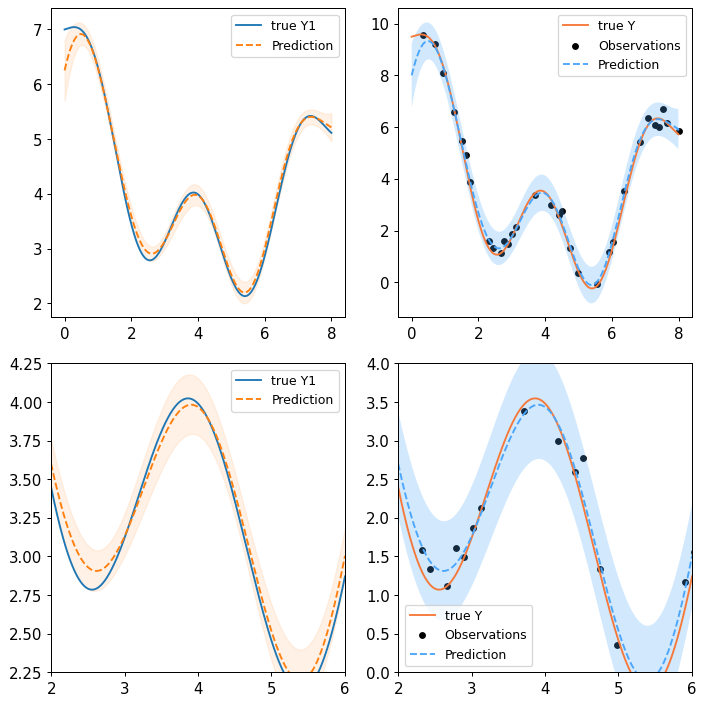

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


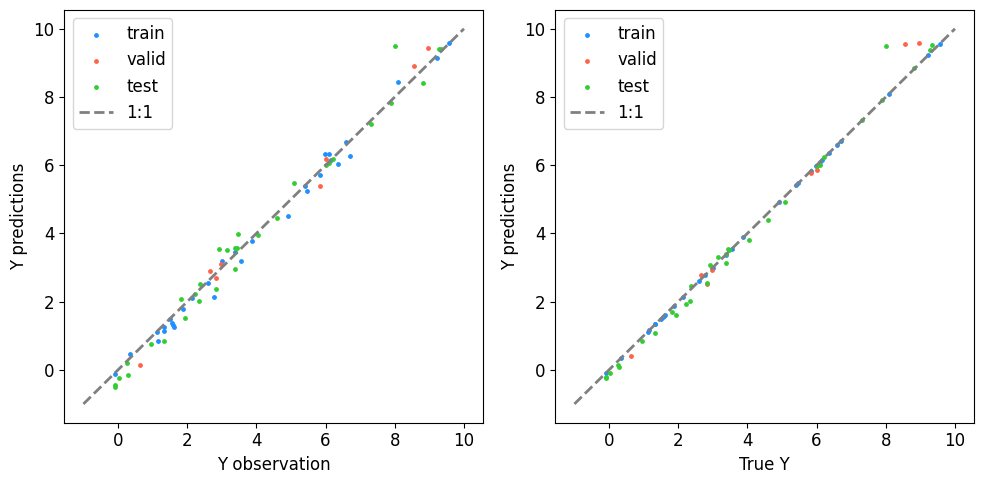



Setting up the dummy function and its latent function using nb_samples = 120 ...
Splitting 56.00000000000001% of 120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.25987
Test RMSE of observed values: 0.30199
Train RMSE of observed true values: 0.25987
Test RMSE of observed true values: 0.15769
Train RMSE of observed values: 0.06599
Test RMSE of latent function: 0.07884
Plotting results ...


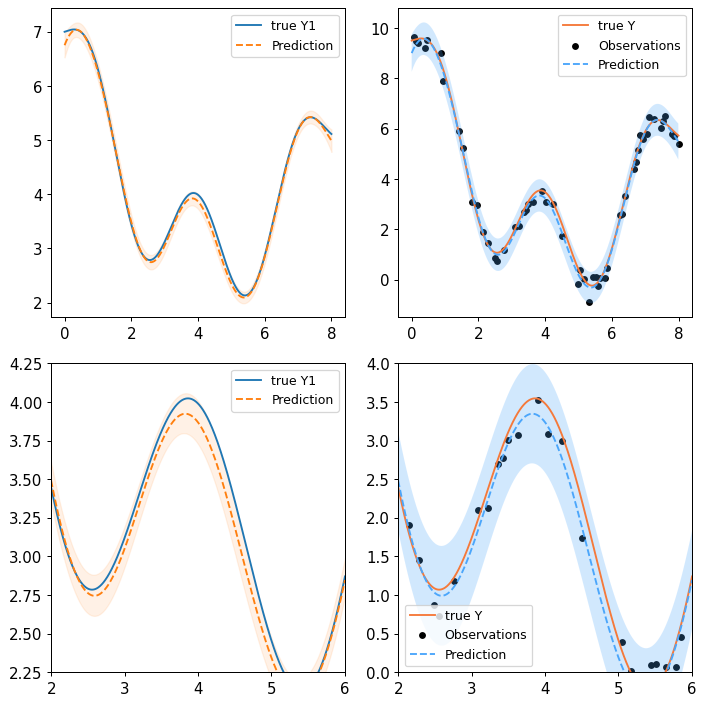

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


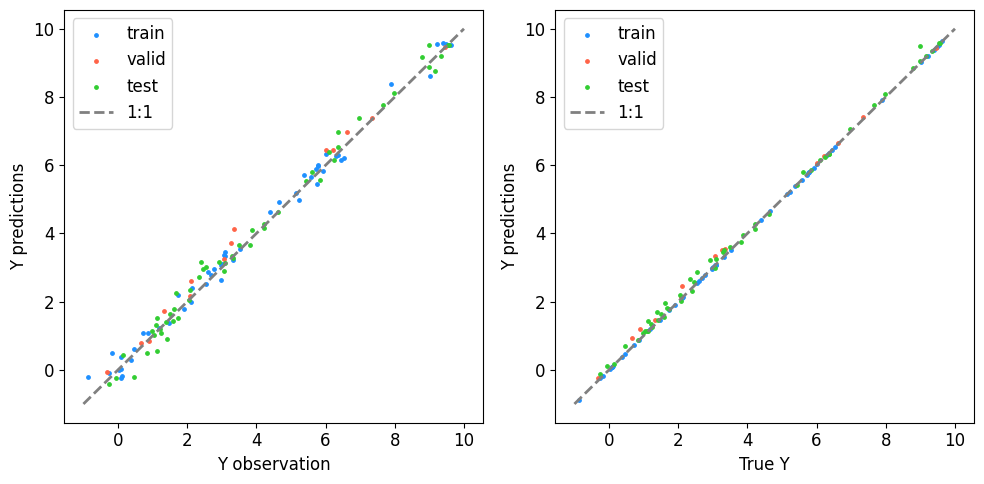



Setting up the dummy function and its latent function using nb_samples = 170 ...
Splitting 56.00000000000001% of 170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29903
Test RMSE of observed values: 0.32420
Train RMSE of observed true values: 0.29903
Test RMSE of observed true values: 0.13945
Train RMSE of observed values: 0.07180
Test RMSE of latent function: 0.06972
Plotting results ...


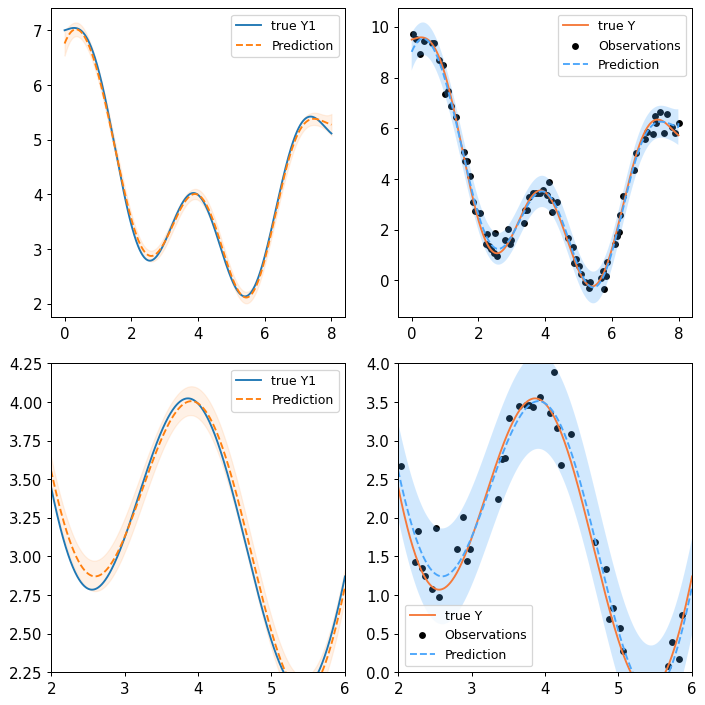

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


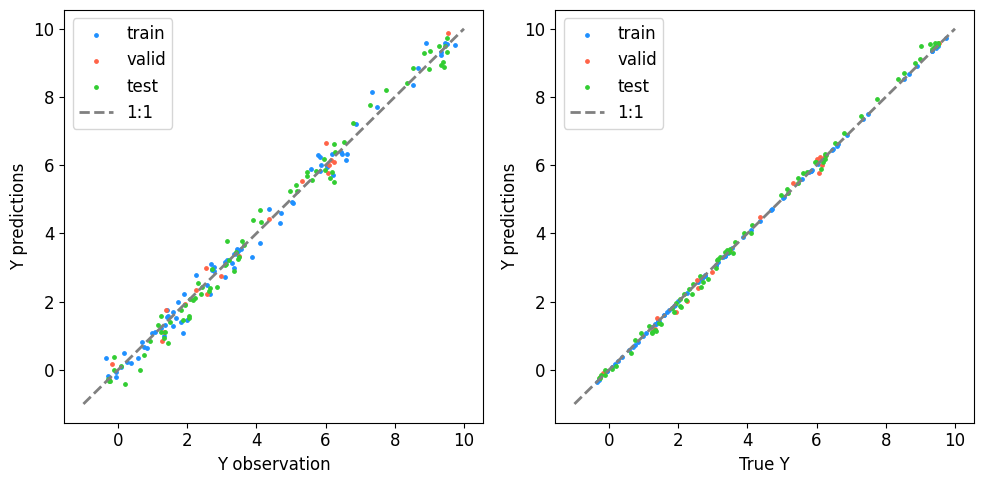



Setting up the dummy function and its latent function using nb_samples = 220 ...
Splitting 56.00000000000001% of 220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27929
Test RMSE of observed values: 0.32541
Train RMSE of observed true values: 0.27929
Test RMSE of observed true values: 0.11782
Train RMSE of observed values: 0.05207
Test RMSE of latent function: 0.05891
Plotting results ...


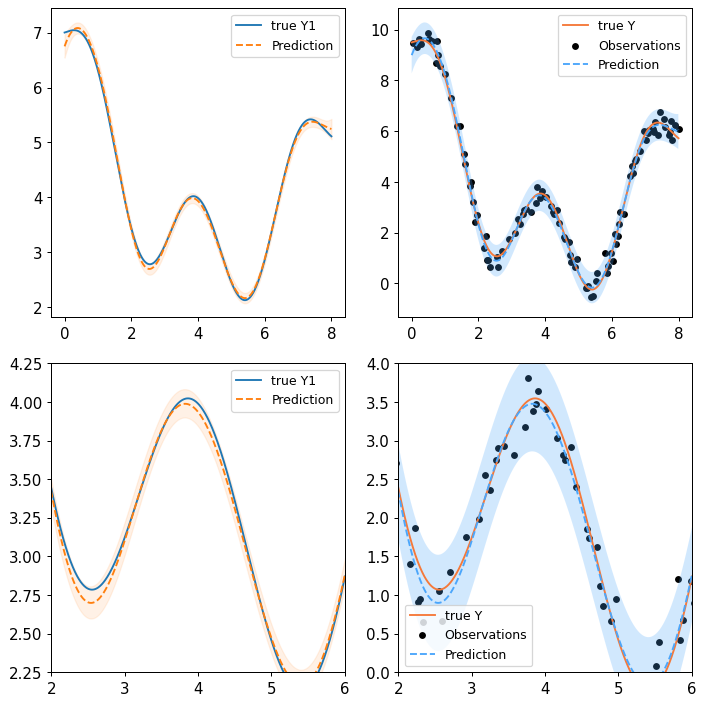

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


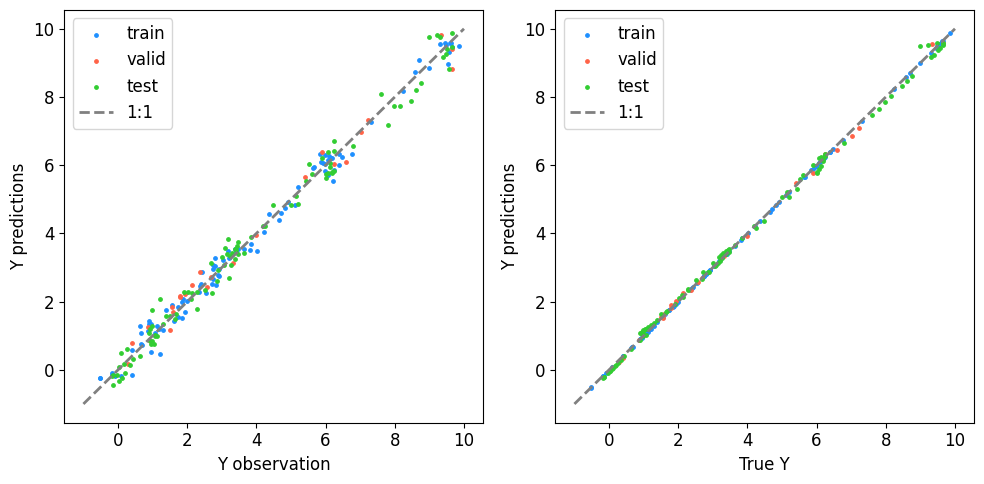



Setting up the dummy function and its latent function using nb_samples = 270 ...
Splitting 56.00000000000001% of 270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.25411
Test RMSE of observed values: 0.28568
Train RMSE of observed true values: 0.25411
Test RMSE of observed true values: 0.10079
Train RMSE of observed values: 0.04923
Test RMSE of latent function: 0.05039
Plotting results ...


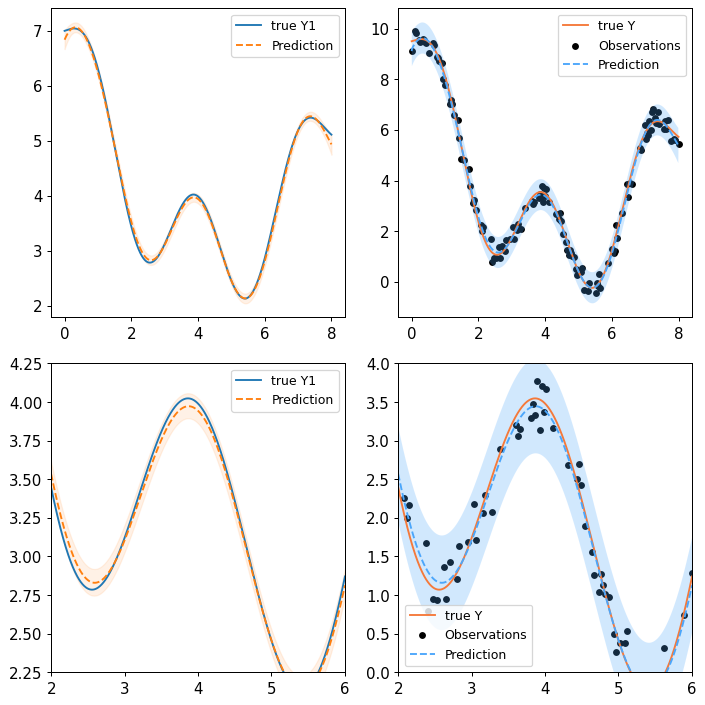

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


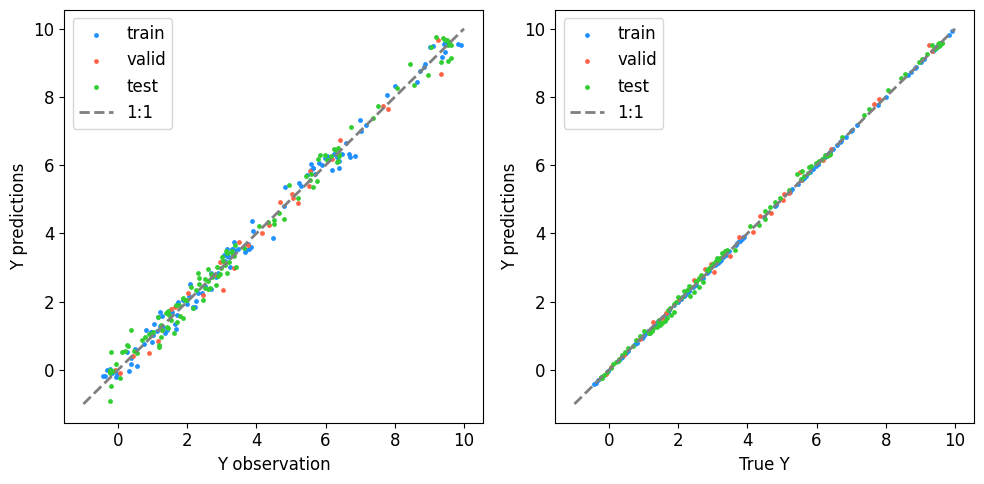



Setting up the dummy function and its latent function using nb_samples = 320 ...
Splitting 56.00000000000001% of 320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28852
Test RMSE of observed values: 0.30096
Train RMSE of observed true values: 0.28852
Test RMSE of observed true values: 0.10229
Train RMSE of observed values: 0.05151
Test RMSE of latent function: 0.05114
Plotting results ...


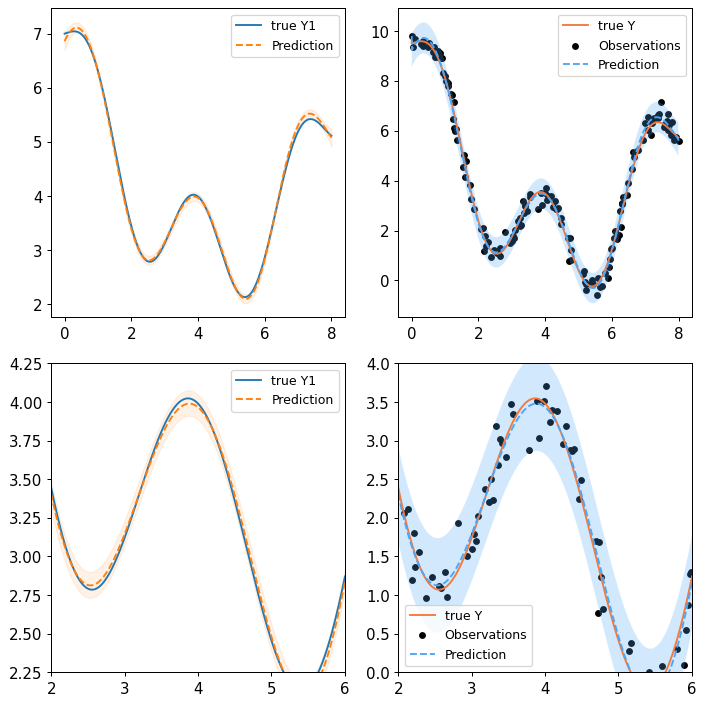

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


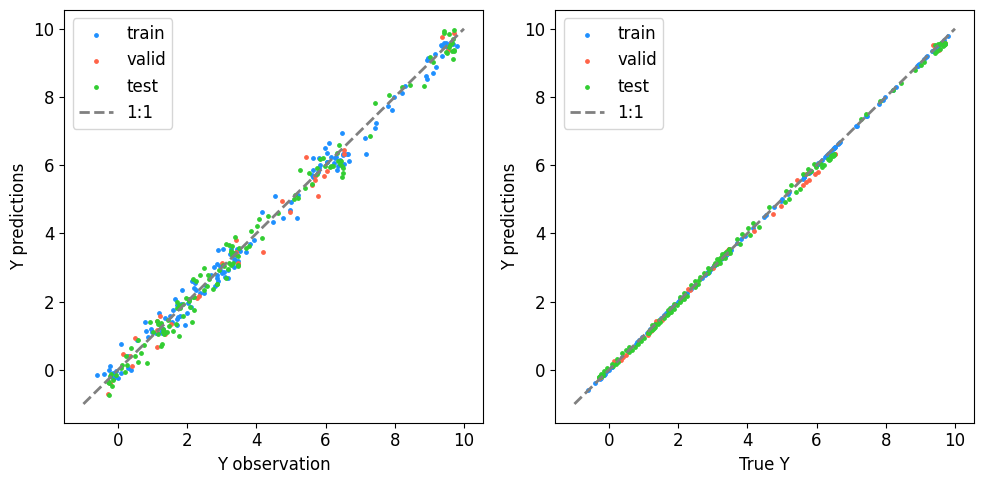



Setting up the dummy function and its latent function using nb_samples = 370 ...
Splitting 56.00000000000001% of 370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30331
Test RMSE of observed values: 0.29119
Train RMSE of observed true values: 0.30331
Test RMSE of observed true values: 0.11578
Train RMSE of observed values: 0.05387
Test RMSE of latent function: 0.05789
Plotting results ...


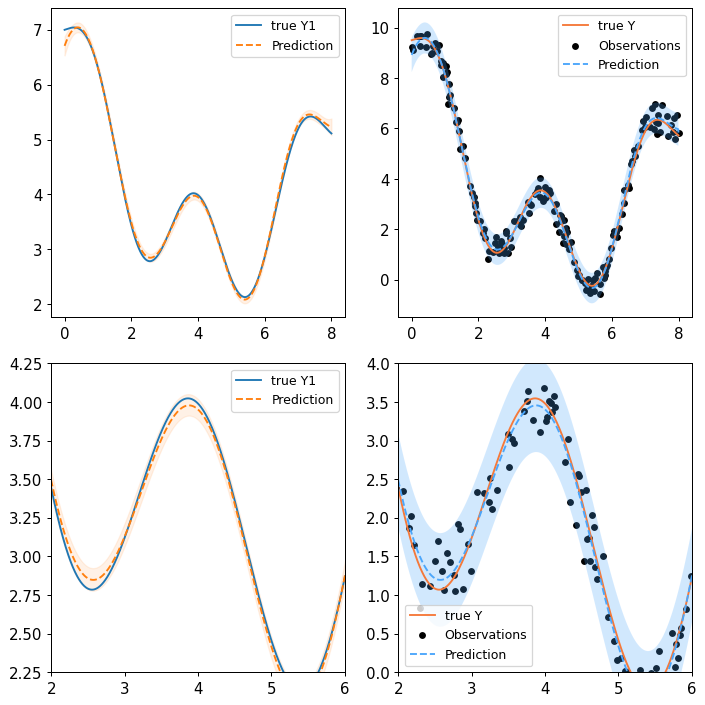

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


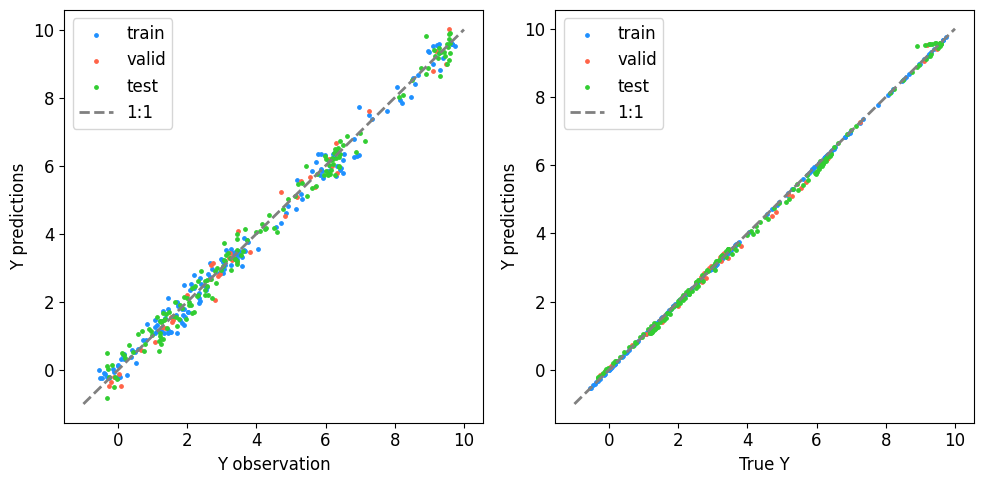



Setting up the dummy function and its latent function using nb_samples = 420 ...
Splitting 56.00000000000001% of 420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27136
Test RMSE of observed values: 0.31851
Train RMSE of observed true values: 0.27136
Test RMSE of observed true values: 0.08618
Train RMSE of observed values: 0.03633
Test RMSE of latent function: 0.04309
Plotting results ...


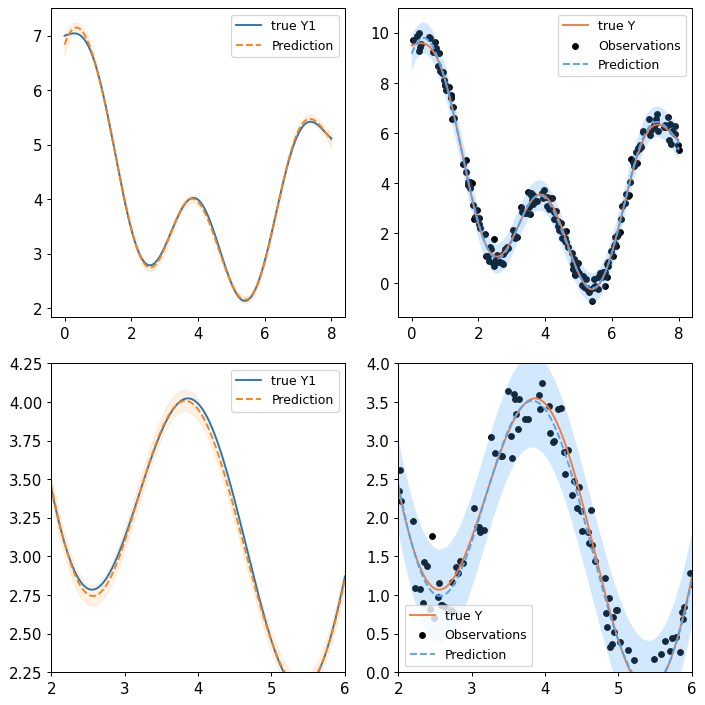

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


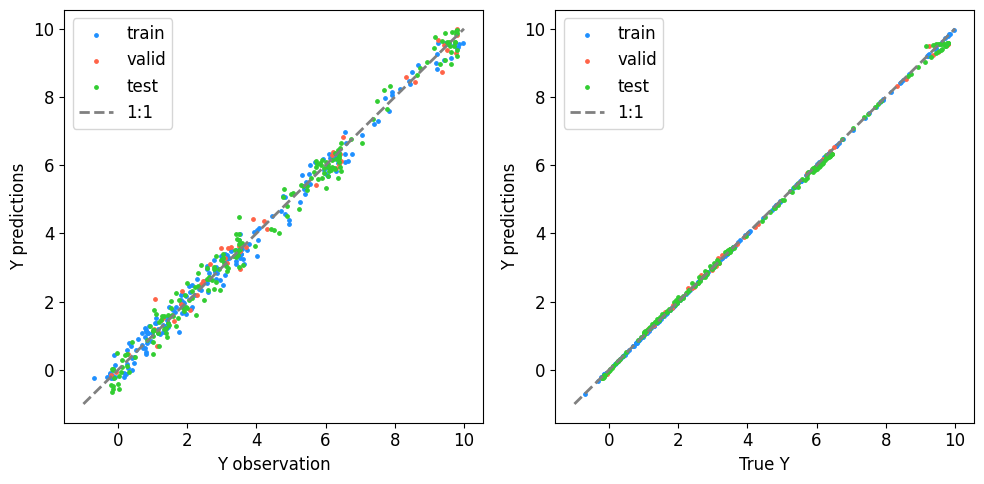



Setting up the dummy function and its latent function using nb_samples = 470 ...
Splitting 56.00000000000001% of 470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29242
Test RMSE of observed values: 0.33406
Train RMSE of observed true values: 0.29242
Test RMSE of observed true values: 0.08321
Train RMSE of observed values: 0.03977
Test RMSE of latent function: 0.04161
Plotting results ...


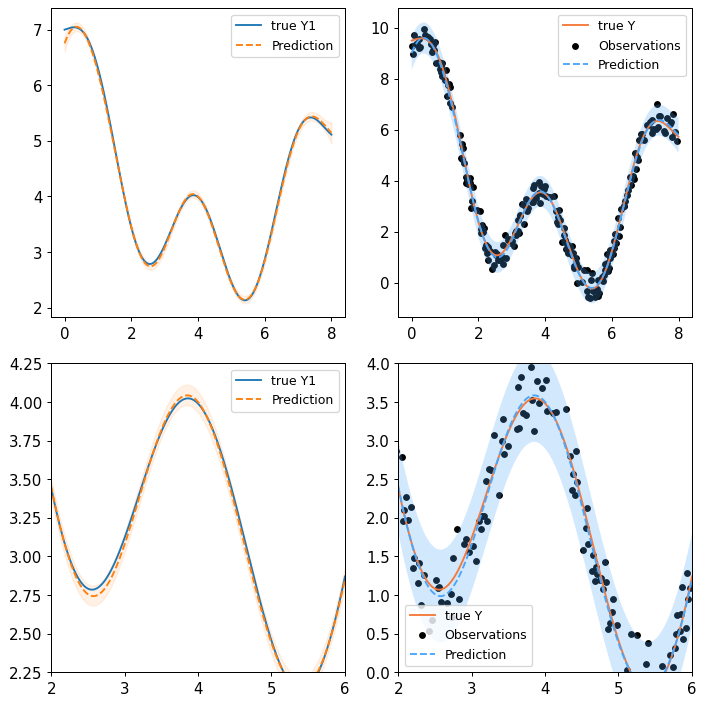

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


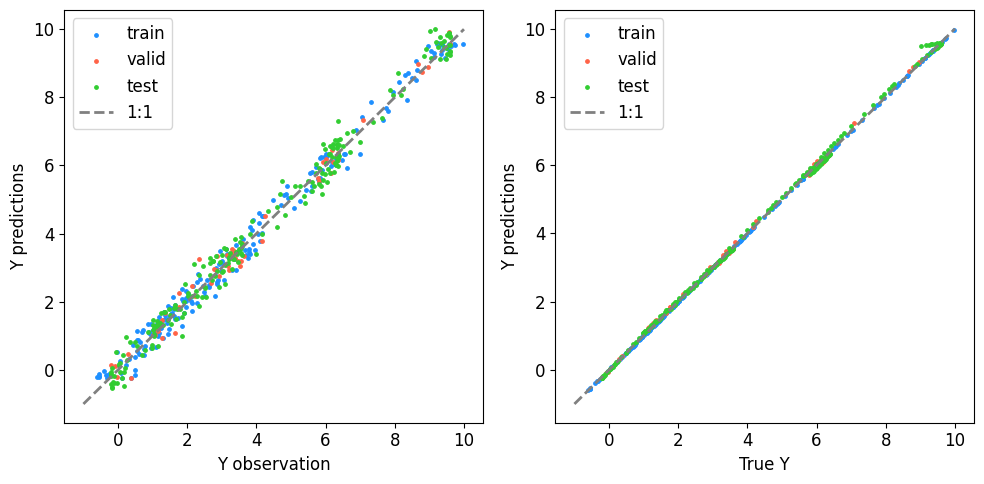



Setting up the dummy function and its latent function using nb_samples = 520 ...
Splitting 56.00000000000001% of 520 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28747
Test RMSE of observed values: 0.30926
Train RMSE of observed true values: 0.28747
Test RMSE of observed true values: 0.08615
Train RMSE of observed values: 0.03864
Test RMSE of latent function: 0.04307
Plotting results ...


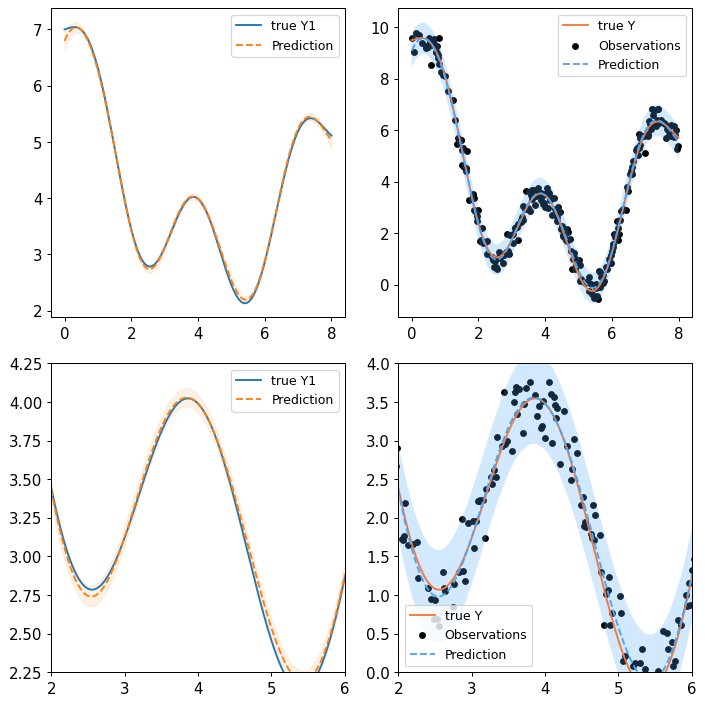

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


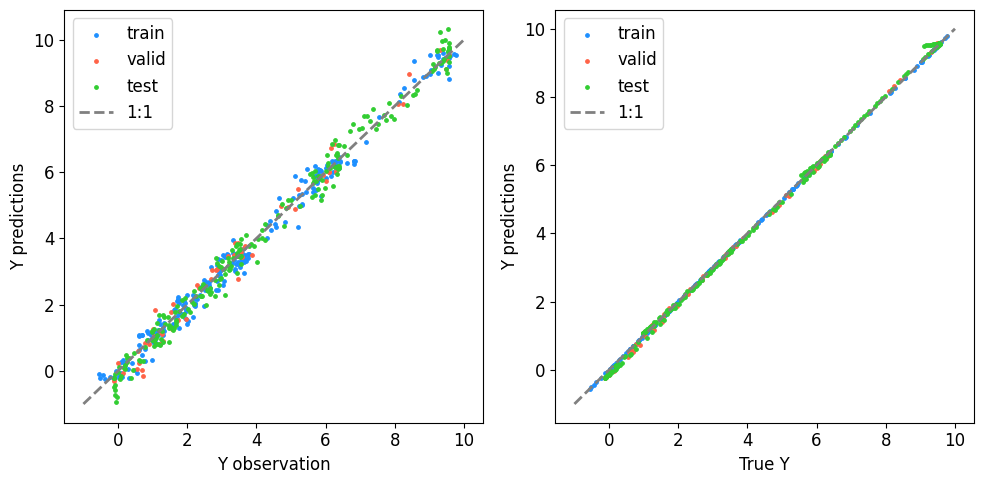



Setting up the dummy function and its latent function using nb_samples = 570 ...
Splitting 56.00000000000001% of 570 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28330
Test RMSE of observed values: 0.29290
Train RMSE of observed true values: 0.28330
Test RMSE of observed true values: 0.07050
Train RMSE of observed values: 0.03400
Test RMSE of latent function: 0.03525
Plotting results ...


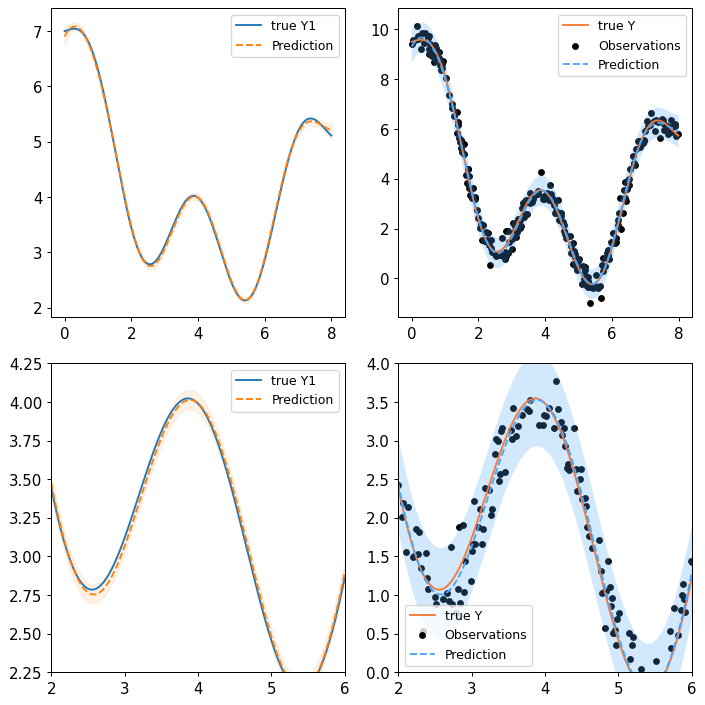

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


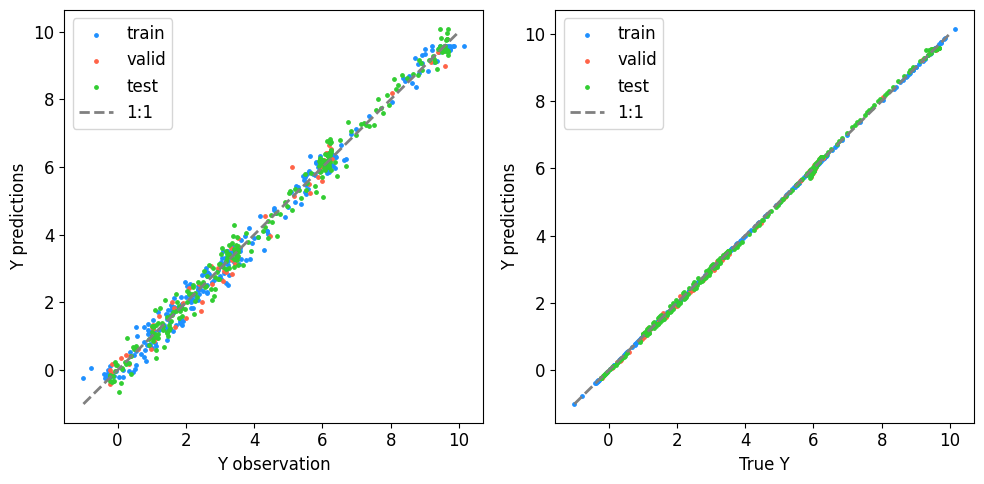



Setting up the dummy function and its latent function using nb_samples = 620 ...
Splitting 56.00000000000001% of 620 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30903
Test RMSE of observed values: 0.31544
Train RMSE of observed true values: 0.30903
Test RMSE of observed true values: 0.08858
Train RMSE of observed values: 0.03652
Test RMSE of latent function: 0.04429
Plotting results ...


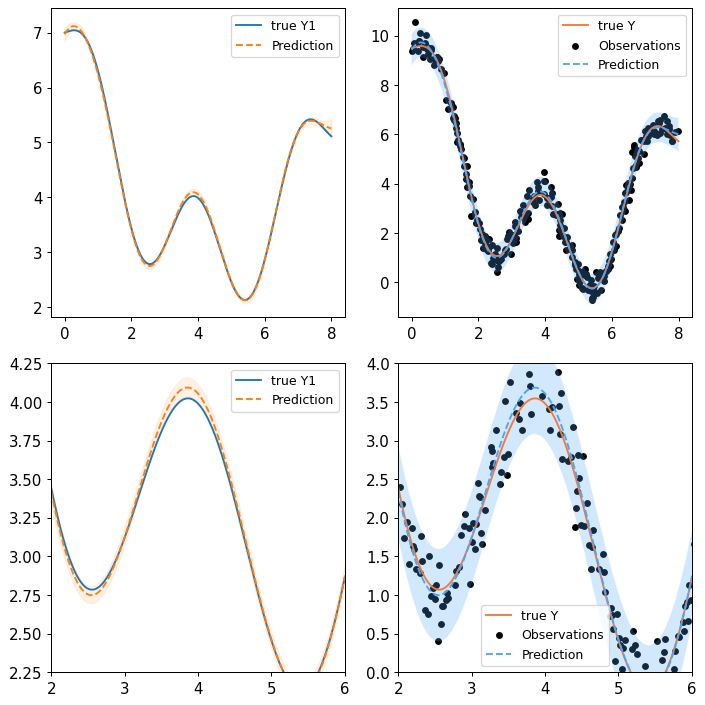

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


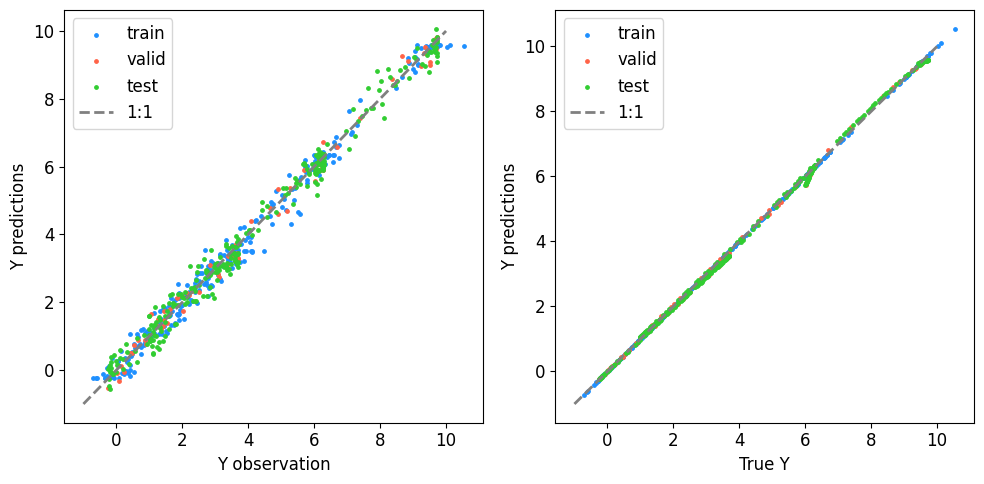



Setting up the dummy function and its latent function using nb_samples = 670 ...
Splitting 56.00000000000001% of 670 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28918
Test RMSE of observed values: 0.31201
Train RMSE of observed true values: 0.28918
Test RMSE of observed true values: 0.05224
Train RMSE of observed values: 0.02473
Test RMSE of latent function: 0.02612
Plotting results ...


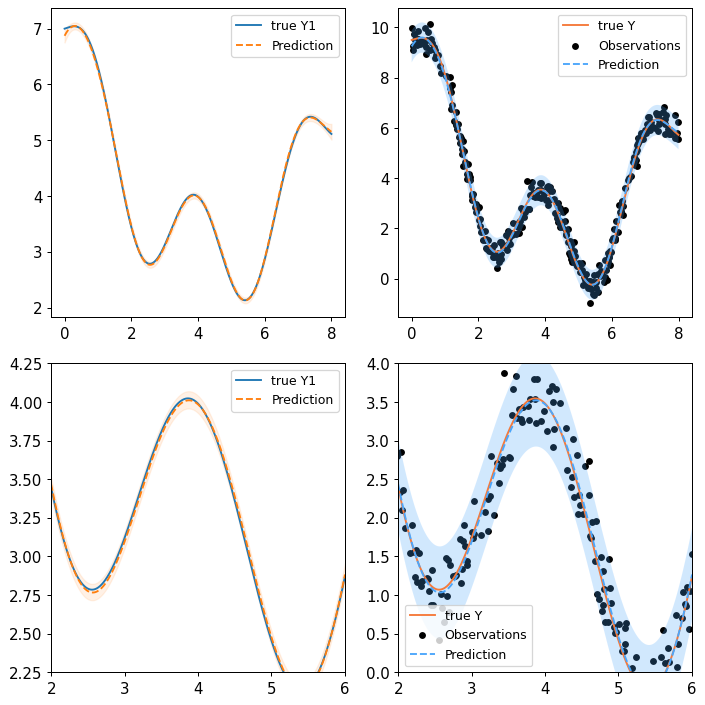

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


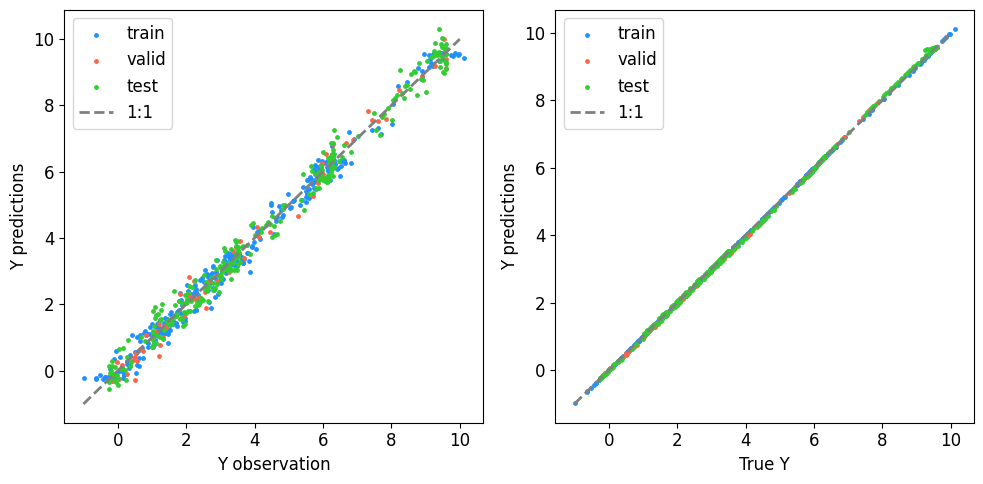



Setting up the dummy function and its latent function using nb_samples = 720 ...
Splitting 56.00000000000001% of 720 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30512
Test RMSE of observed values: 0.31382
Train RMSE of observed true values: 0.30512
Test RMSE of observed true values: 0.05339
Train RMSE of observed values: 0.02426
Test RMSE of latent function: 0.02669
Plotting results ...


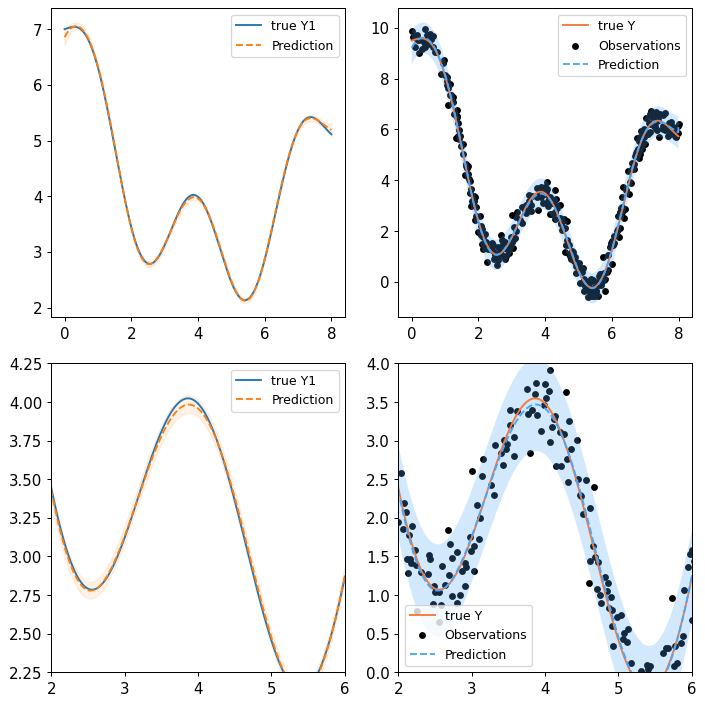

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


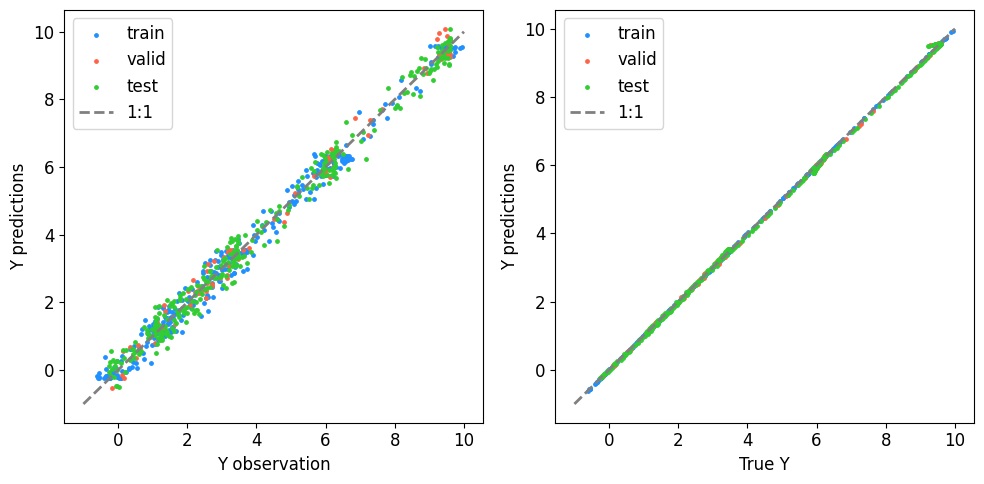



Setting up the dummy function and its latent function using nb_samples = 770 ...
Splitting 56.00000000000001% of 770 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29348
Test RMSE of observed values: 0.31881
Train RMSE of observed true values: 0.29348
Test RMSE of observed true values: 0.05186
Train RMSE of observed values: 0.02708
Test RMSE of latent function: 0.02593
Plotting results ...


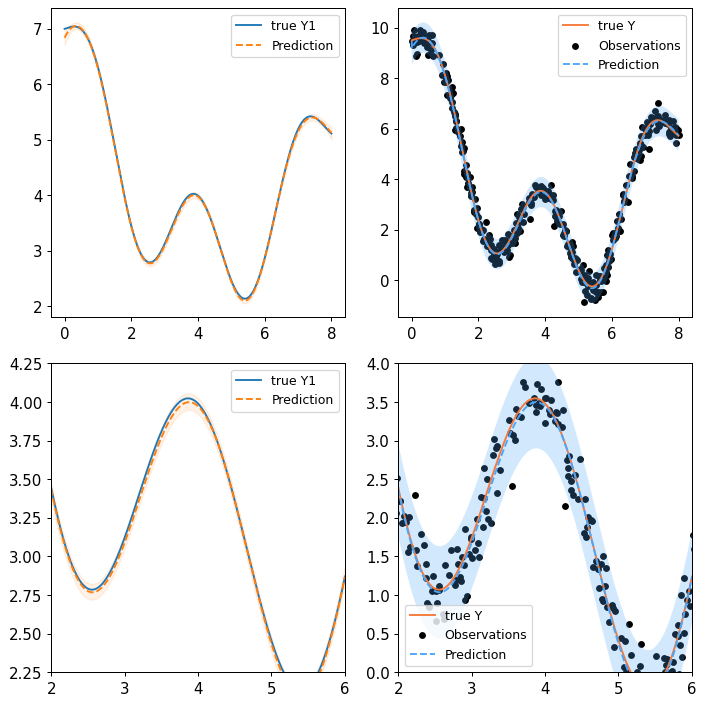

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


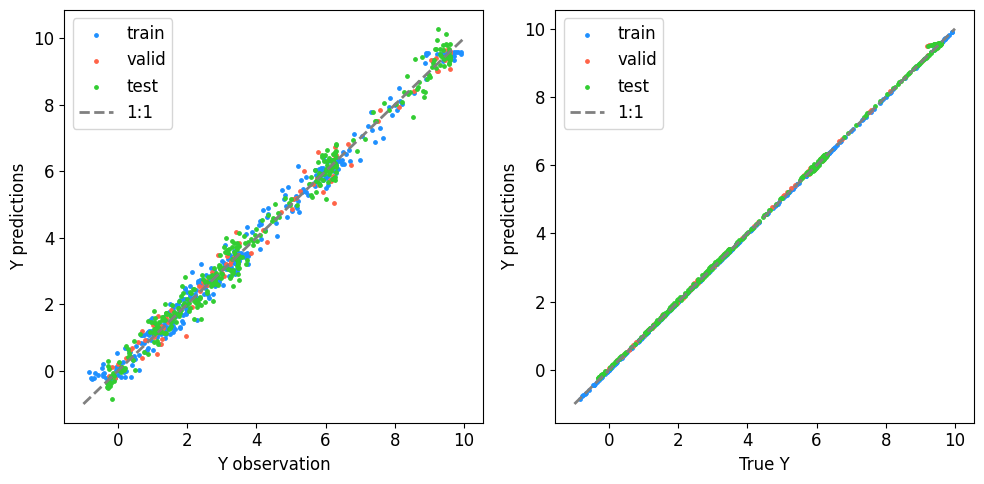



Setting up the dummy function and its latent function using nb_samples = 820 ...
Splitting 56.00000000000001% of 820 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29609
Test RMSE of observed values: 0.26294
Train RMSE of observed true values: 0.29609
Test RMSE of observed true values: 0.04841
Train RMSE of observed values: 0.02302
Test RMSE of latent function: 0.02421
Plotting results ...


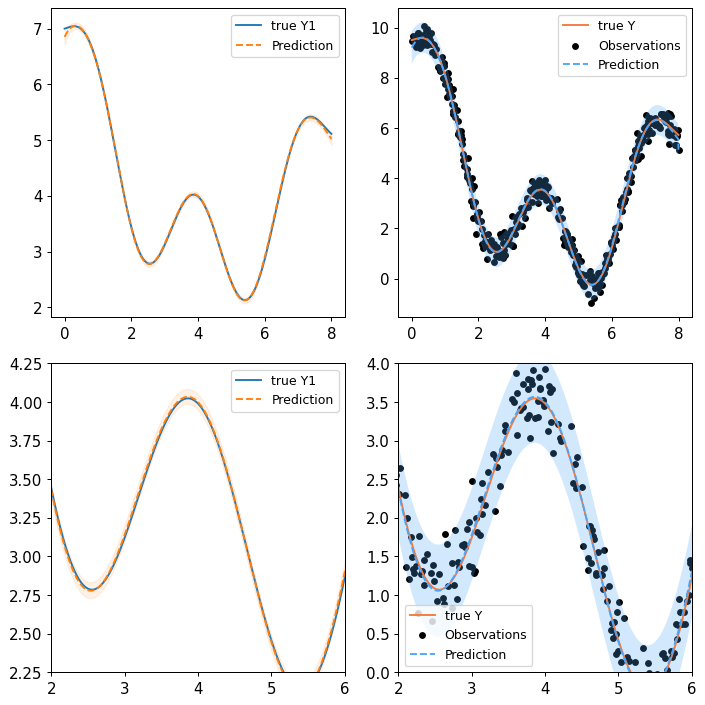

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


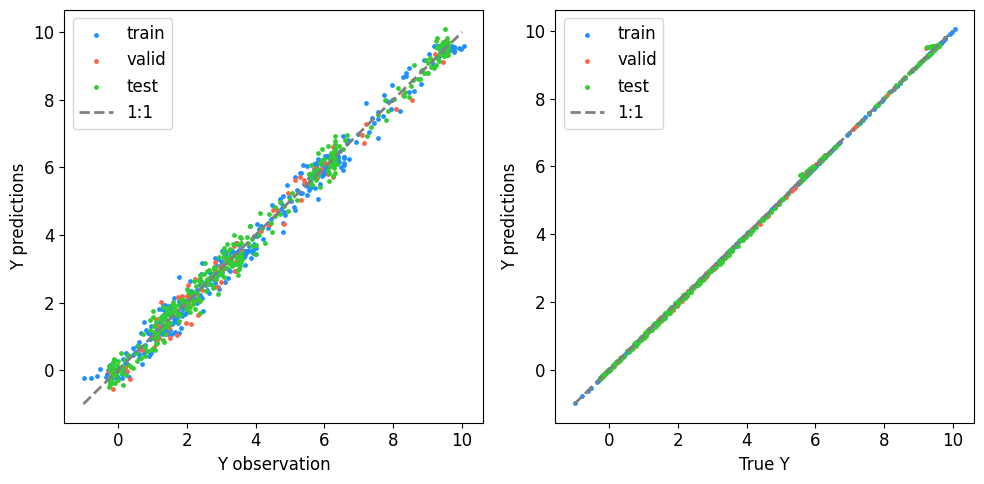



Setting up the dummy function and its latent function using nb_samples = 870 ...
Splitting 56.00000000000001% of 870 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31060
Test RMSE of observed values: 0.31650
Train RMSE of observed true values: 0.31060
Test RMSE of observed true values: 0.07311
Train RMSE of observed values: 0.03449
Test RMSE of latent function: 0.03655
Plotting results ...


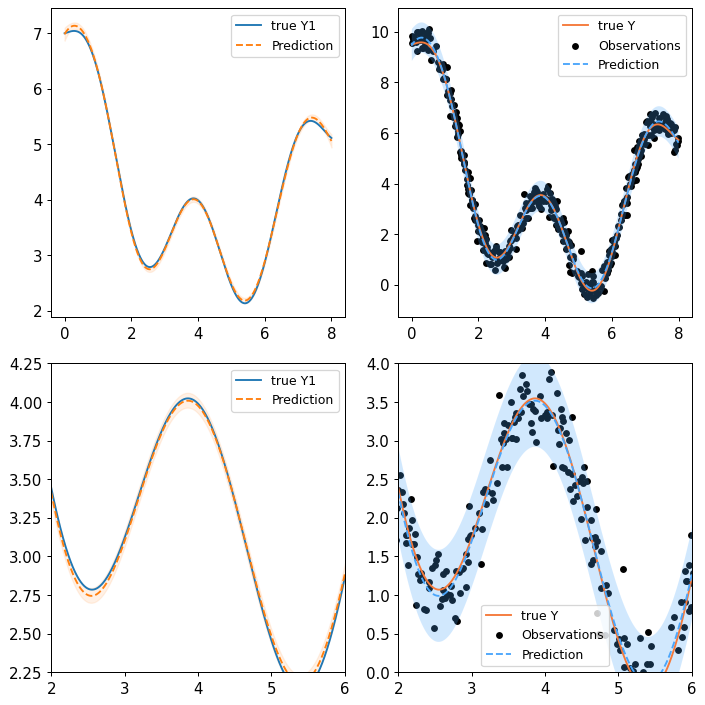

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


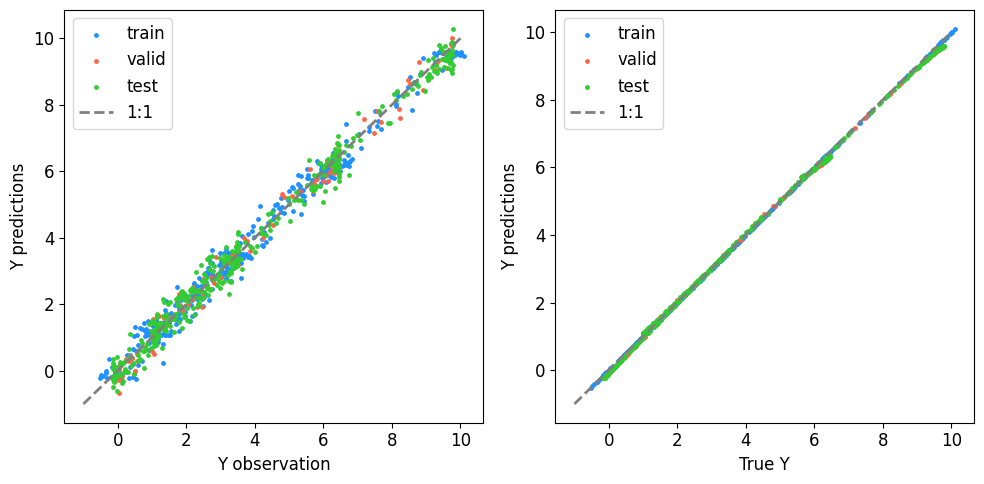



Setting up the dummy function and its latent function using nb_samples = 920 ...
Splitting 56.00000000000001% of 920 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31661
Test RMSE of observed values: 0.31321
Train RMSE of observed true values: 0.31661
Test RMSE of observed true values: 0.06339
Train RMSE of observed values: 0.03028
Test RMSE of latent function: 0.03170
Plotting results ...


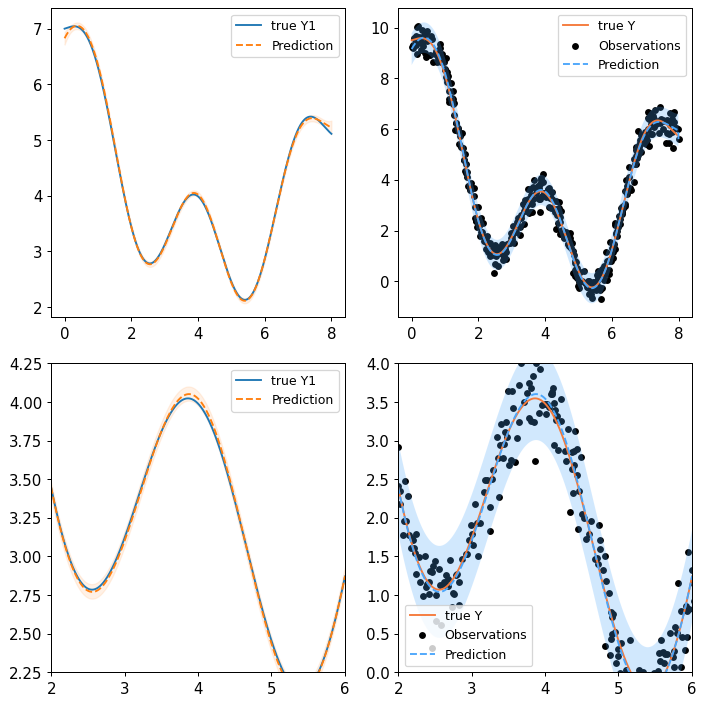

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


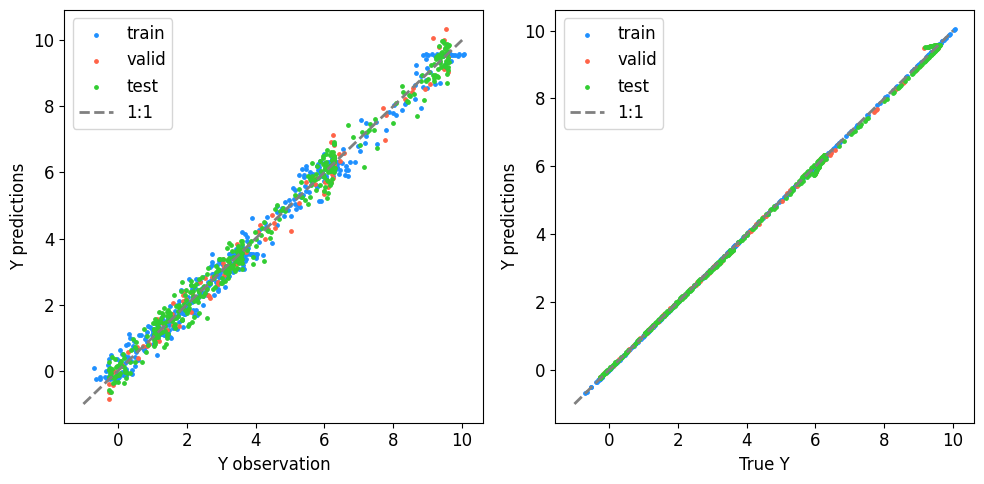



Setting up the dummy function and its latent function using nb_samples = 970 ...
Splitting 56.00000000000001% of 970 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30226
Test RMSE of observed values: 0.29463
Train RMSE of observed true values: 0.30226
Test RMSE of observed true values: 0.07273
Train RMSE of observed values: 0.03336
Test RMSE of latent function: 0.03636
Plotting results ...


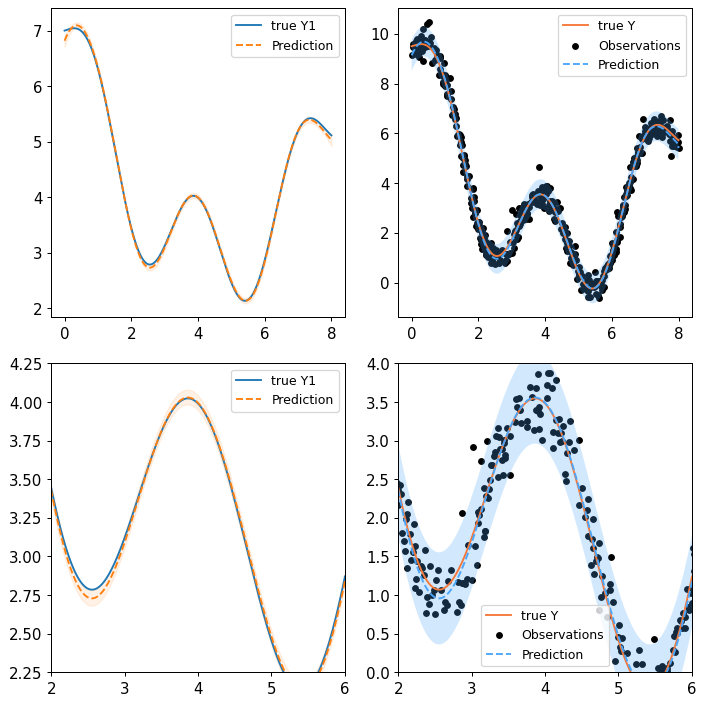

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


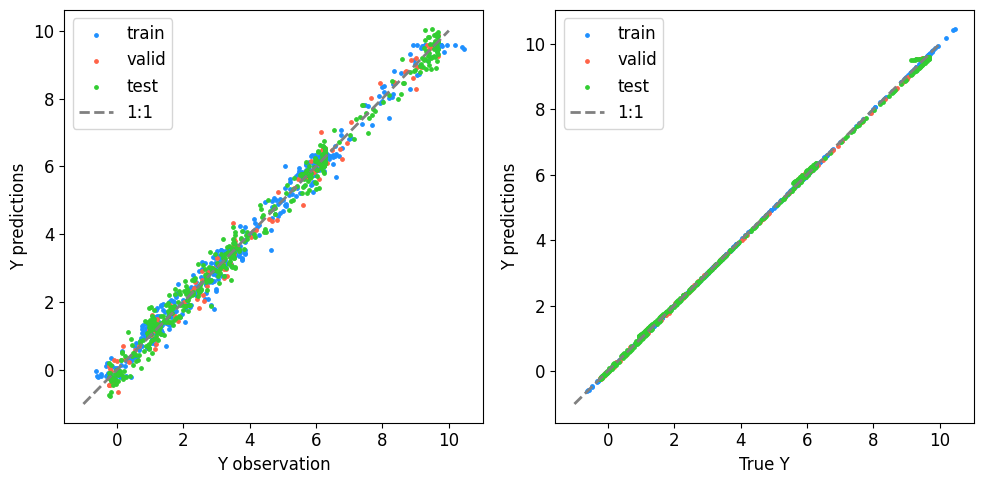



Setting up the dummy function and its latent function using nb_samples = 1020 ...
Splitting 56.00000000000001% of 1020 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30335
Test RMSE of observed values: 0.29647
Train RMSE of observed true values: 0.30335
Test RMSE of observed true values: 0.05409
Train RMSE of observed values: 0.02564
Test RMSE of latent function: 0.02704
Plotting results ...


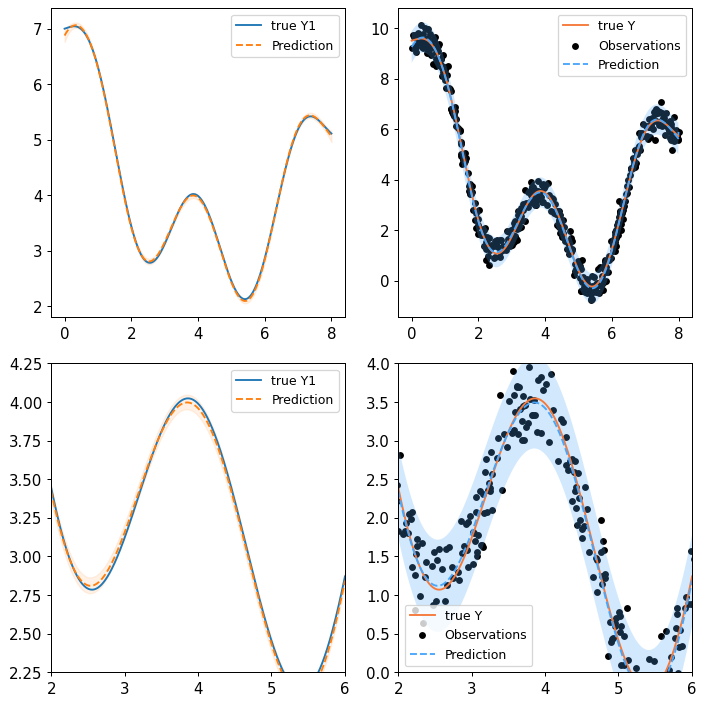

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


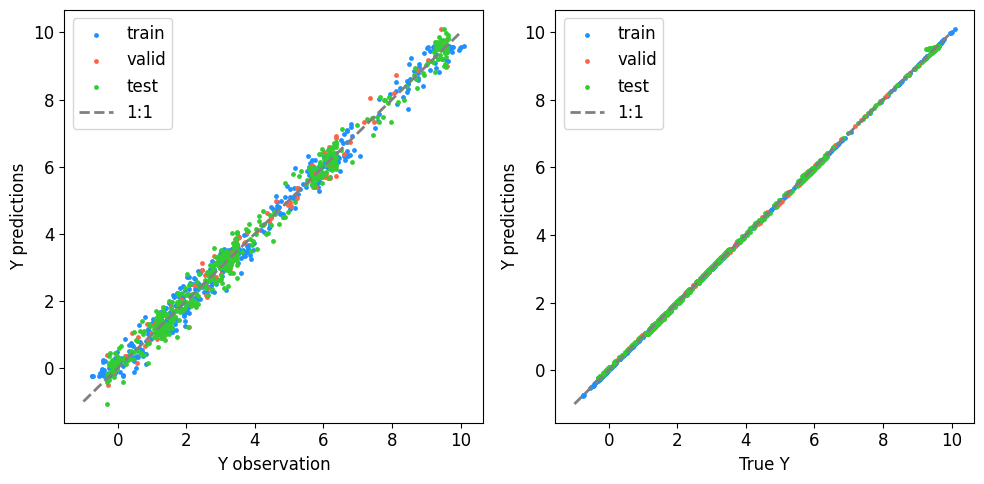



Setting up the dummy function and its latent function using nb_samples = 1070 ...
Splitting 56.00000000000001% of 1070 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28372
Test RMSE of observed values: 0.30483
Train RMSE of observed true values: 0.28372
Test RMSE of observed true values: 0.04665
Train RMSE of observed values: 0.02344
Test RMSE of latent function: 0.02332
Plotting results ...


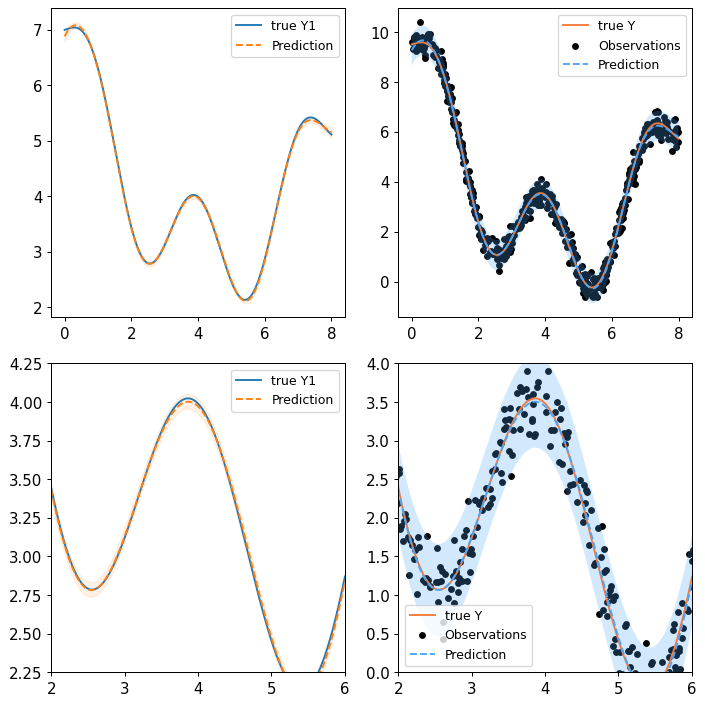

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


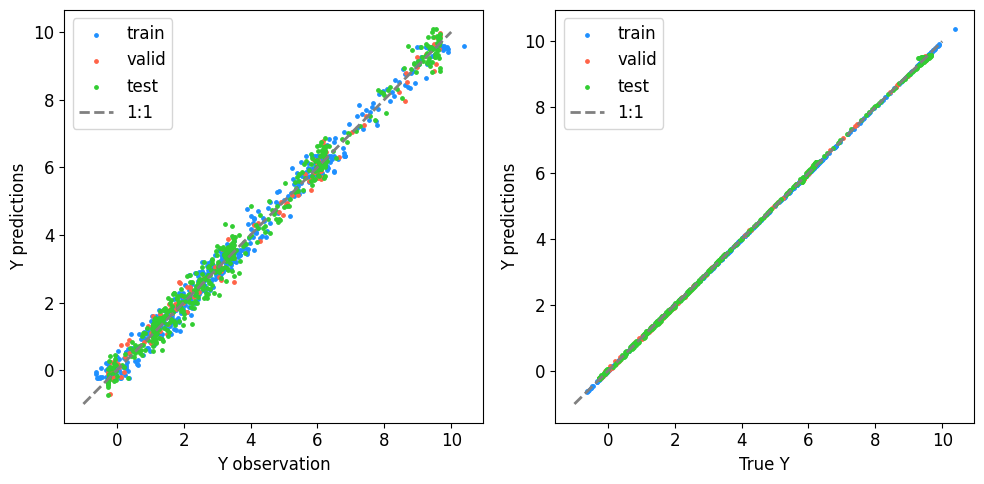



Setting up the dummy function and its latent function using nb_samples = 1120 ...
Splitting 56.00000000000001% of 1120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30783
Test RMSE of observed values: 0.30653
Train RMSE of observed true values: 0.30783
Test RMSE of observed true values: 0.05415
Train RMSE of observed values: 0.02293
Test RMSE of latent function: 0.02708
Plotting results ...


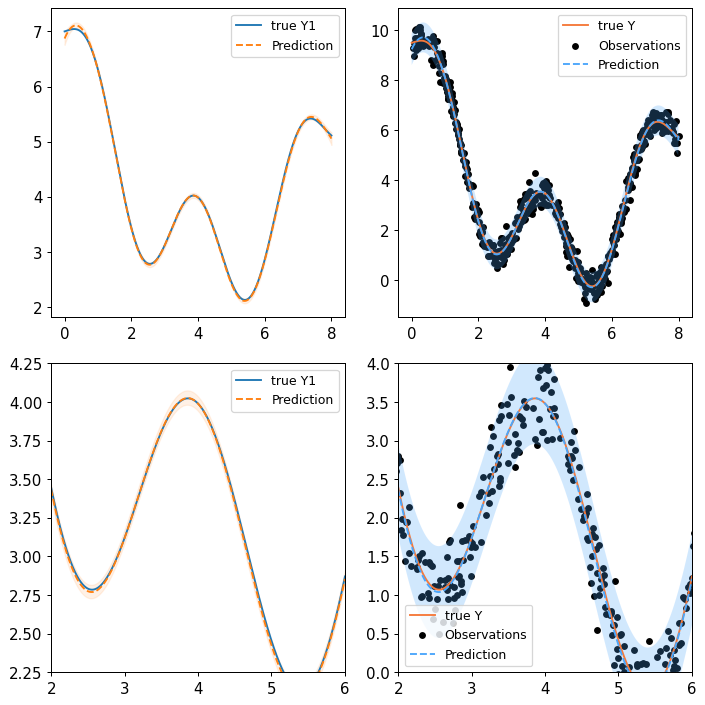

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


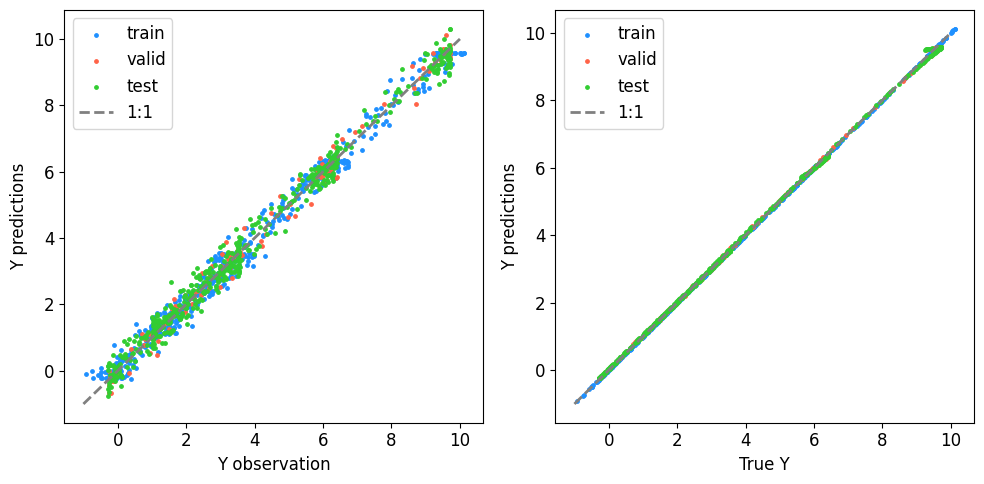



Setting up the dummy function and its latent function using nb_samples = 1170 ...
Splitting 56.00000000000001% of 1170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30000
Test RMSE of observed values: 0.29224
Train RMSE of observed true values: 0.30000
Test RMSE of observed true values: 0.03636
Train RMSE of observed values: 0.01834
Test RMSE of latent function: 0.01818
Plotting results ...


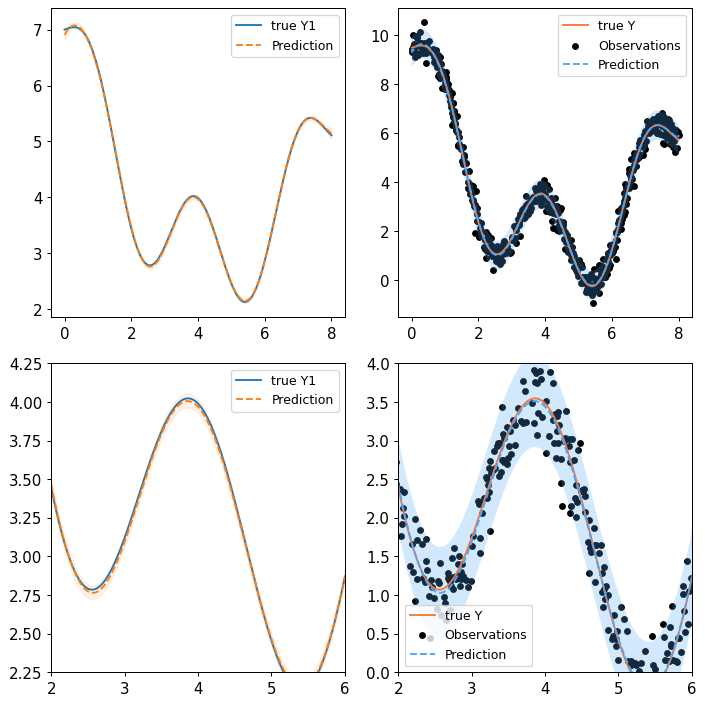

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


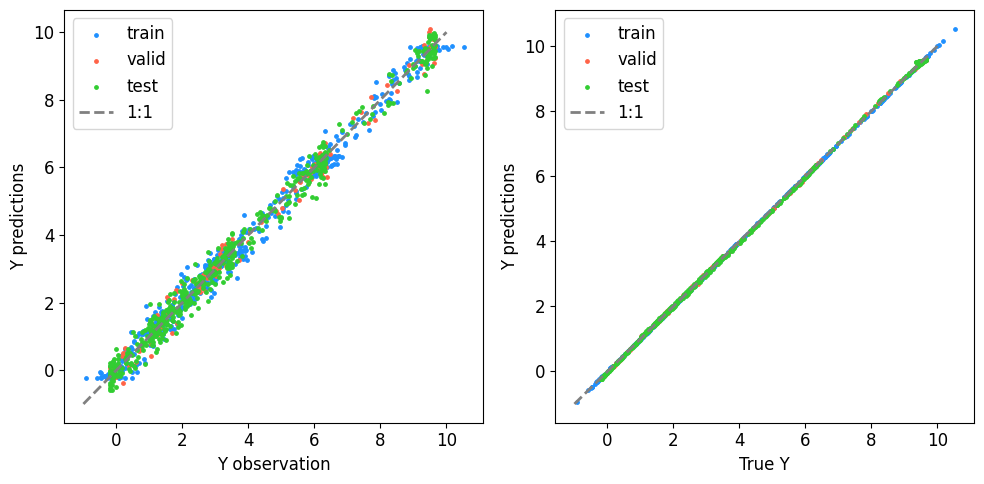



Setting up the dummy function and its latent function using nb_samples = 1220 ...
Splitting 56.00000000000001% of 1220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30900
Test RMSE of observed values: 0.30080
Train RMSE of observed true values: 0.30900
Test RMSE of observed true values: 0.04117
Train RMSE of observed values: 0.01975
Test RMSE of latent function: 0.02058
Plotting results ...


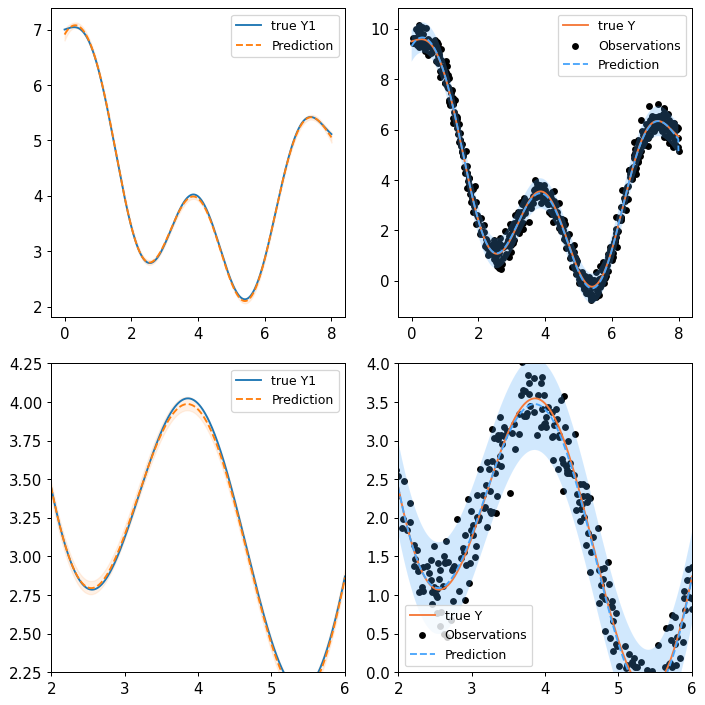

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


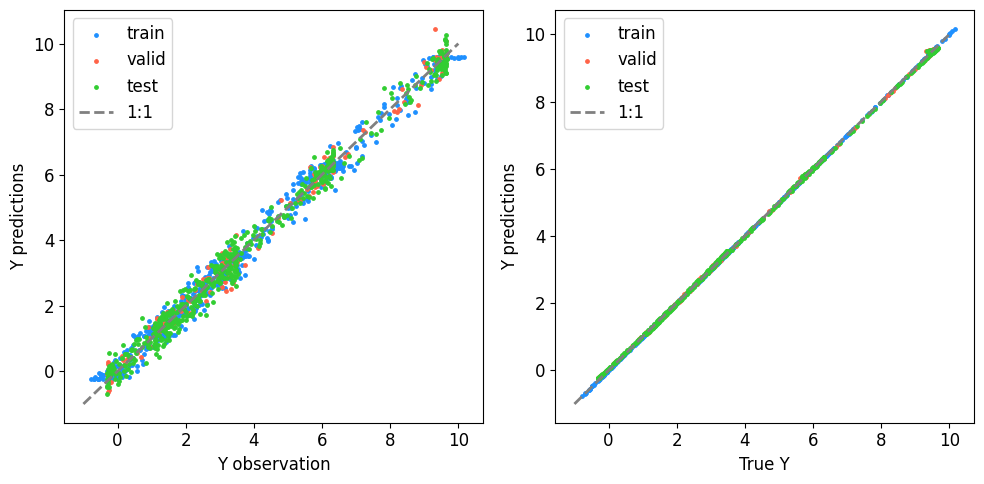



Setting up the dummy function and its latent function using nb_samples = 1270 ...
Splitting 56.00000000000001% of 1270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30150
Test RMSE of observed values: 0.30670
Train RMSE of observed true values: 0.30150
Test RMSE of observed true values: 0.03082
Train RMSE of observed values: 0.01450
Test RMSE of latent function: 0.01541
Plotting results ...


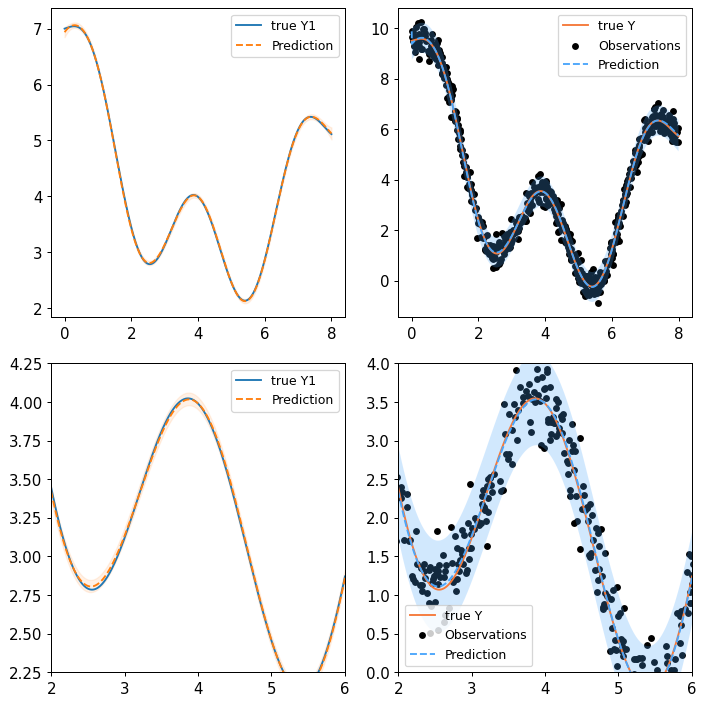

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


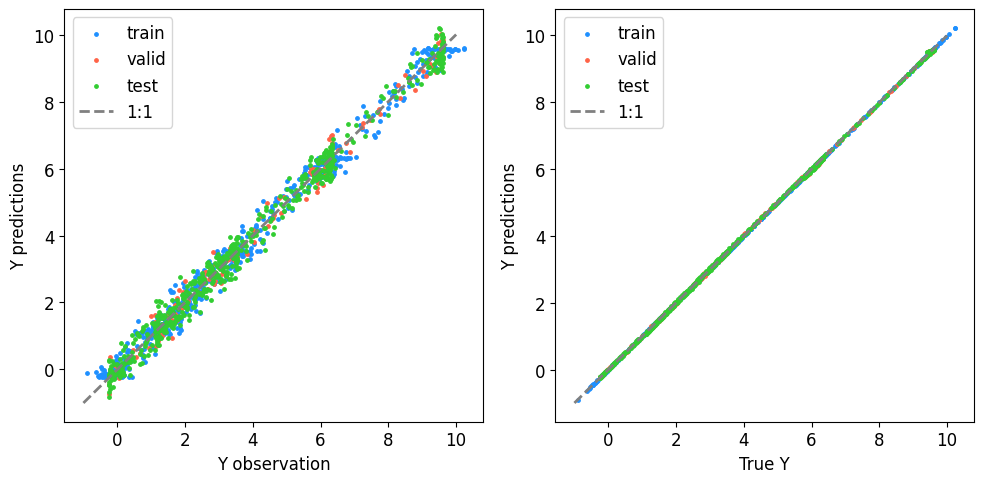



Setting up the dummy function and its latent function using nb_samples = 1320 ...
Splitting 56.00000000000001% of 1320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29892
Test RMSE of observed values: 0.29564
Train RMSE of observed true values: 0.29892
Test RMSE of observed true values: 0.04311
Train RMSE of observed values: 0.02074
Test RMSE of latent function: 0.02156
Plotting results ...


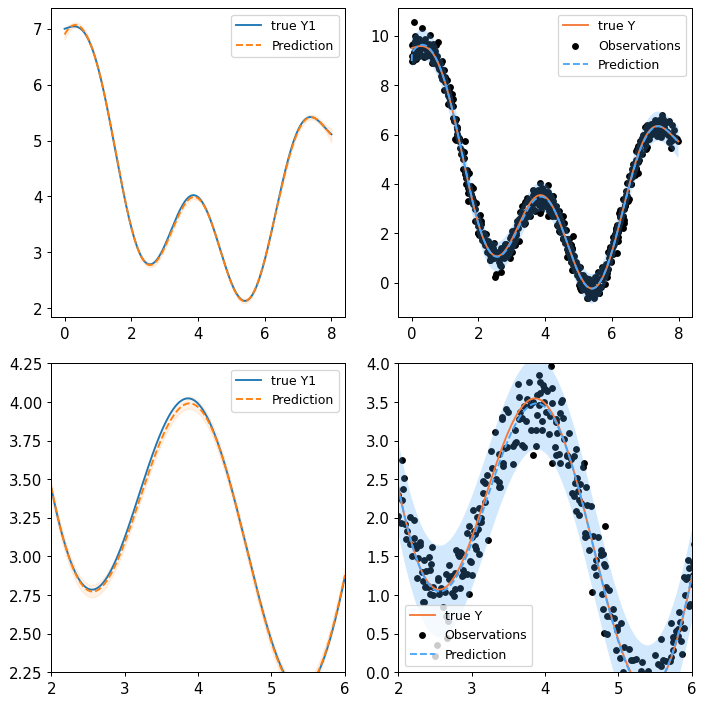

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


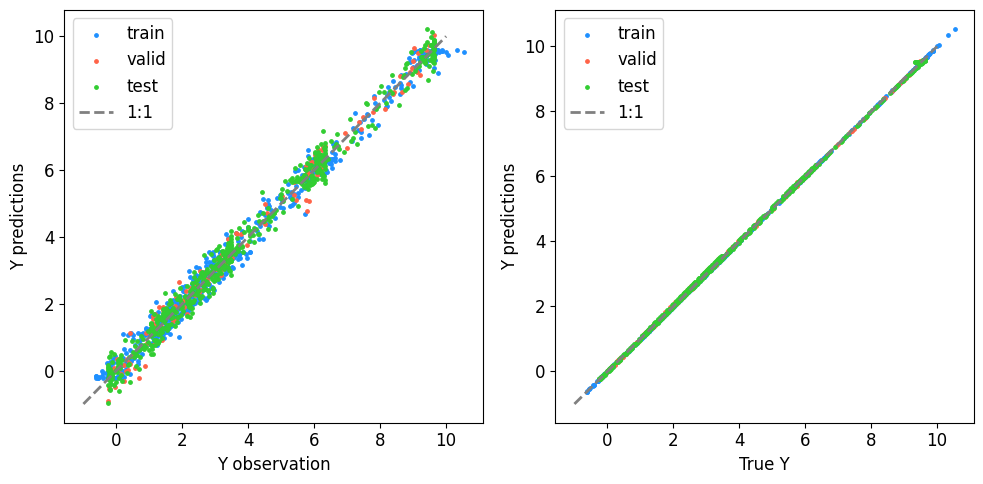



Setting up the dummy function and its latent function using nb_samples = 1370 ...
Splitting 56.00000000000001% of 1370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29902
Test RMSE of observed values: 0.31187
Train RMSE of observed true values: 0.29902
Test RMSE of observed true values: 0.03796
Train RMSE of observed values: 0.01898
Test RMSE of latent function: 0.01898
Plotting results ...


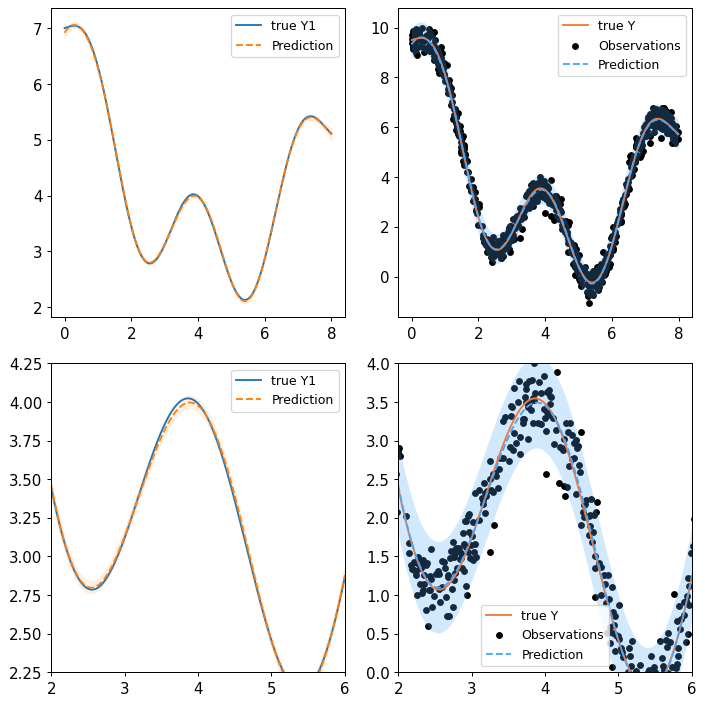

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


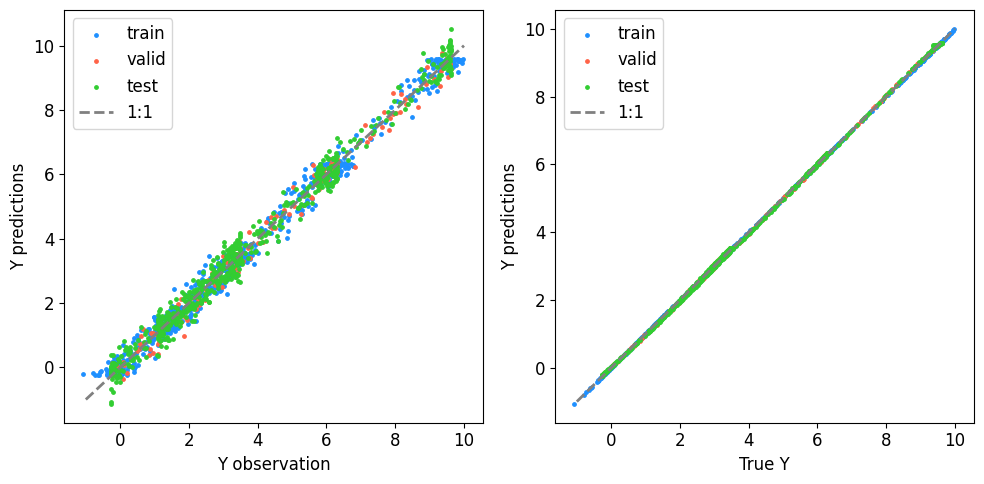



Setting up the dummy function and its latent function using nb_samples = 1420 ...
Splitting 56.00000000000001% of 1420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30084
Test RMSE of observed values: 0.30521
Train RMSE of observed true values: 0.30084
Test RMSE of observed true values: 0.04076
Train RMSE of observed values: 0.02053
Test RMSE of latent function: 0.02038
Plotting results ...


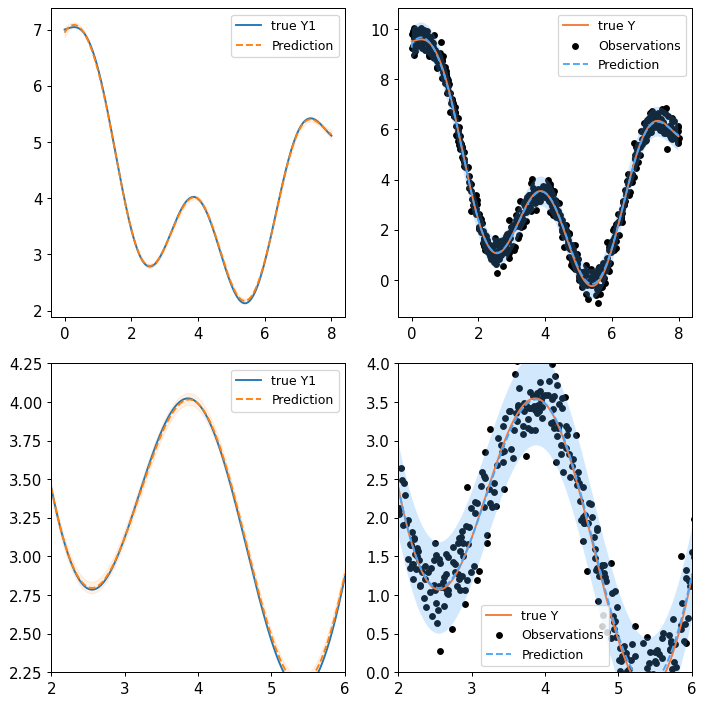

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


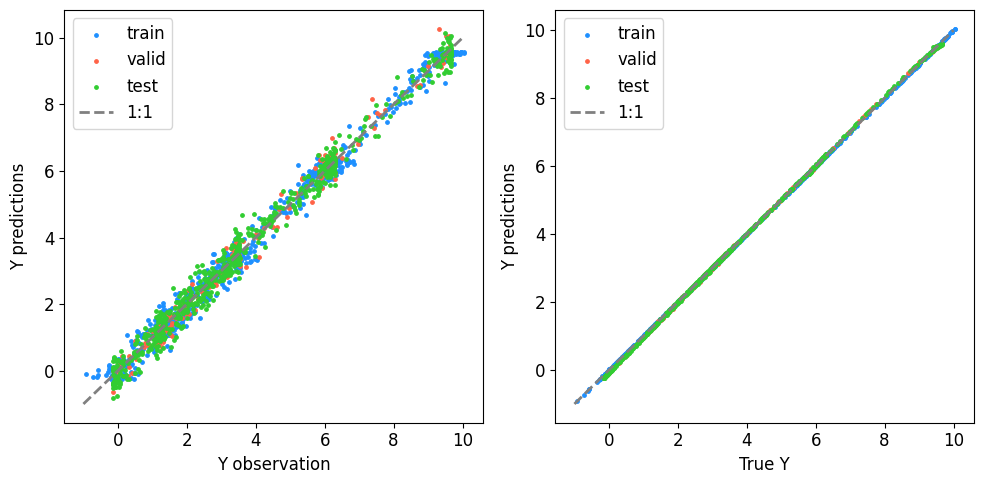



Setting up the dummy function and its latent function using nb_samples = 1470 ...
Splitting 56.00000000000001% of 1470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29632
Test RMSE of observed values: 0.30692
Train RMSE of observed true values: 0.29632
Test RMSE of observed true values: 0.01915
Train RMSE of observed values: 0.01013
Test RMSE of latent function: 0.00957
Plotting results ...


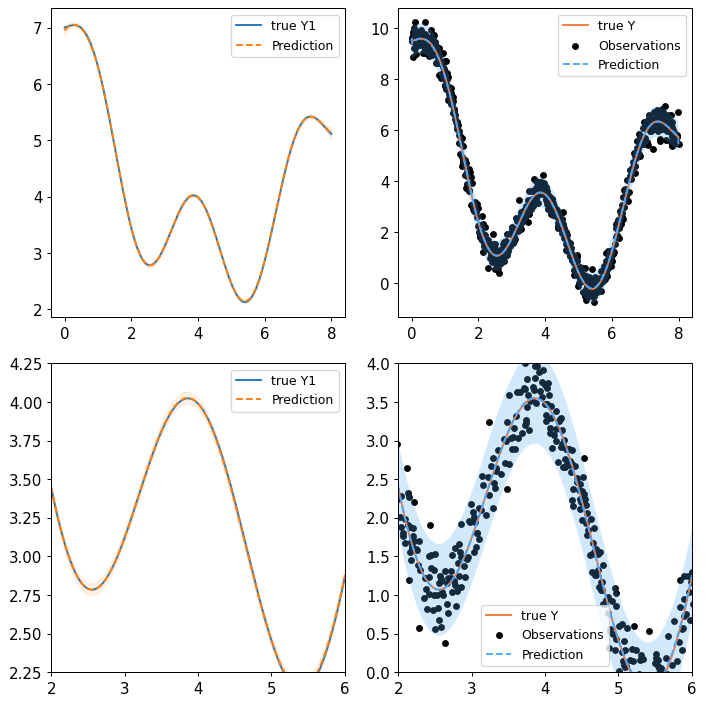

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


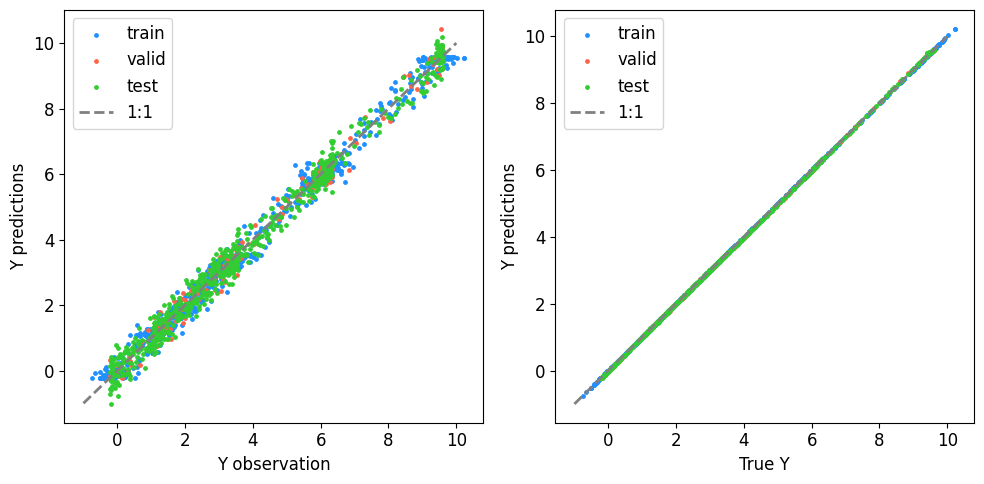

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_squared_error

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100.,
    u_scale: Positive = 1,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(Exp()).stretch(u_scale) + u_var2*GP(Linear()) # Construct Gaussian process.
         
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

def y1(x):
    return np.sin(x*2.)+ 0.2*x+2. +0.2*(x-5)**2

def y2(x):
    return -4.5+2*y1(x)

plot = True
scale =  False
optimize = False
train_size = 0.56

nb_samples = np.arange(20,1520,50)
# nb_samples = [15,50, 100,500,1000,3000]
# nb_samples = np.arange(20,1420,50)

rms = []
for nb_sample in nb_samples:
    
    x_obs = B.linspace(0.,8.,nb_sample)
    x_model = B.linspace(0.,8.,int(max(nb_samples)-0.1*max(nb_samples)))
    
    rms_test, rms_valid, rms_train = gp_dummy_compute_plot(train_size, nb_sample, x_obs, x_model, y1, y2, plot, scale, optimize)
    rms.append([rms_test, rms_valid, rms_train])
    

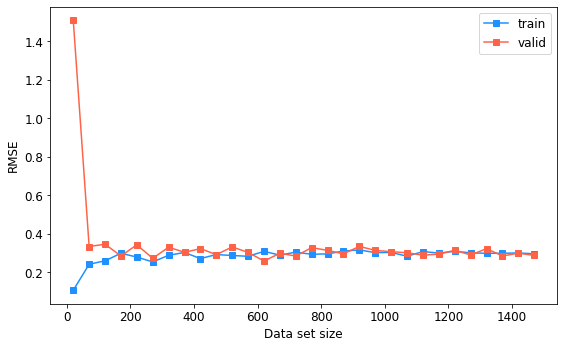

In [18]:
rms_test = [rms[i][0] for i in range(len(rms))]
rms_valid = [rms[i][1] for i in range(len(rms))]
rms_train = [rms[i][2] for i in range(len(rms))]
# print(rms_train)

plt.figure(figsize=(8,5))
# plt.style.use('seaborn-whitegrid') # nice and clean grid
# plt.plot(train_sizes,rms1_test,'-o',label='Training')

c1 = 'dodgerblue'
c2 = 'tomato'
c3 = 'limegreen'

plt.plot(nb_samples,rms_train,'s-',color=c1, label='train')
plt.plot(nb_samples,rms_valid,'s-',color=c2, label='valid')
# plt.plot(nb_samples,rms_test,'o-',color=c2, label='test')

plt.xlabel('Data set size')
plt.ylabel('RMSE')
plt.legend()
# plt.ylim(0,1)
plt.show()

Using periodic kernel



Setting up the dummy function and its latent function using nb_samples = 20 ...
Splitting 56.00000000000001% of 20 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.26235
Test RMSE of observed values: 2.11546
Train RMSE of observed true values: 0.26235
Test RMSE of observed true values: 2.10223
Train RMSE of observed values: 0.11634
Test RMSE of latent function: 1.05112
Plotting results ...


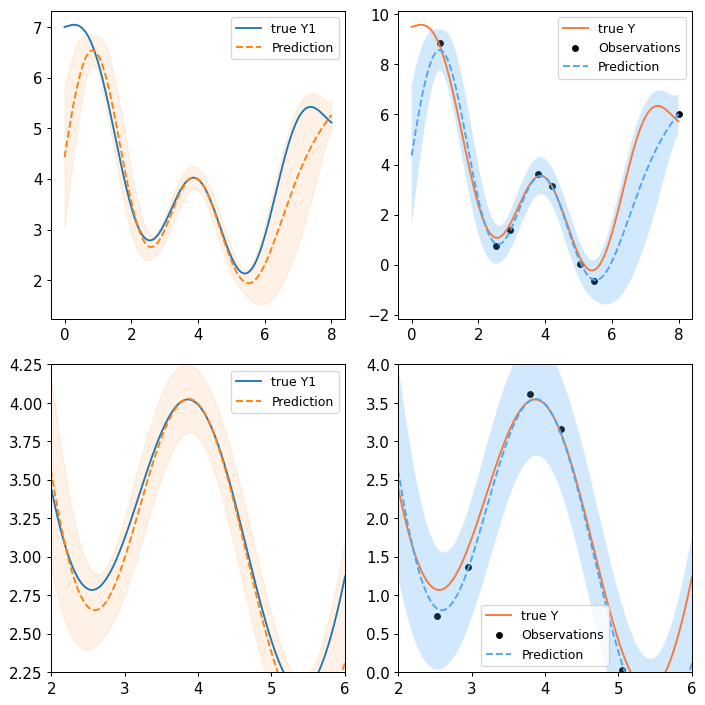

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


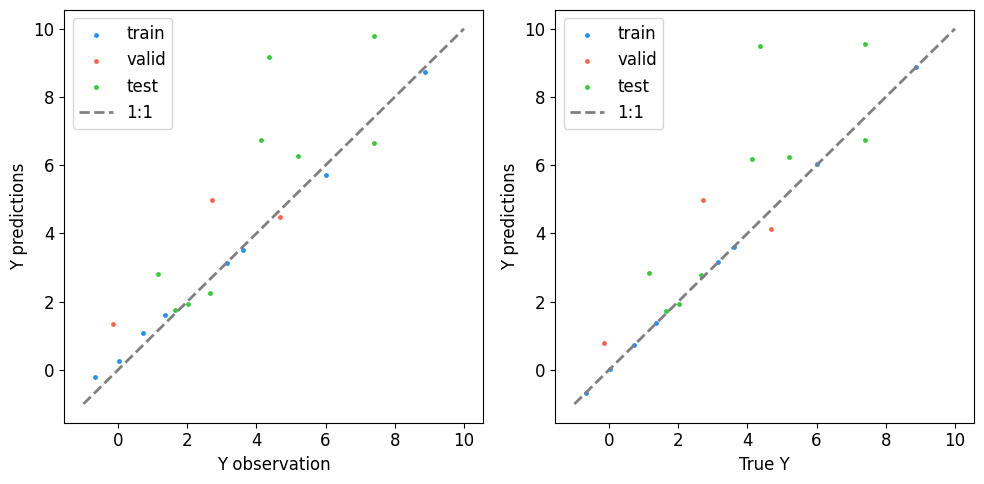



Setting up the dummy function and its latent function using nb_samples = 70 ...
Splitting 56.00000000000001% of 70 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27794
Test RMSE of observed values: 0.49482
Train RMSE of observed true values: 0.27794
Test RMSE of observed true values: 0.43687
Train RMSE of observed values: 0.08773
Test RMSE of latent function: 0.21844
Plotting results ...


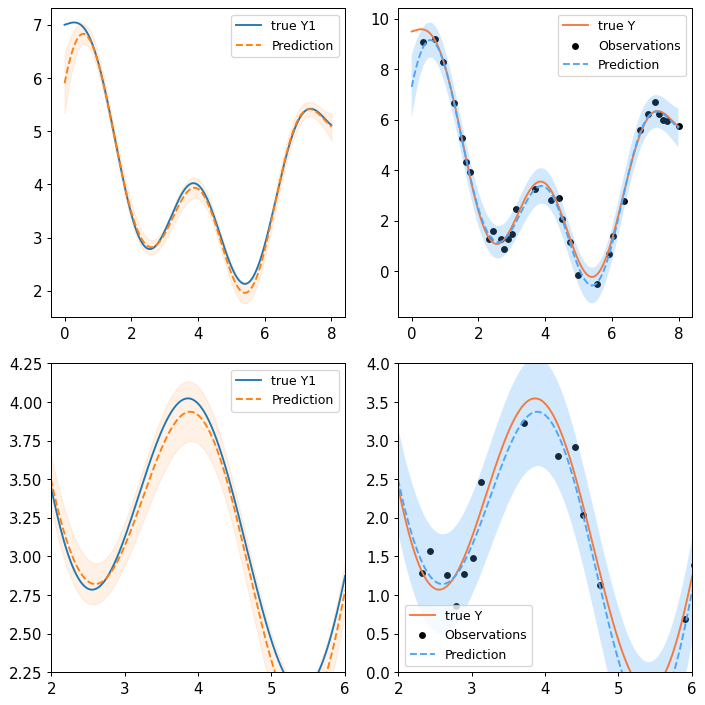

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


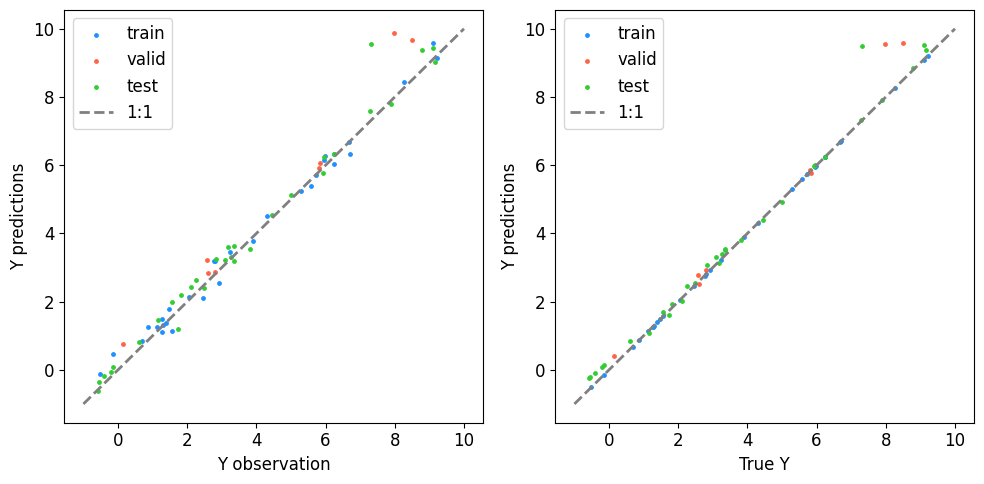



Setting up the dummy function and its latent function using nb_samples = 120 ...
Splitting 56.00000000000001% of 120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.27941
Test RMSE of observed values: 0.31996
Train RMSE of observed true values: 0.27941
Test RMSE of observed true values: 0.13895
Train RMSE of observed values: 0.06764
Test RMSE of latent function: 0.06948
Plotting results ...


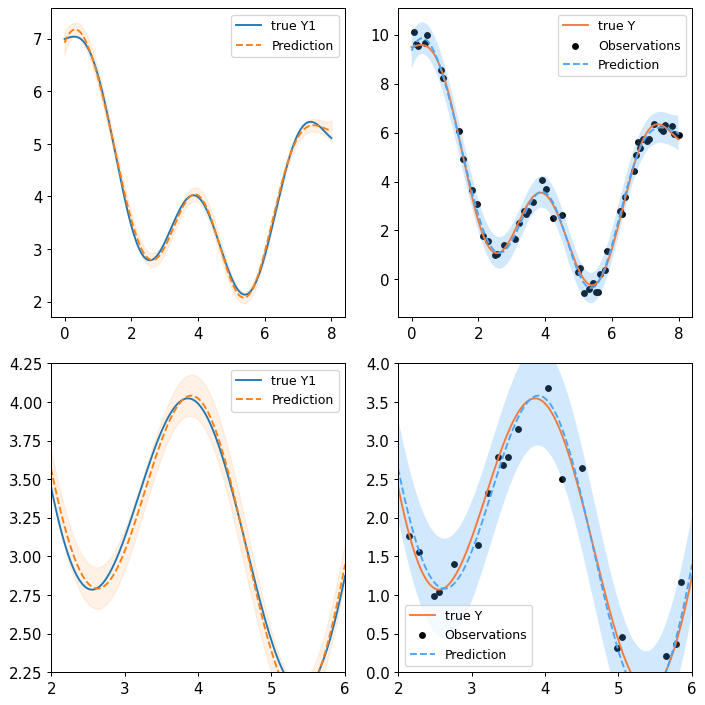

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


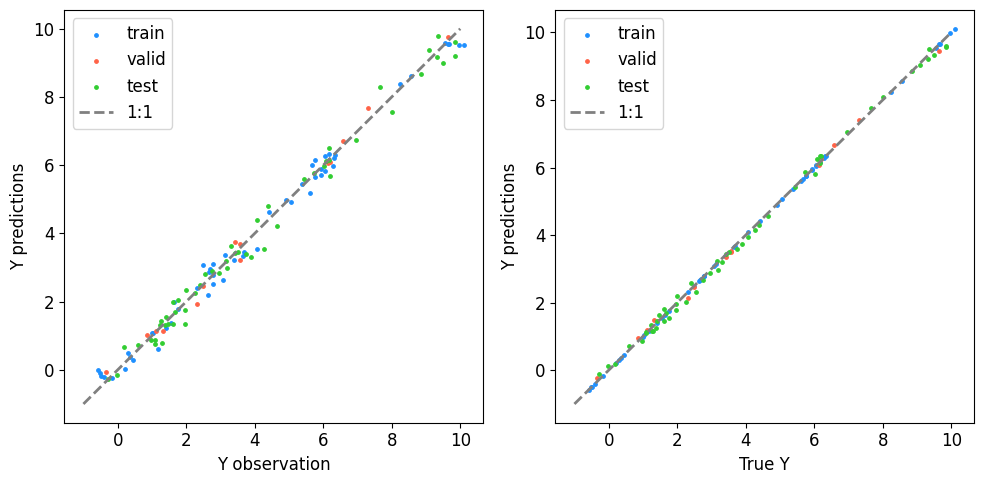



Setting up the dummy function and its latent function using nb_samples = 170 ...
Splitting 56.00000000000001% of 170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.32876
Test RMSE of observed values: 0.34907
Train RMSE of observed true values: 0.32876
Test RMSE of observed true values: 0.08754
Train RMSE of observed values: 0.04356
Test RMSE of latent function: 0.04377
Plotting results ...


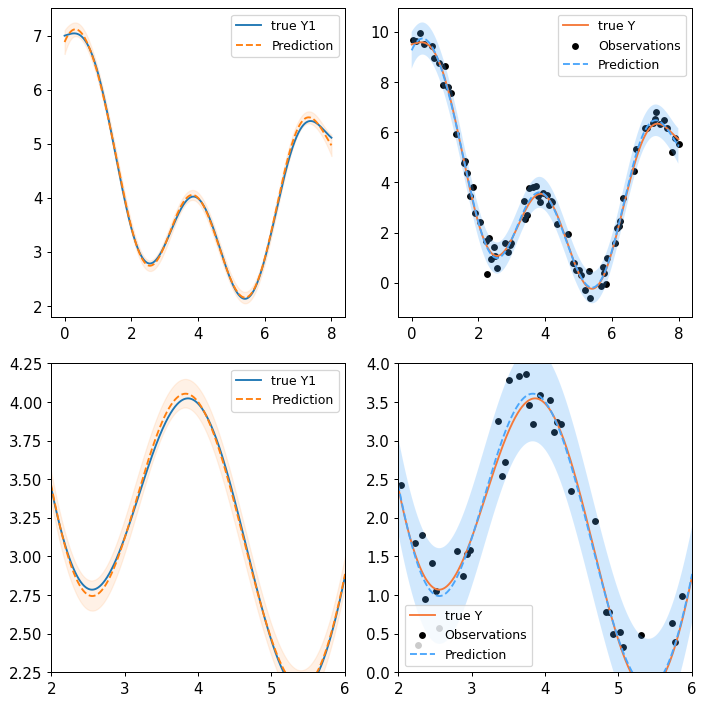

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


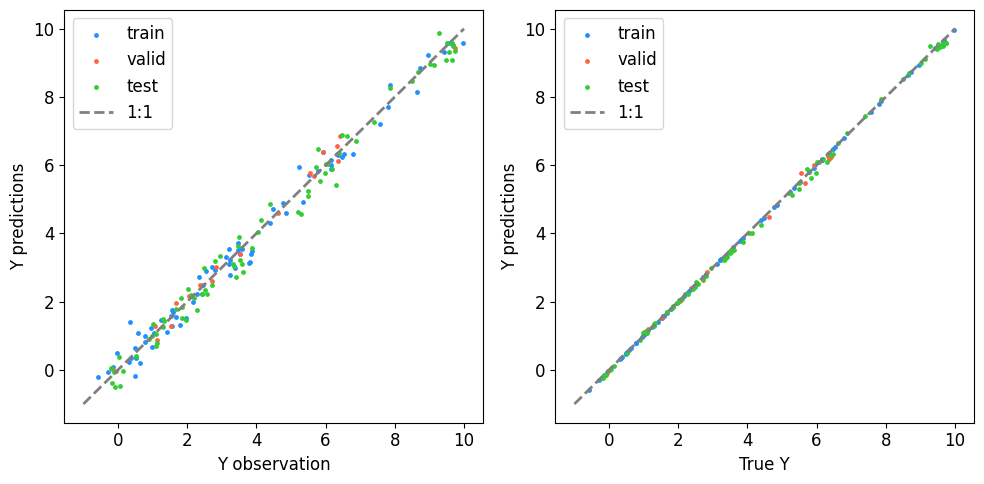



Setting up the dummy function and its latent function using nb_samples = 220 ...
Splitting 56.00000000000001% of 220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.25755
Test RMSE of observed values: 0.30187
Train RMSE of observed true values: 0.25755
Test RMSE of observed true values: 0.10831
Train RMSE of observed values: 0.05255
Test RMSE of latent function: 0.05416
Plotting results ...


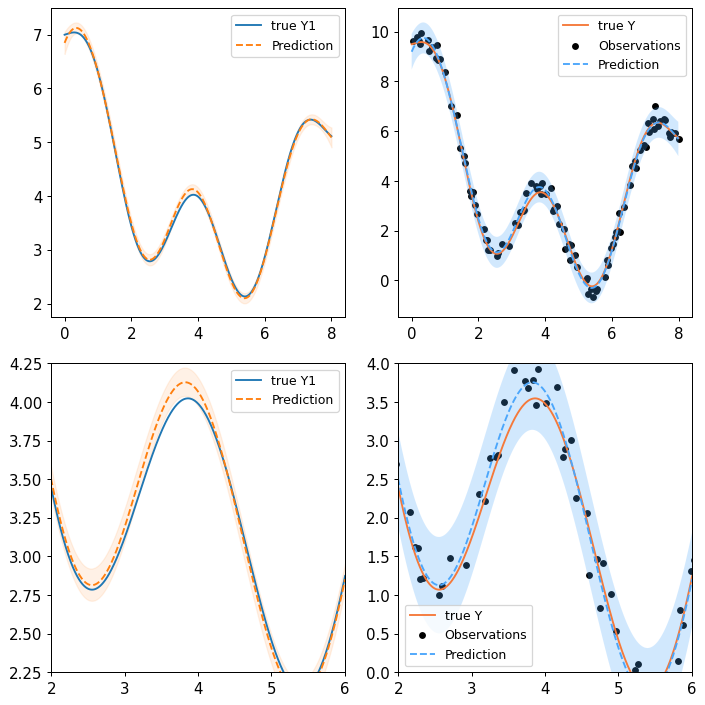

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


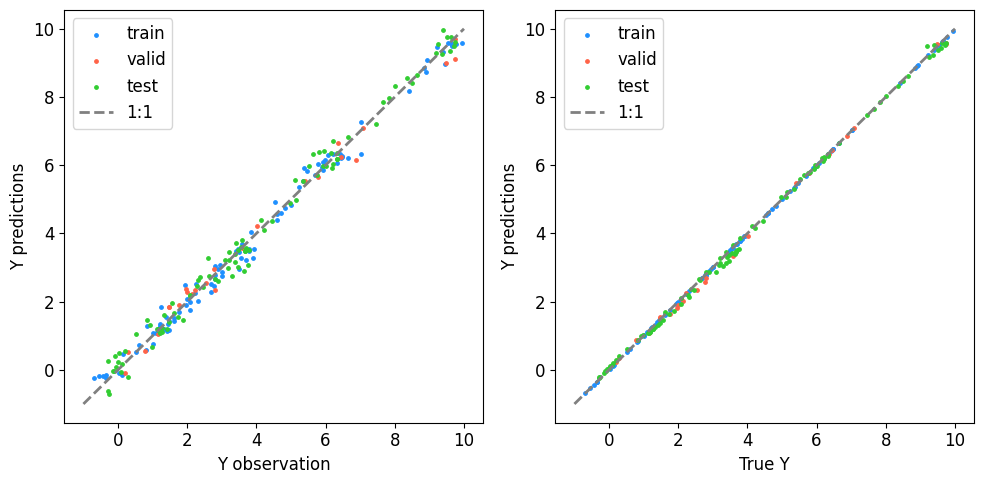



Setting up the dummy function and its latent function using nb_samples = 270 ...
Splitting 56.00000000000001% of 270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.34987
Test RMSE of observed values: 0.32908
Train RMSE of observed true values: 0.34987
Test RMSE of observed true values: 0.08722
Train RMSE of observed values: 0.04853
Test RMSE of latent function: 0.04361
Plotting results ...


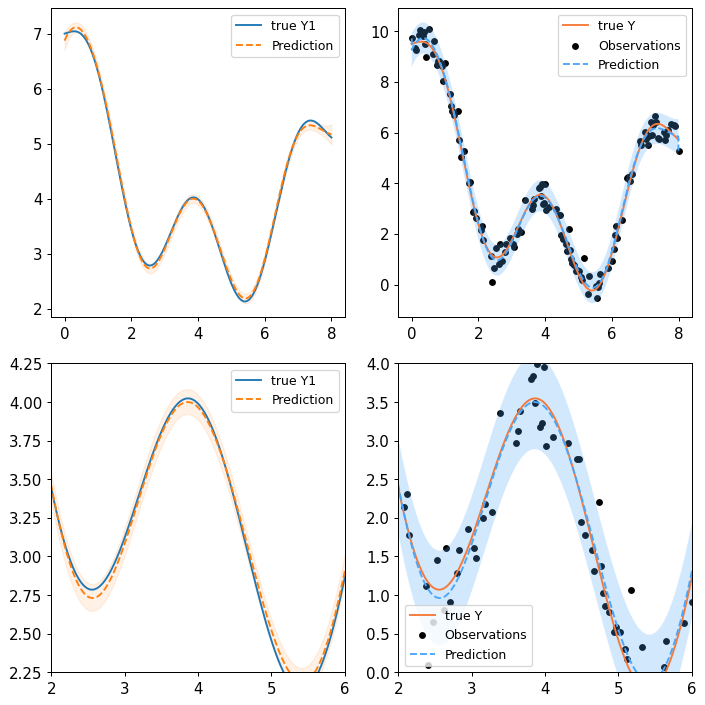

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


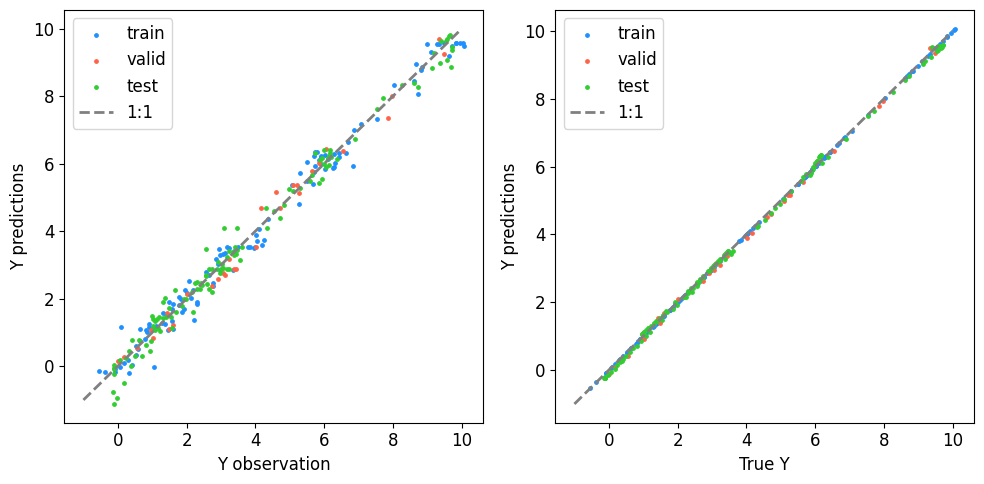



Setting up the dummy function and its latent function using nb_samples = 320 ...
Splitting 56.00000000000001% of 320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30484
Test RMSE of observed values: 0.30527
Train RMSE of observed true values: 0.30484
Test RMSE of observed true values: 0.08570
Train RMSE of observed values: 0.04100
Test RMSE of latent function: 0.04285
Plotting results ...


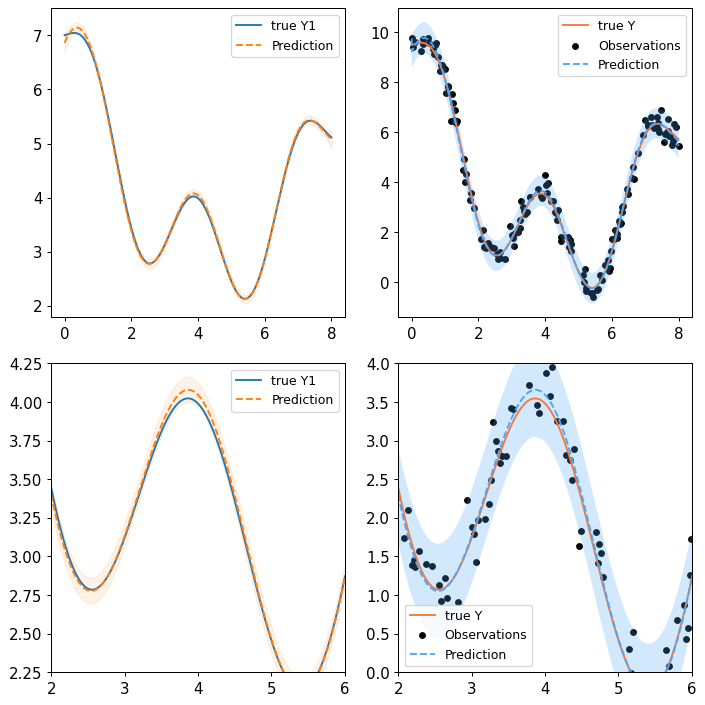

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


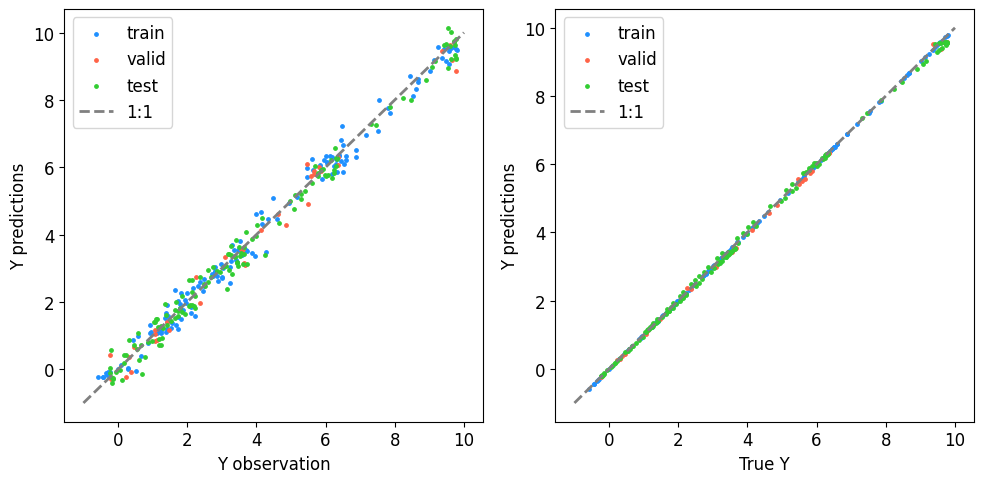



Setting up the dummy function and its latent function using nb_samples = 370 ...
Splitting 56.00000000000001% of 370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31063
Test RMSE of observed values: 0.30585
Train RMSE of observed true values: 0.31063
Test RMSE of observed true values: 0.08972
Train RMSE of observed values: 0.04268
Test RMSE of latent function: 0.04486
Plotting results ...


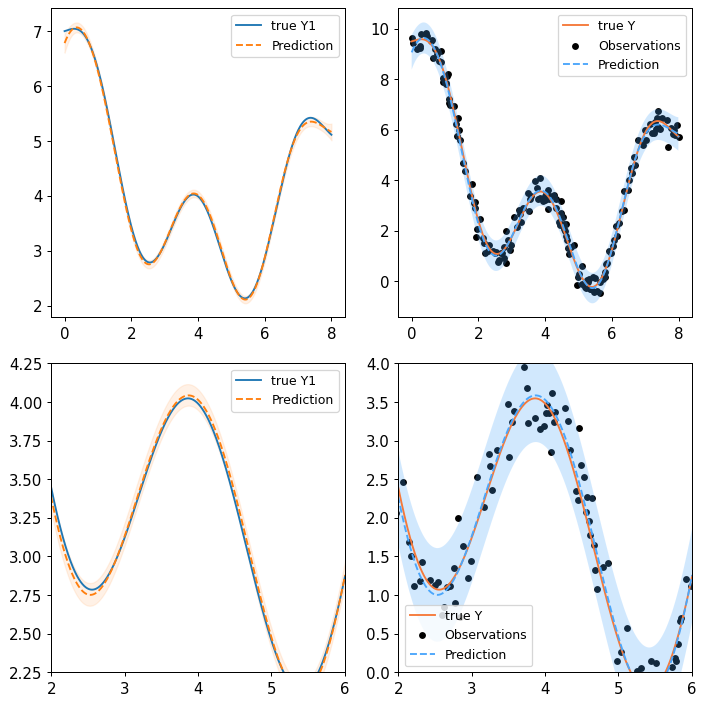

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


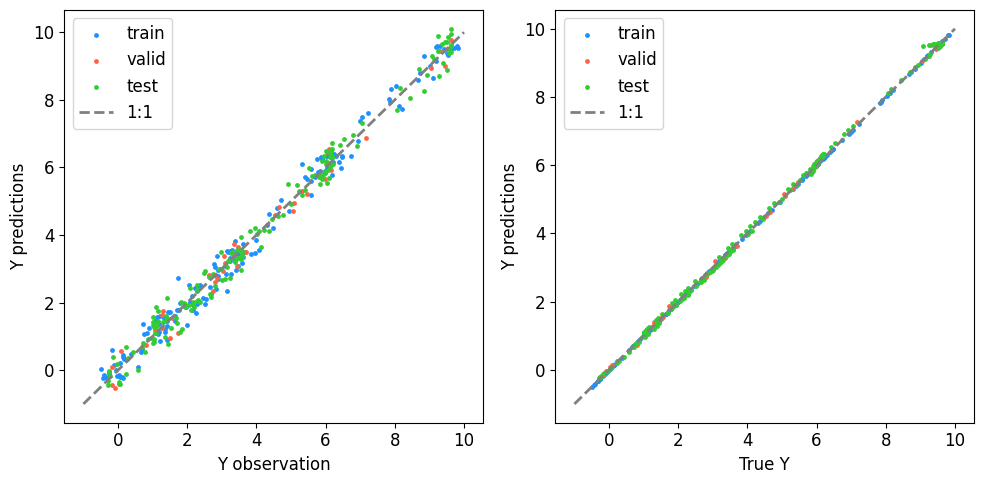



Setting up the dummy function and its latent function using nb_samples = 420 ...
Splitting 56.00000000000001% of 420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30635
Test RMSE of observed values: 0.32052
Train RMSE of observed true values: 0.30635
Test RMSE of observed true values: 0.10269
Train RMSE of observed values: 0.03984
Test RMSE of latent function: 0.05135
Plotting results ...


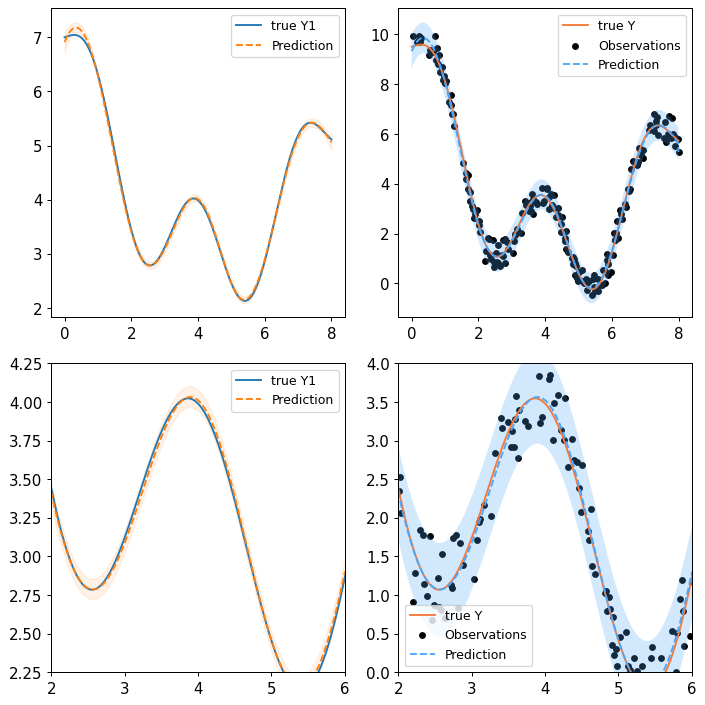

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


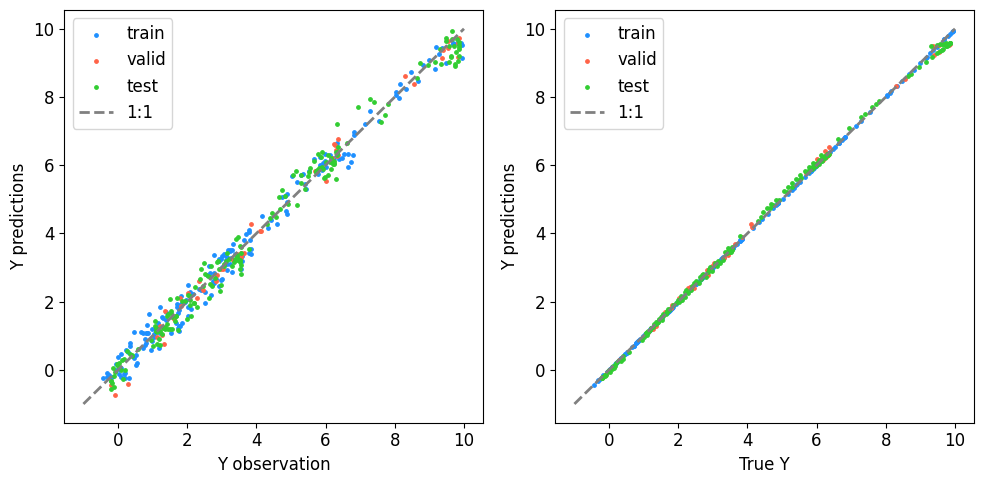



Setting up the dummy function and its latent function using nb_samples = 470 ...
Splitting 56.00000000000001% of 470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28856
Test RMSE of observed values: 0.31831
Train RMSE of observed true values: 0.28856
Test RMSE of observed true values: 0.05951
Train RMSE of observed values: 0.02784
Test RMSE of latent function: 0.02976
Plotting results ...


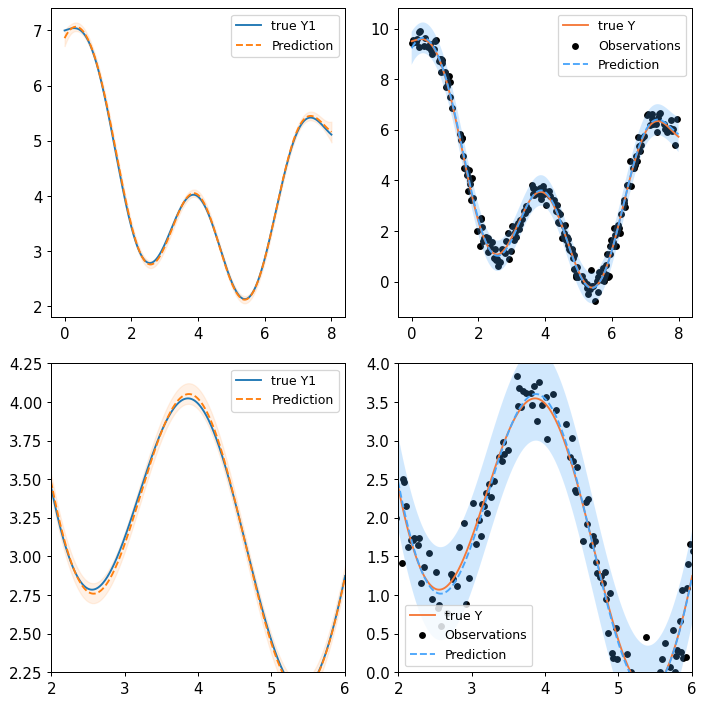

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


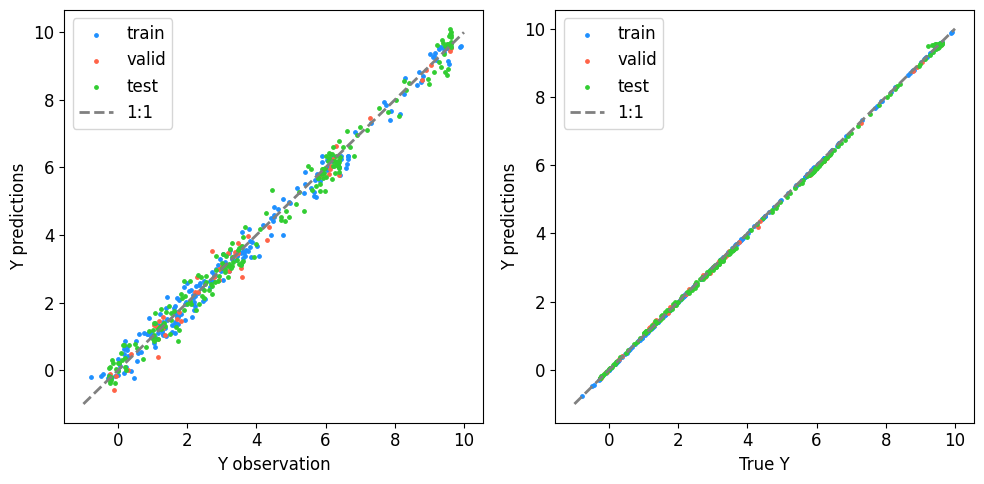



Setting up the dummy function and its latent function using nb_samples = 520 ...
Splitting 56.00000000000001% of 520 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28062
Test RMSE of observed values: 0.31961
Train RMSE of observed true values: 0.28062
Test RMSE of observed true values: 0.09375
Train RMSE of observed values: 0.03609
Test RMSE of latent function: 0.04687
Plotting results ...


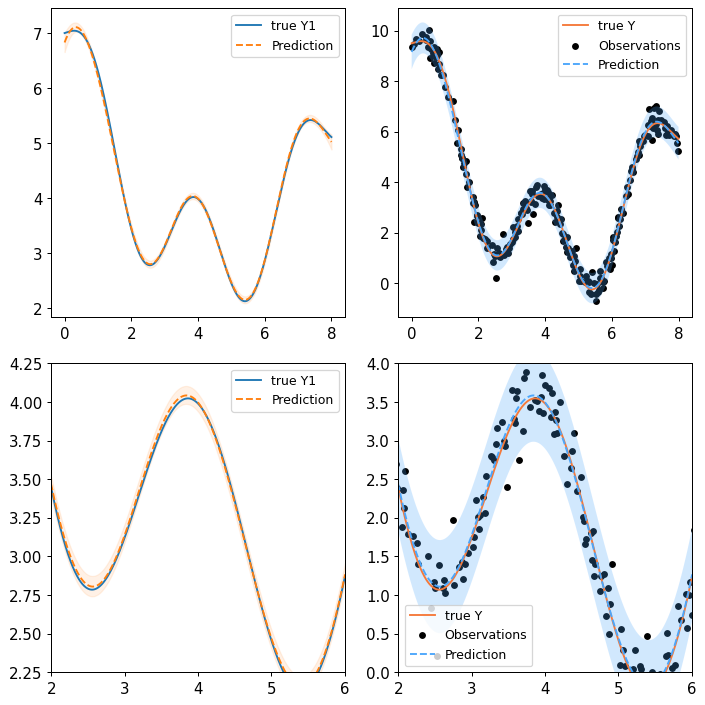

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


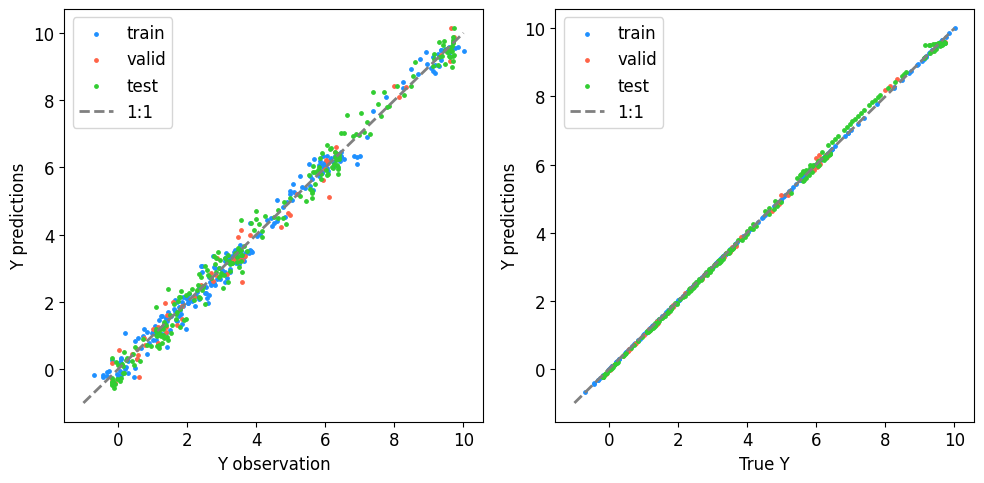



Setting up the dummy function and its latent function using nb_samples = 570 ...
Splitting 56.00000000000001% of 570 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29415
Test RMSE of observed values: 0.31349
Train RMSE of observed true values: 0.29415
Test RMSE of observed true values: 0.07084
Train RMSE of observed values: 0.03188
Test RMSE of latent function: 0.03542
Plotting results ...


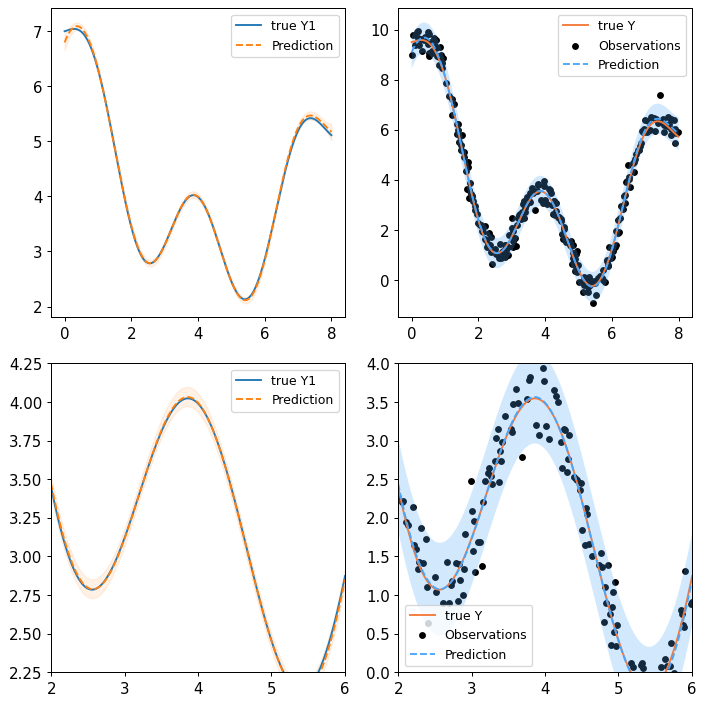

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


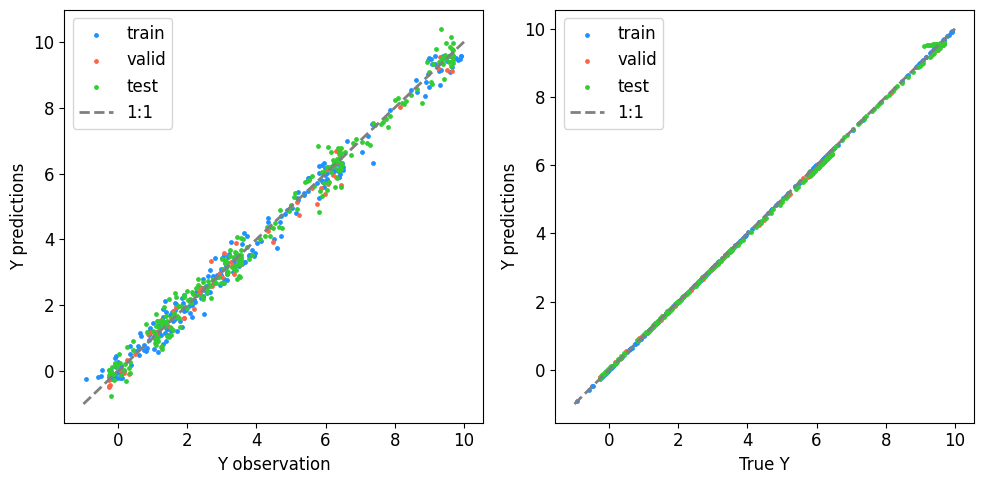



Setting up the dummy function and its latent function using nb_samples = 620 ...
Splitting 56.00000000000001% of 620 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30326
Test RMSE of observed values: 0.31432
Train RMSE of observed true values: 0.30326
Test RMSE of observed true values: 0.06703
Train RMSE of observed values: 0.02585
Test RMSE of latent function: 0.03352
Plotting results ...


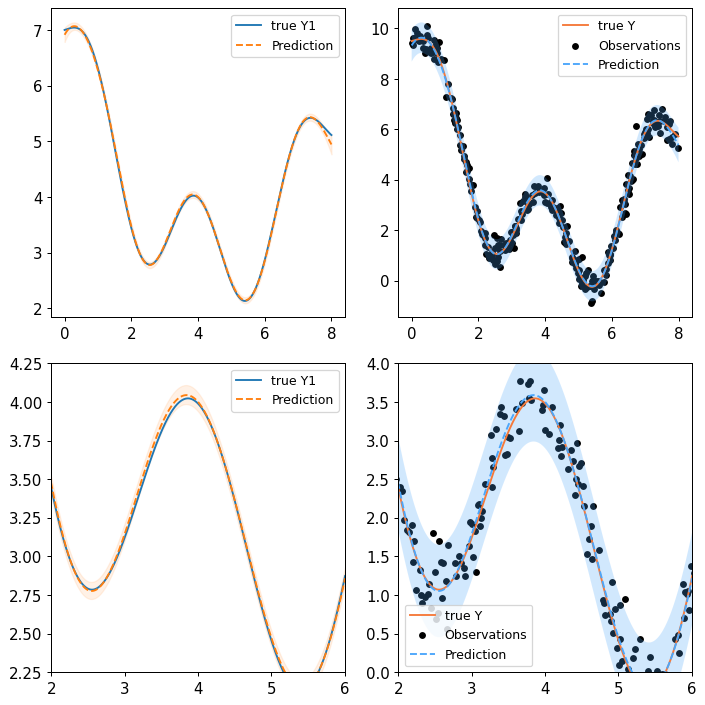

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


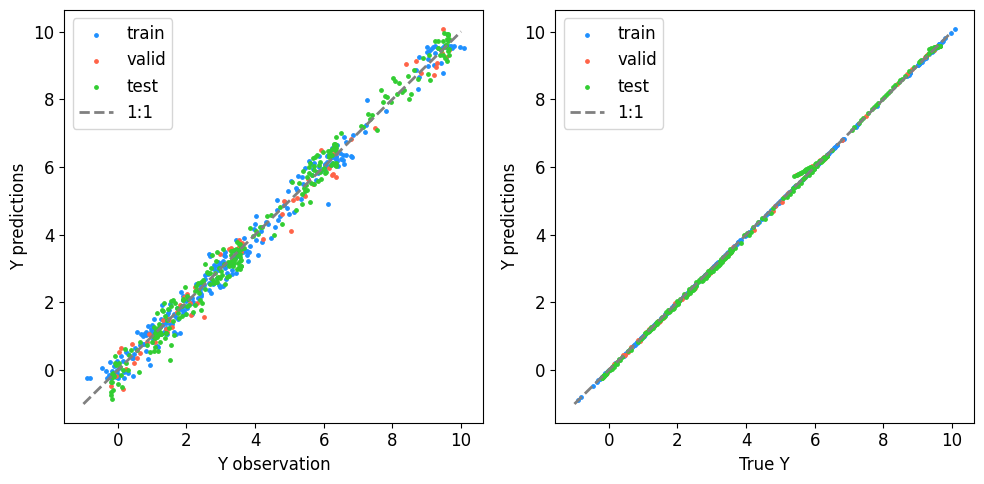



Setting up the dummy function and its latent function using nb_samples = 670 ...
Splitting 56.00000000000001% of 670 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29383
Test RMSE of observed values: 0.31714
Train RMSE of observed true values: 0.29383
Test RMSE of observed true values: 0.06743
Train RMSE of observed values: 0.03351
Test RMSE of latent function: 0.03372
Plotting results ...


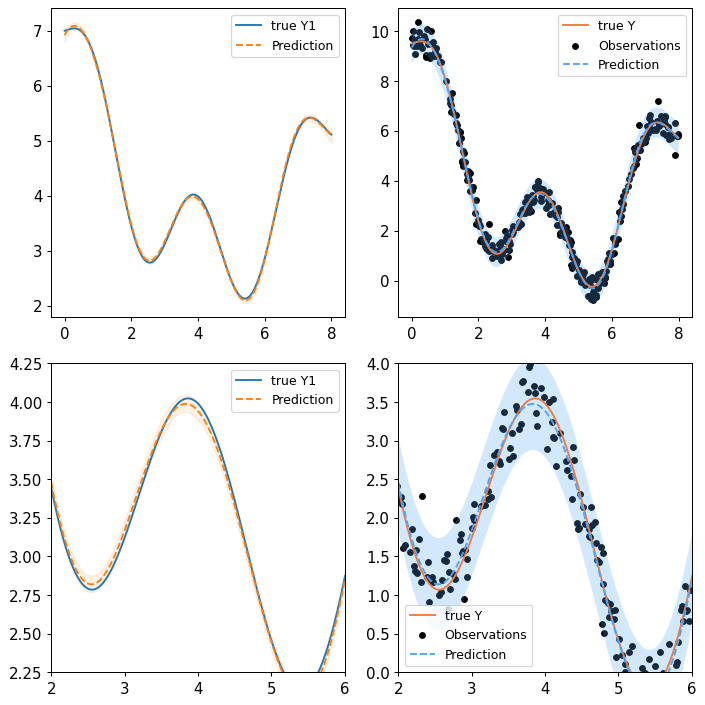

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


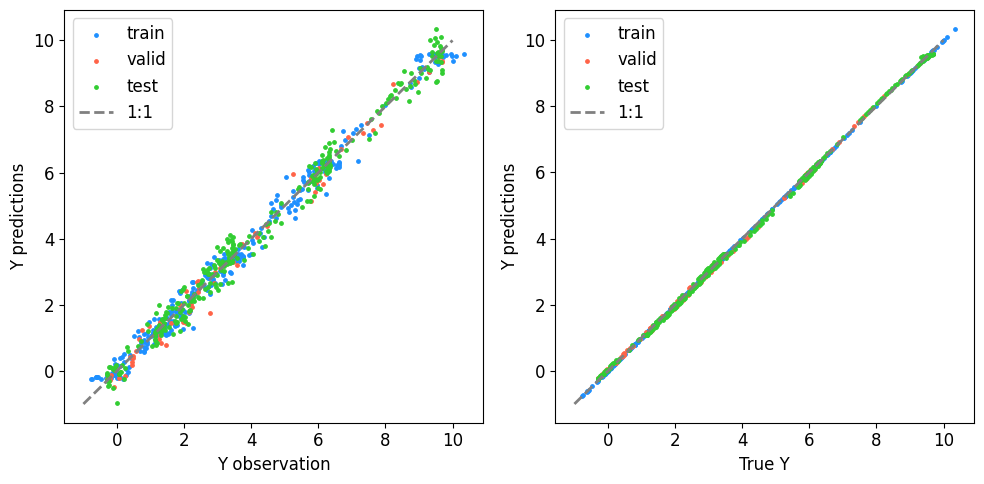



Setting up the dummy function and its latent function using nb_samples = 720 ...
Splitting 56.00000000000001% of 720 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30268
Test RMSE of observed values: 0.30150
Train RMSE of observed true values: 0.30268
Test RMSE of observed true values: 0.05068
Train RMSE of observed values: 0.02222
Test RMSE of latent function: 0.02534
Plotting results ...


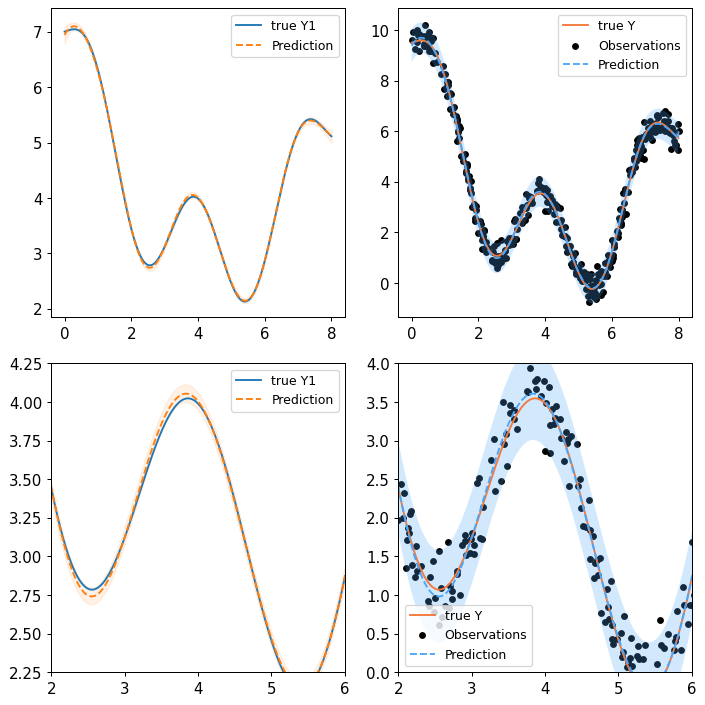

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


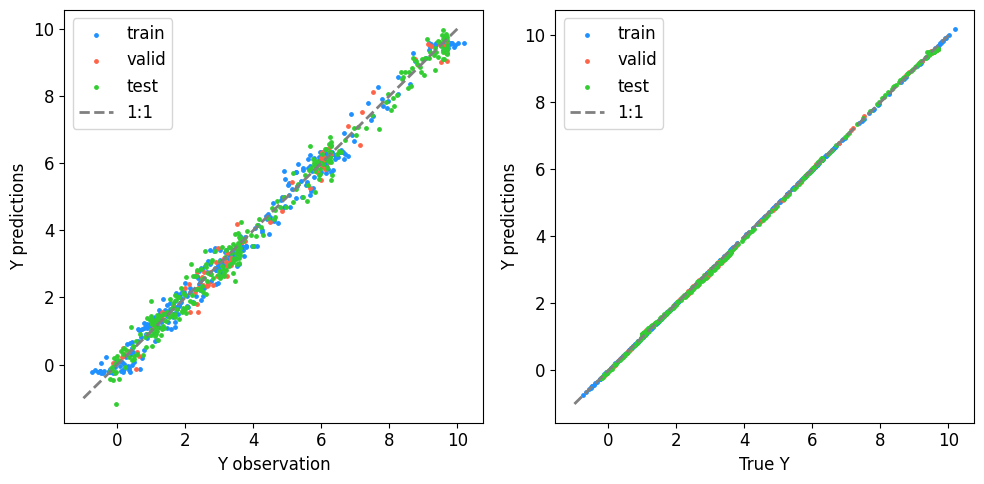



Setting up the dummy function and its latent function using nb_samples = 770 ...
Splitting 56.00000000000001% of 770 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28004
Test RMSE of observed values: 0.30640
Train RMSE of observed true values: 0.28004
Test RMSE of observed true values: 0.07368
Train RMSE of observed values: 0.03481
Test RMSE of latent function: 0.03684
Plotting results ...


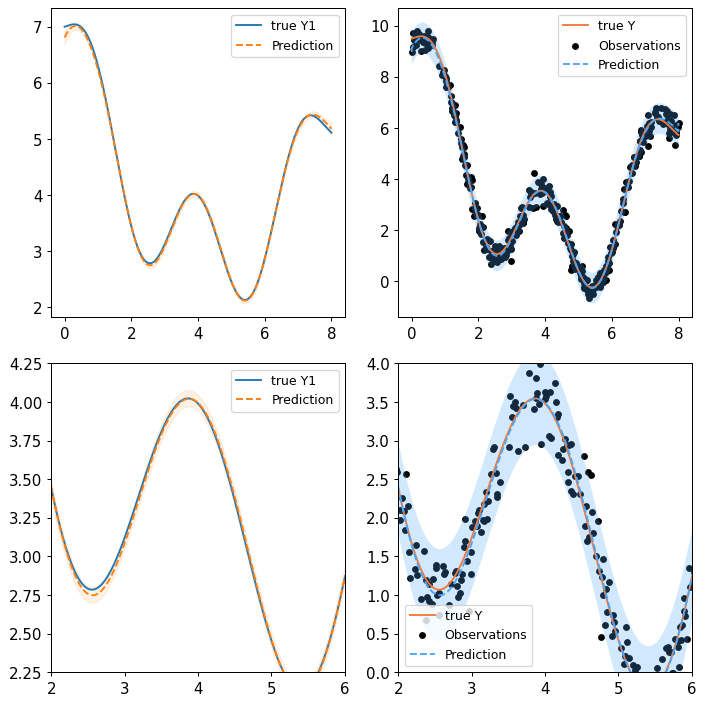

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


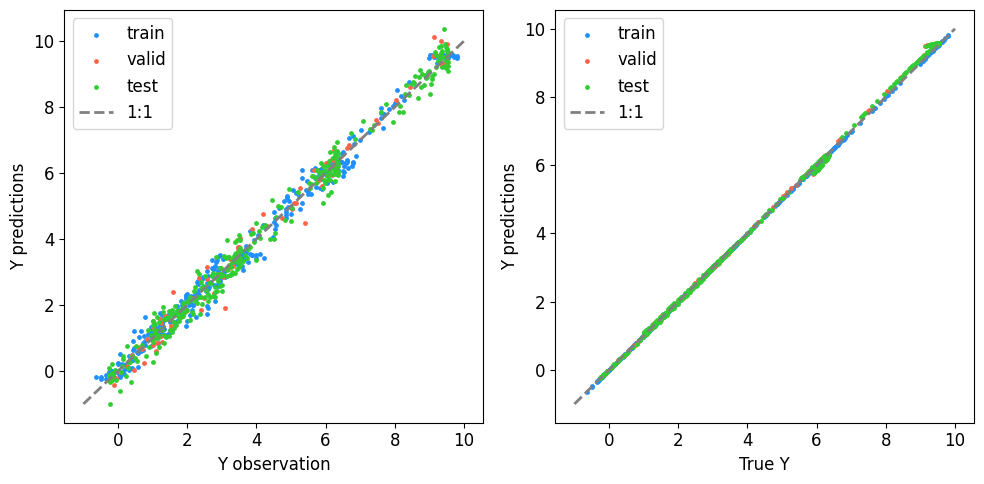



Setting up the dummy function and its latent function using nb_samples = 820 ...
Splitting 56.00000000000001% of 820 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30087
Test RMSE of observed values: 0.30291
Train RMSE of observed true values: 0.30087
Test RMSE of observed true values: 0.06726
Train RMSE of observed values: 0.02960
Test RMSE of latent function: 0.03363
Plotting results ...


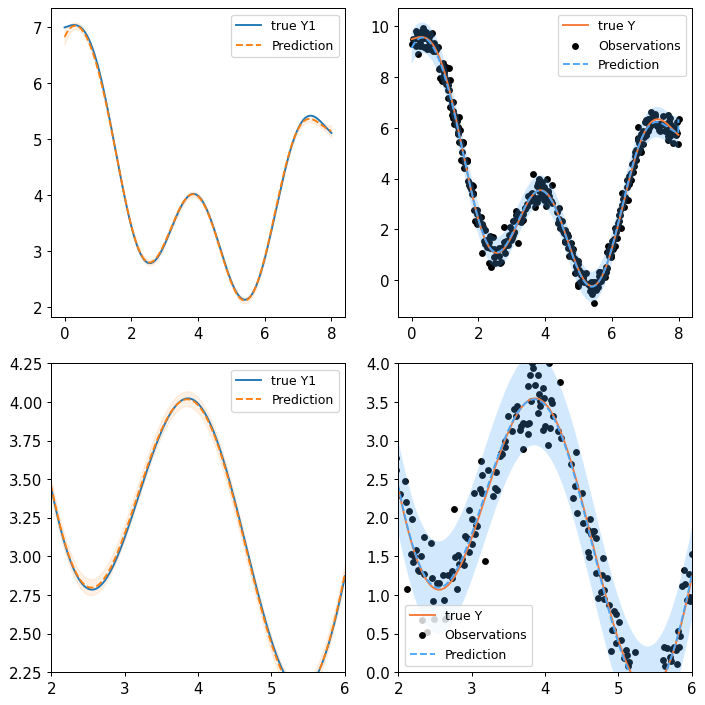

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


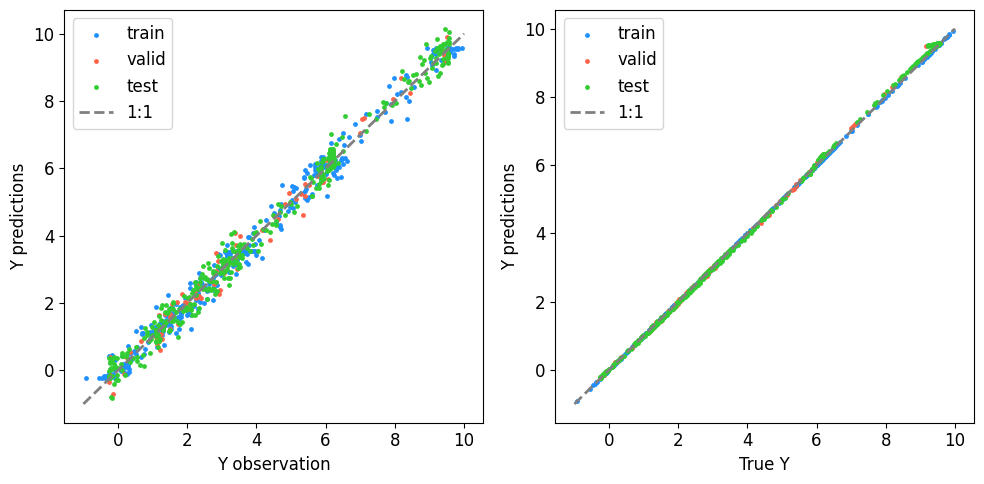



Setting up the dummy function and its latent function using nb_samples = 870 ...
Splitting 56.00000000000001% of 870 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29871
Test RMSE of observed values: 0.30672
Train RMSE of observed true values: 0.29871
Test RMSE of observed true values: 0.04492
Train RMSE of observed values: 0.02078
Test RMSE of latent function: 0.02246
Plotting results ...


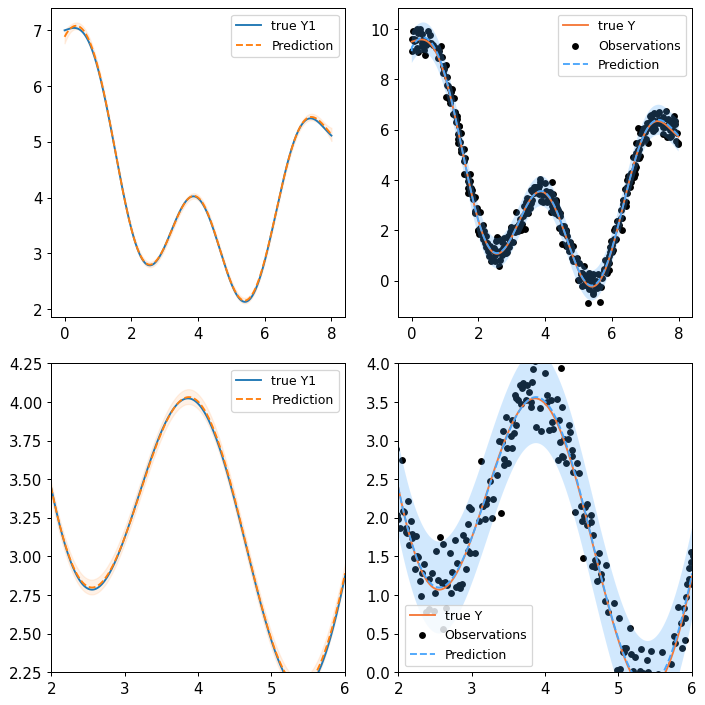

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


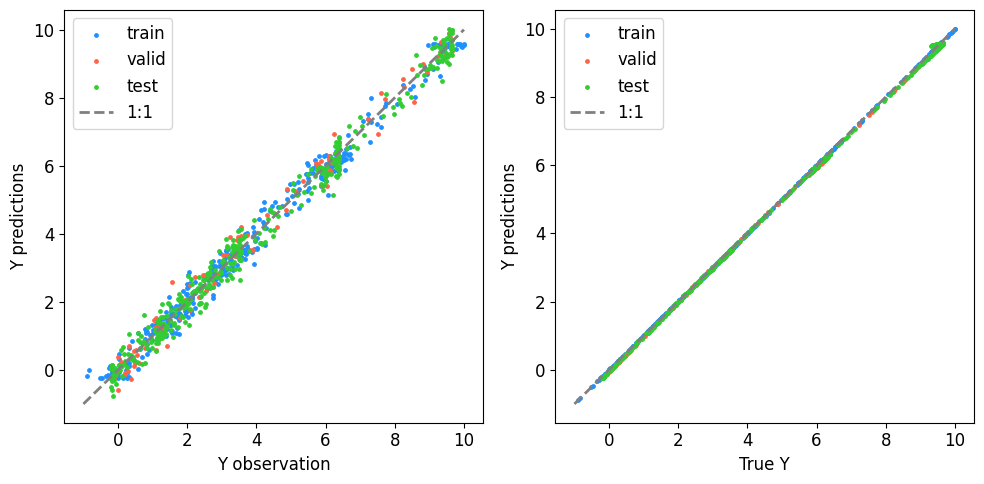



Setting up the dummy function and its latent function using nb_samples = 920 ...
Splitting 56.00000000000001% of 920 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29894
Test RMSE of observed values: 0.29748
Train RMSE of observed true values: 0.29894
Test RMSE of observed true values: 0.05791
Train RMSE of observed values: 0.02908
Test RMSE of latent function: 0.02895
Plotting results ...


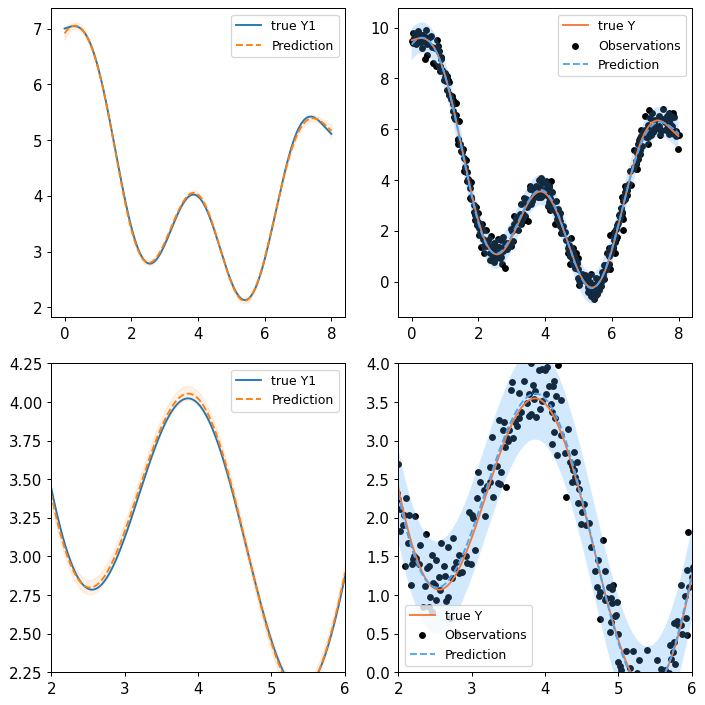

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


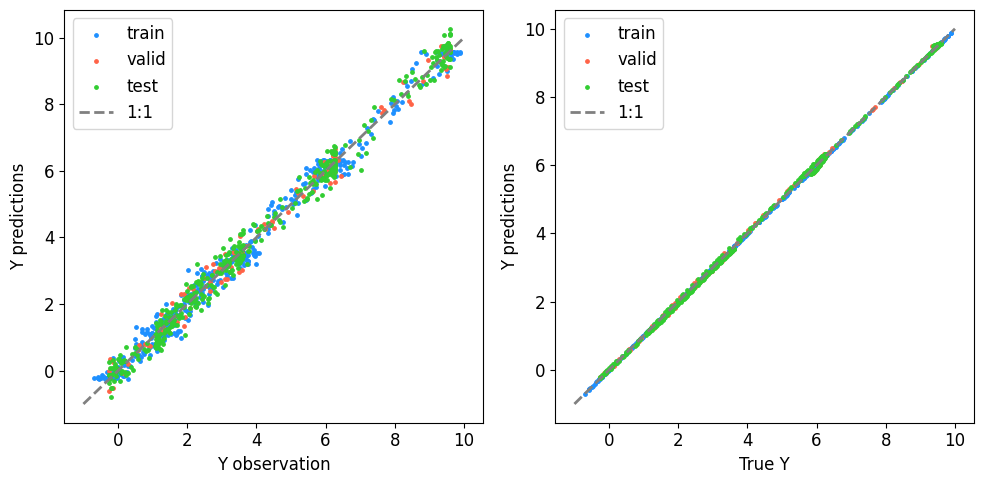



Setting up the dummy function and its latent function using nb_samples = 970 ...
Splitting 56.00000000000001% of 970 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29062
Test RMSE of observed values: 0.32697
Train RMSE of observed true values: 0.29062
Test RMSE of observed true values: 0.05435
Train RMSE of observed values: 0.02747
Test RMSE of latent function: 0.02717
Plotting results ...


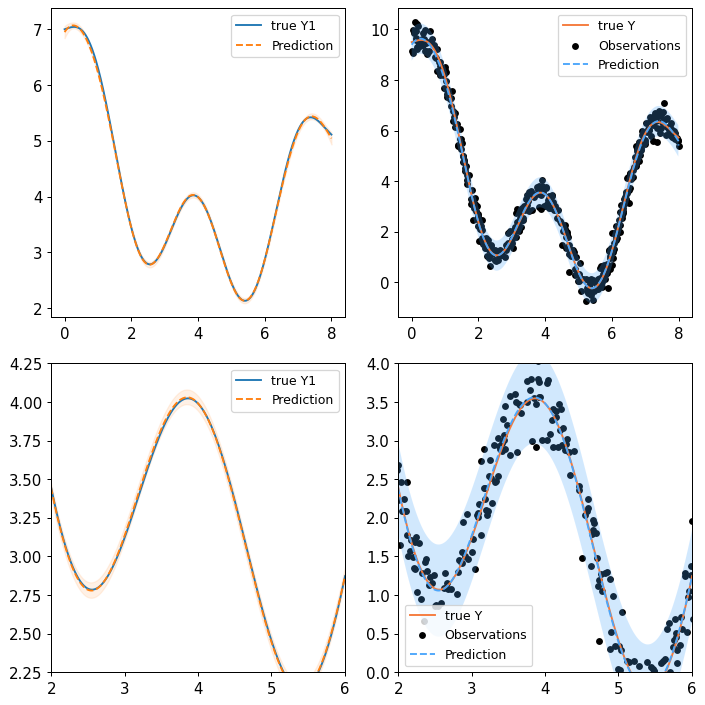

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


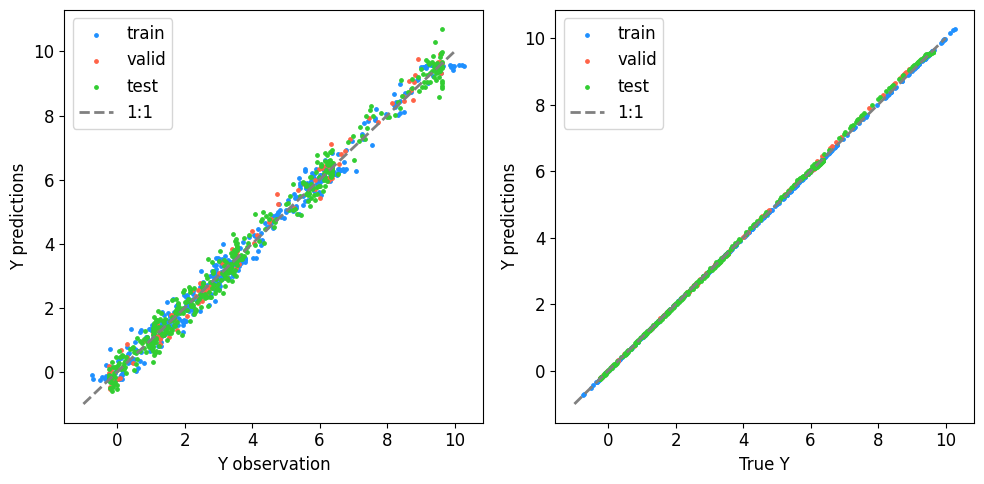



Setting up the dummy function and its latent function using nb_samples = 1020 ...
Splitting 56.00000000000001% of 1020 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31278
Test RMSE of observed values: 0.31530
Train RMSE of observed true values: 0.31278
Test RMSE of observed true values: 0.07123
Train RMSE of observed values: 0.03186
Test RMSE of latent function: 0.03561
Plotting results ...


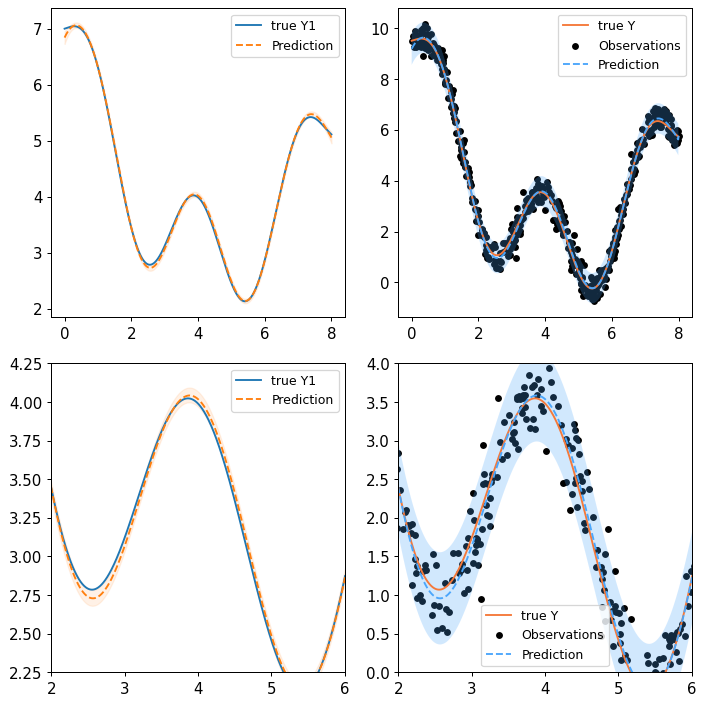

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


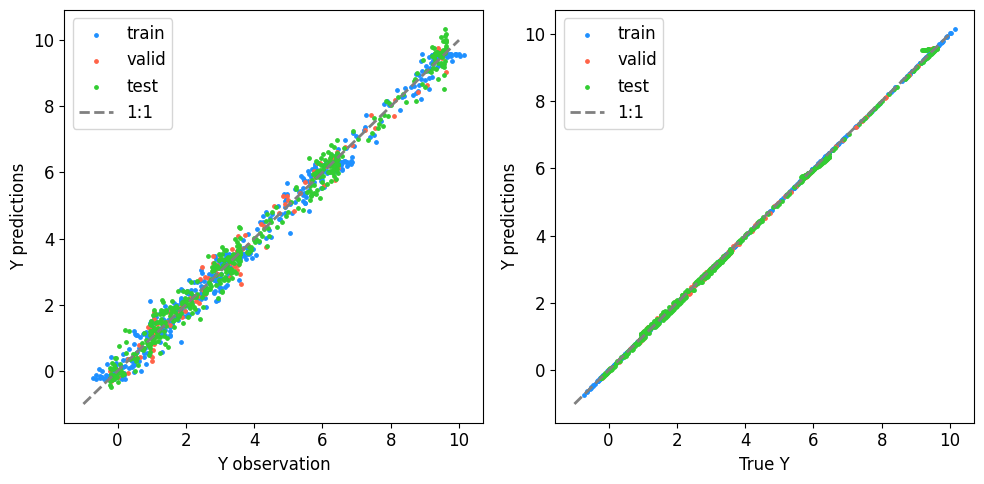



Setting up the dummy function and its latent function using nb_samples = 1070 ...
Splitting 56.00000000000001% of 1070 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31804
Test RMSE of observed values: 0.31305
Train RMSE of observed true values: 0.31804
Test RMSE of observed true values: 0.07723
Train RMSE of observed values: 0.03524
Test RMSE of latent function: 0.03861
Plotting results ...


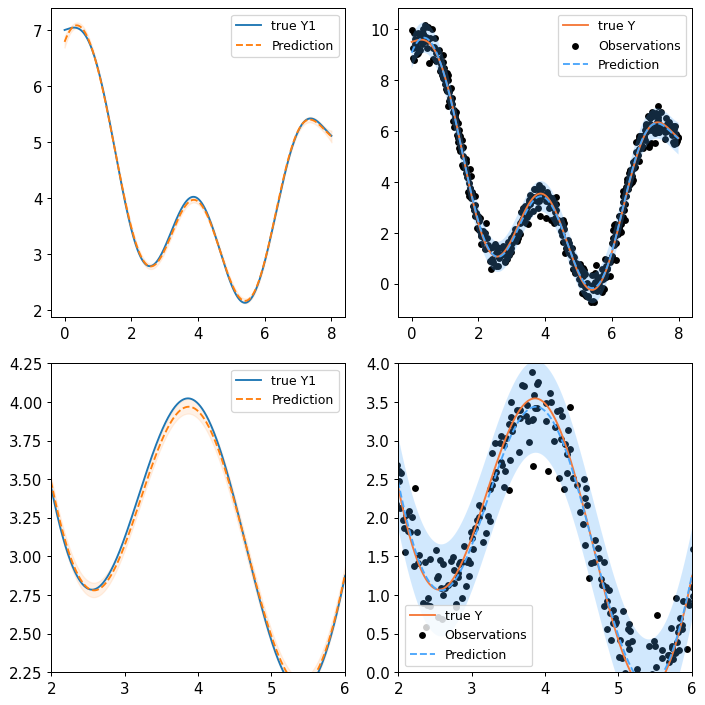

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


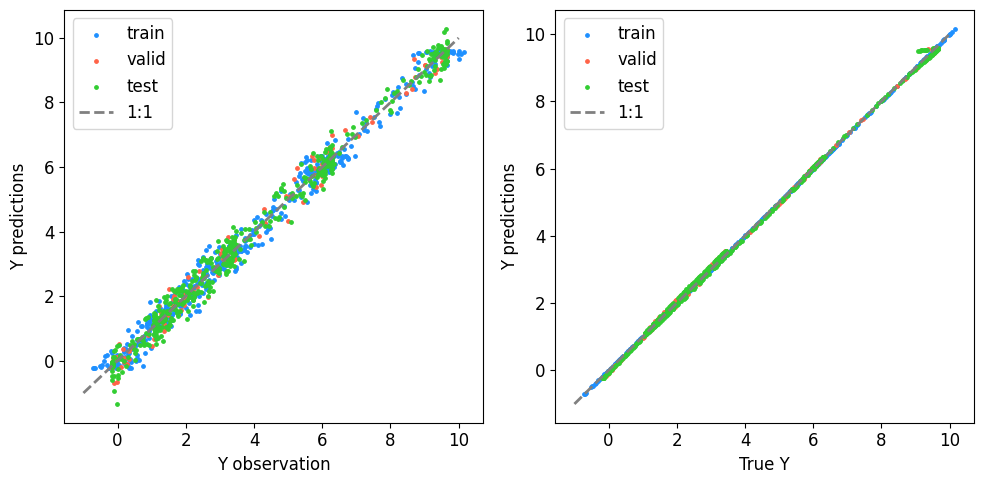



Setting up the dummy function and its latent function using nb_samples = 1120 ...
Splitting 56.00000000000001% of 1120 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29394
Test RMSE of observed values: 0.31080
Train RMSE of observed true values: 0.29394
Test RMSE of observed true values: 0.04153
Train RMSE of observed values: 0.02145
Test RMSE of latent function: 0.02077
Plotting results ...


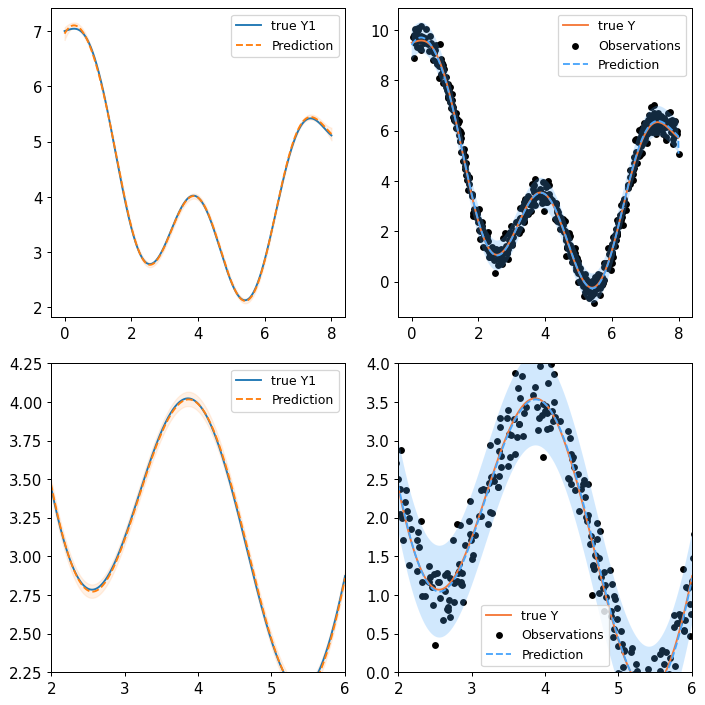

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


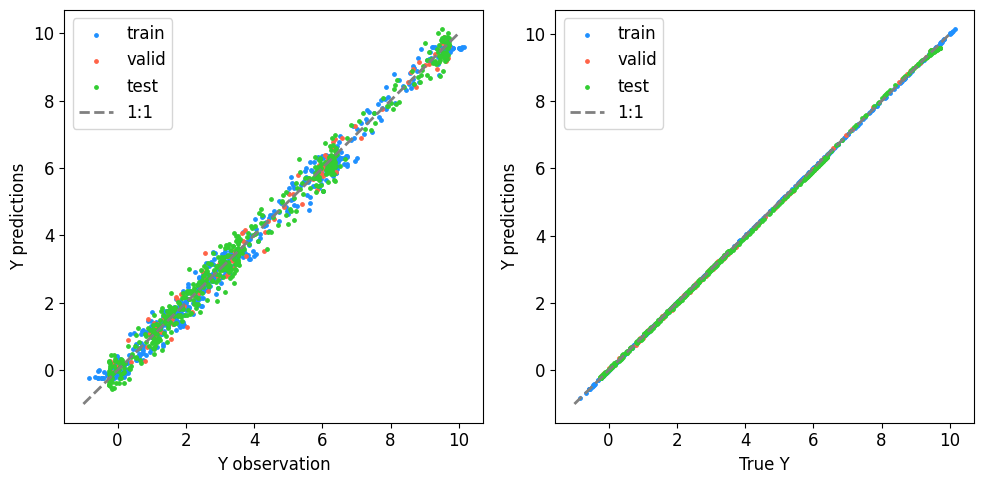



Setting up the dummy function and its latent function using nb_samples = 1170 ...
Splitting 56.00000000000001% of 1170 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30006
Test RMSE of observed values: 0.32150
Train RMSE of observed true values: 0.30006
Test RMSE of observed true values: 0.04537
Train RMSE of observed values: 0.02432
Test RMSE of latent function: 0.02268
Plotting results ...


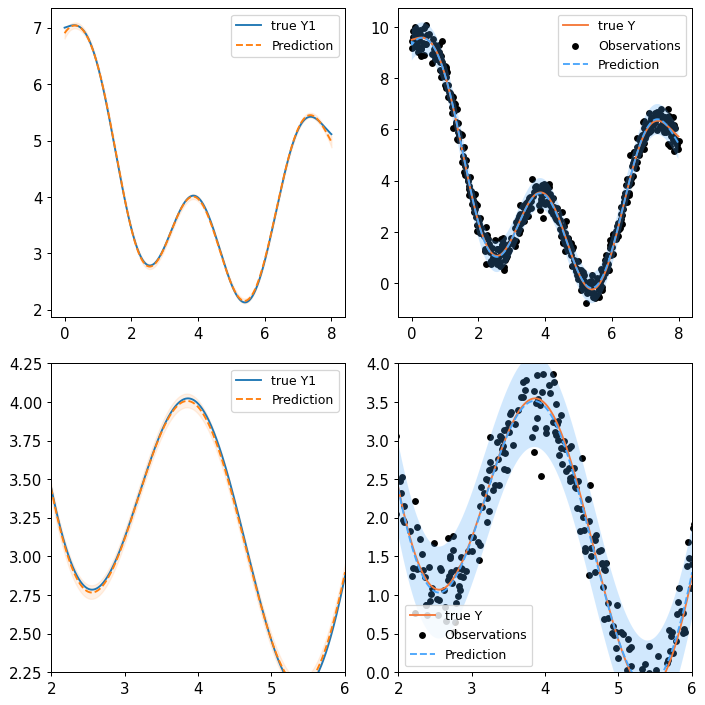

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


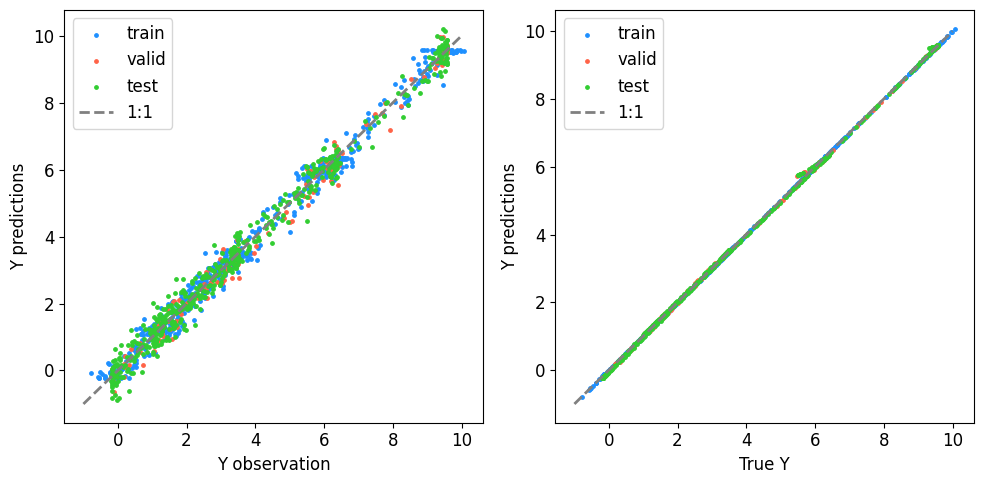



Setting up the dummy function and its latent function using nb_samples = 1220 ...
Splitting 56.00000000000001% of 1220 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31467
Test RMSE of observed values: 0.30716
Train RMSE of observed true values: 0.31467
Test RMSE of observed true values: 0.04581
Train RMSE of observed values: 0.02246
Test RMSE of latent function: 0.02290
Plotting results ...


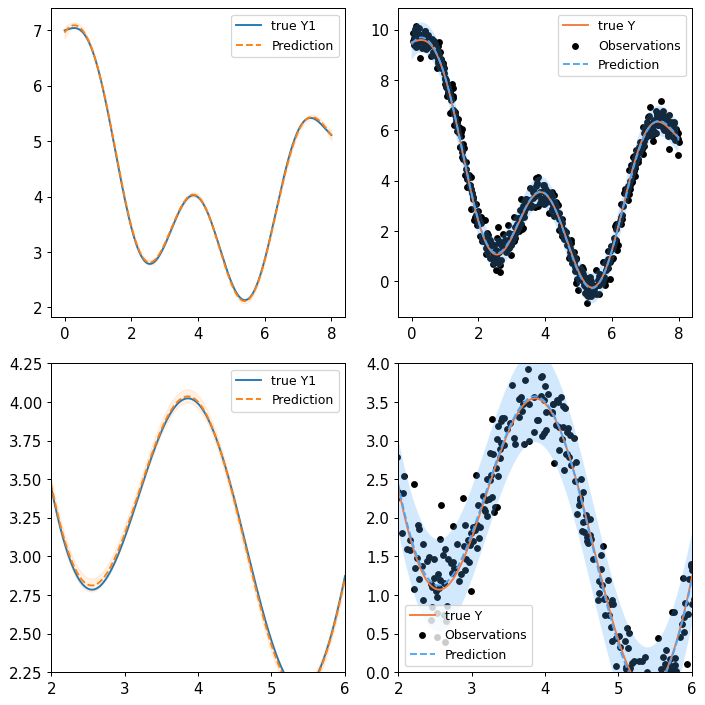

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


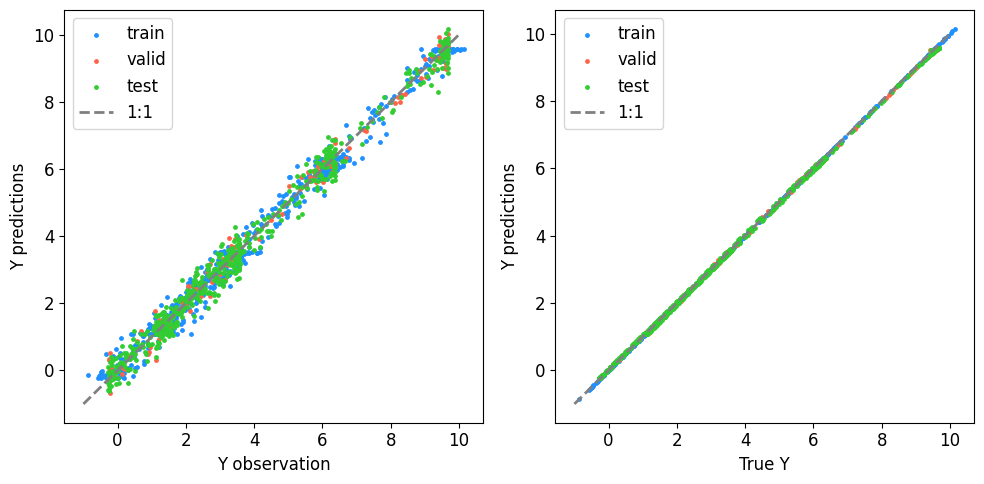



Setting up the dummy function and its latent function using nb_samples = 1270 ...
Splitting 56.00000000000001% of 1270 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.31142
Test RMSE of observed values: 0.30507
Train RMSE of observed true values: 0.31142
Test RMSE of observed true values: 0.04391
Train RMSE of observed values: 0.02250
Test RMSE of latent function: 0.02195
Plotting results ...


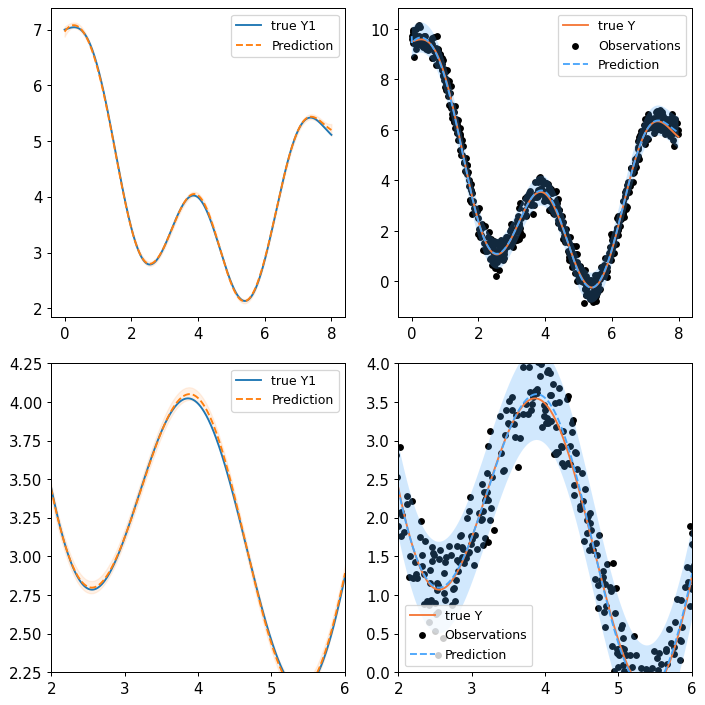

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


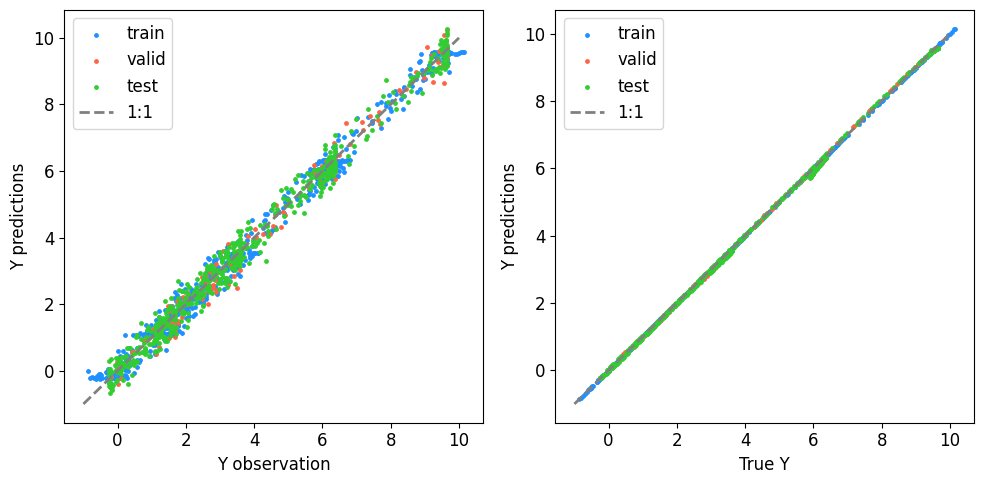



Setting up the dummy function and its latent function using nb_samples = 1320 ...
Splitting 56.00000000000001% of 1320 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.28603
Test RMSE of observed values: 0.29280
Train RMSE of observed true values: 0.28603
Test RMSE of observed true values: 0.04282
Train RMSE of observed values: 0.02237
Test RMSE of latent function: 0.02141
Plotting results ...


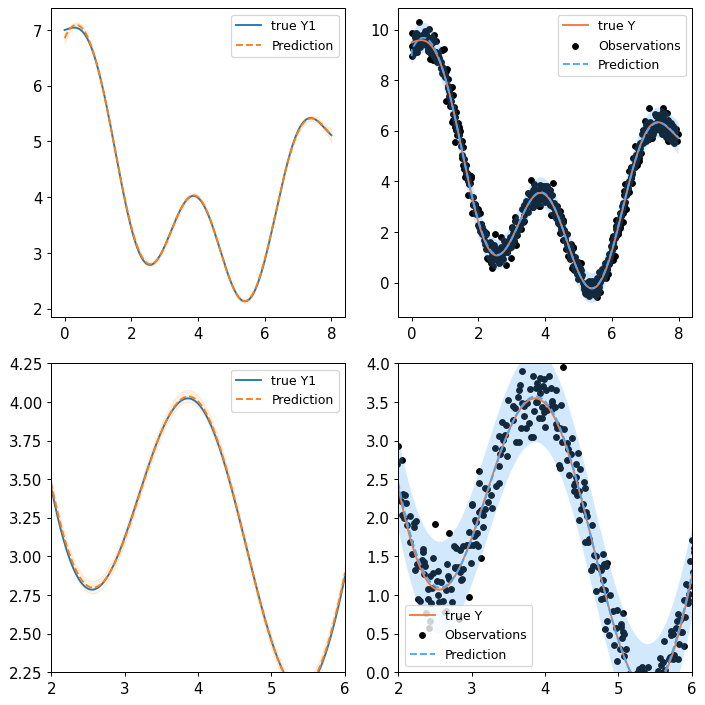

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


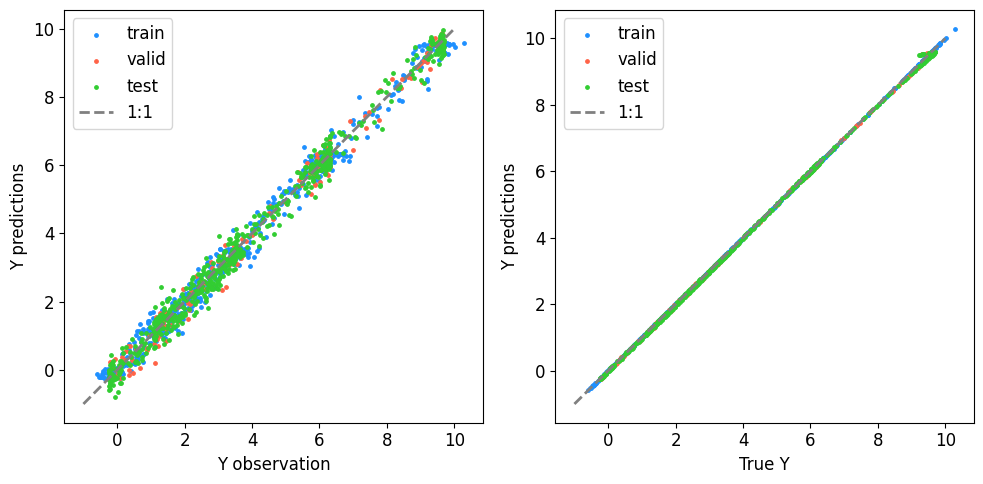



Setting up the dummy function and its latent function using nb_samples = 1370 ...
Splitting 56.00000000000001% of 1370 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29662
Test RMSE of observed values: 0.31329
Train RMSE of observed true values: 0.29662
Test RMSE of observed true values: 0.05354
Train RMSE of observed values: 0.02850
Test RMSE of latent function: 0.02677
Plotting results ...


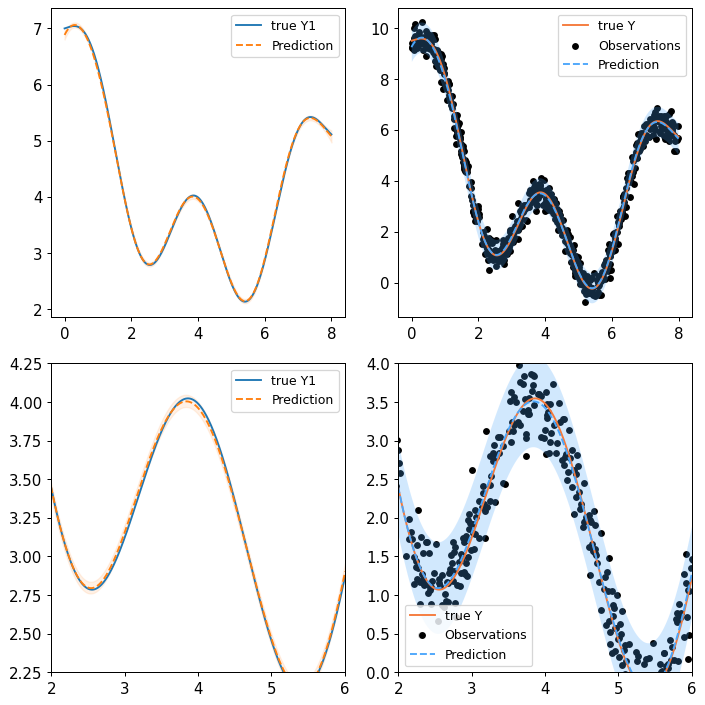

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


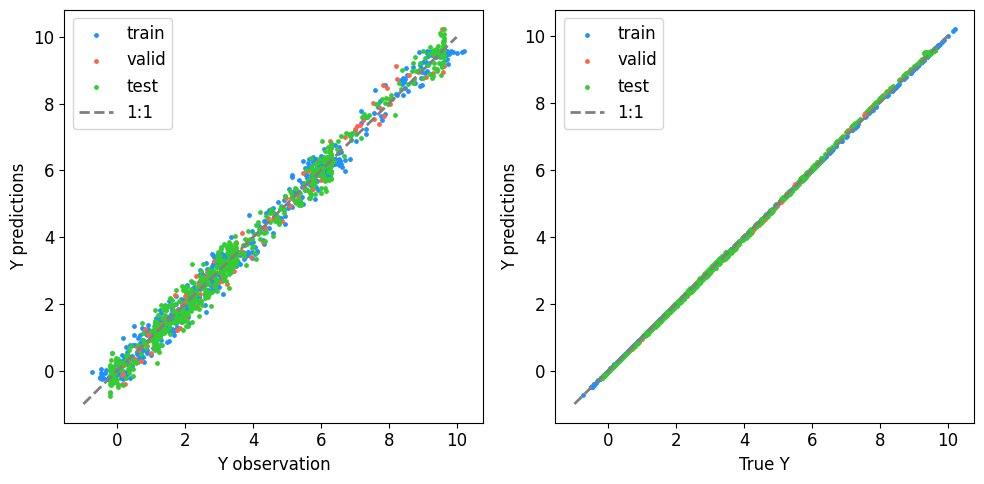



Setting up the dummy function and its latent function using nb_samples = 1420 ...
Splitting 56.00000000000001% of 1420 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29902
Test RMSE of observed values: 0.30628
Train RMSE of observed true values: 0.29902
Test RMSE of observed true values: 0.03812
Train RMSE of observed values: 0.02023
Test RMSE of latent function: 0.01906
Plotting results ...


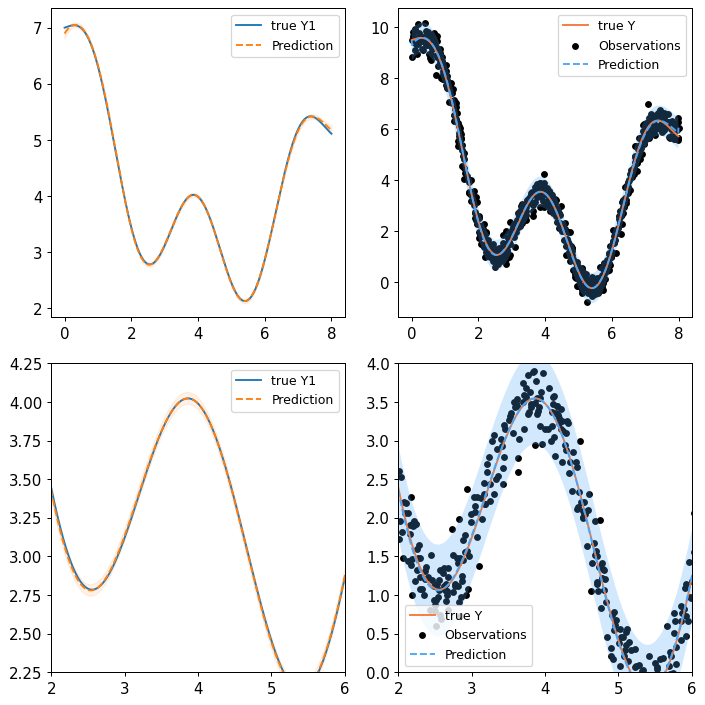

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


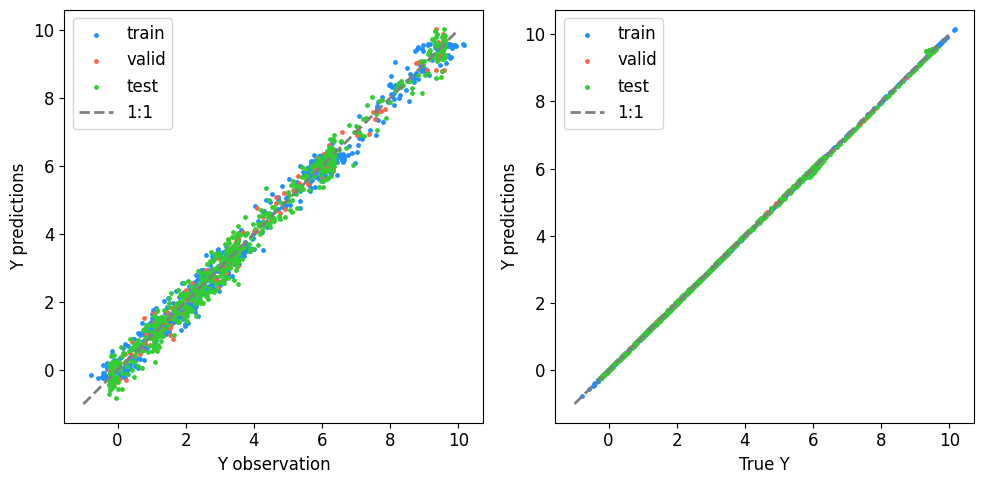



Setting up the dummy function and its latent function using nb_samples = 1470 ...
Splitting 56.00000000000001% of 1470 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.29559
Test RMSE of observed values: 0.30860
Train RMSE of observed true values: 0.29559
Test RMSE of observed true values: 0.05677
Train RMSE of observed values: 0.02616
Test RMSE of latent function: 0.02839
Plotting results ...


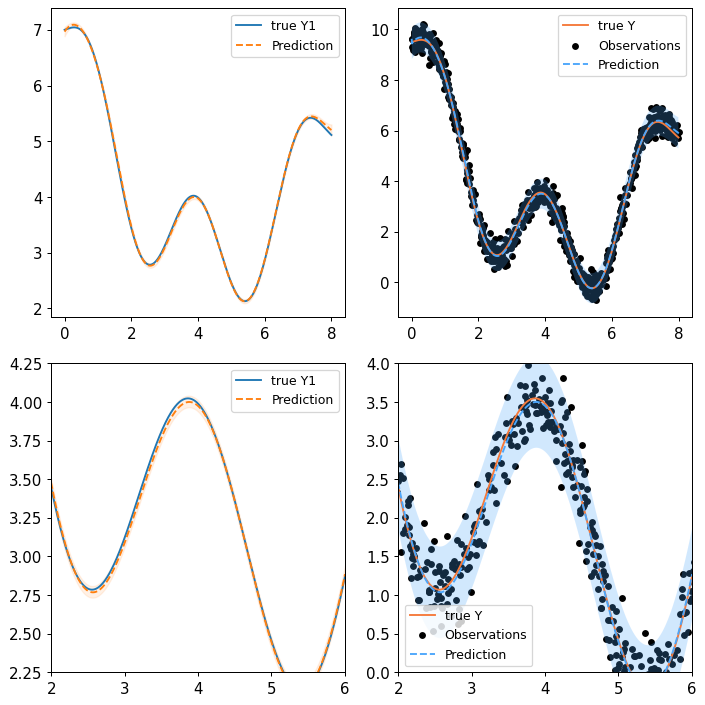

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


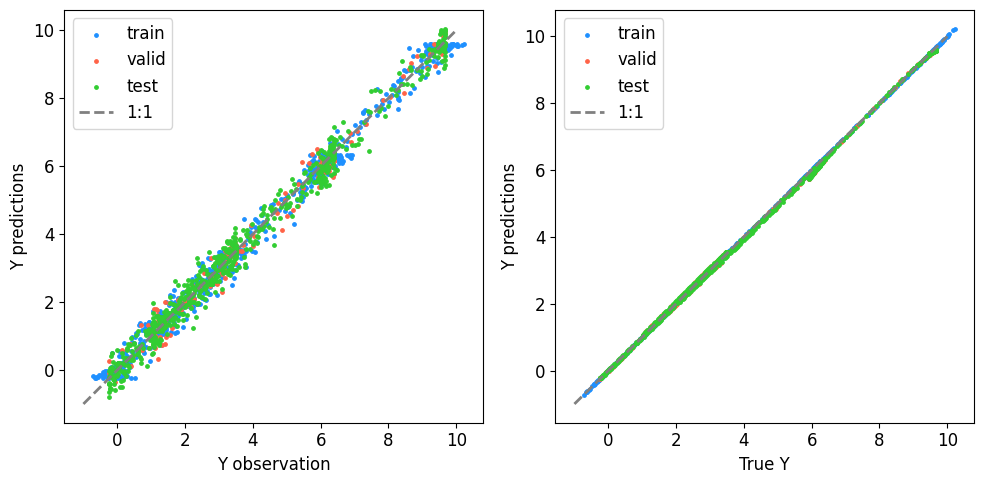



Setting up the dummy function and its latent function using nb_samples = 1520 ...
Splitting 56.00000000000001% of 1520 data set into training set ...
Building the Gaussian Process model without optimization ...
Making posterior Gaussian Process model ...
Making prediction in each point ...
Calculating the RMSE Error ...
Train RMSE of observed values: 0.30353
Test RMSE of observed values: 0.30831
Train RMSE of observed true values: 0.30353
Test RMSE of observed true values: 0.05080
Train RMSE of observed values: 0.02503
Test RMSE of latent function: 0.02540
Plotting results ...


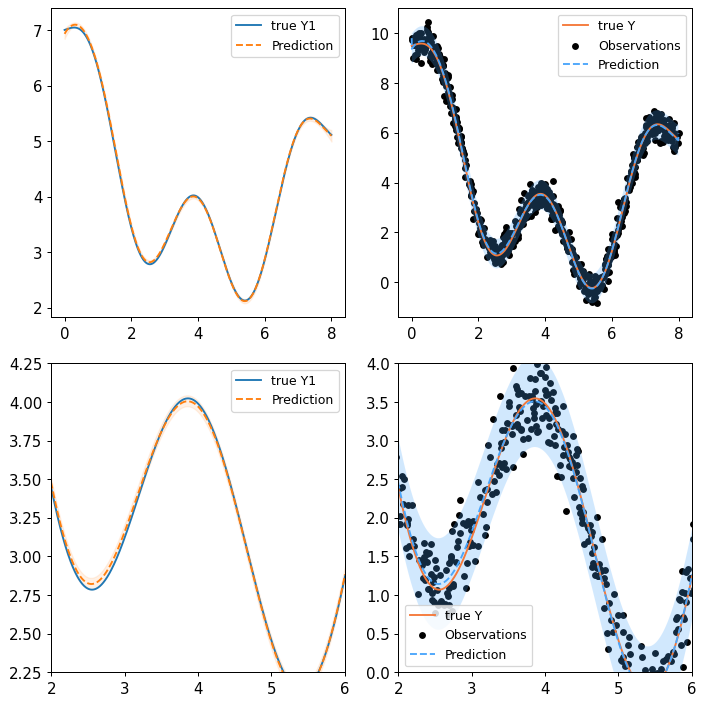

C:\Users\prima\AppData\Local\Programs\Python\virtualenv\Python39\lib\site-packages\wbml\plot.py:63: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  return f(*_convert(args), **_convert(kw_args))


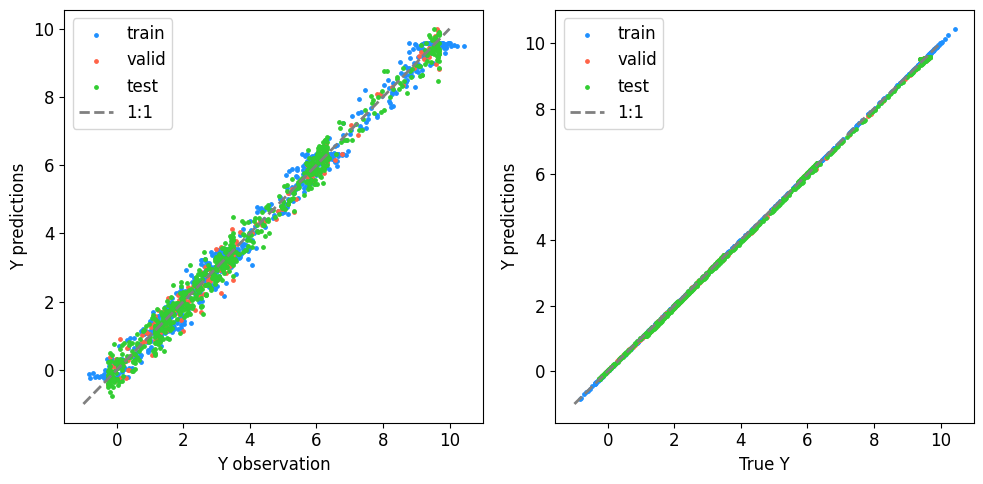

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import mean_squared_error

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    noise: Positive = 0.1,
    p: Positive = 2,
):
    with Measure():
#         f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) + u_var3 * GP(EQ().periodic(p)) # Construct Gaussian process.
        f = u_var * GP(EQ().periodic(p)) + u_var2*GP(Linear()).stretch(u_scale) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

def y1(x):
    return np.sin(x*2.)+ 0.2*x+2. +0.2*(x-5)**2

def y2(x):
    return -4.5+2*y1(x)

plot = True
scale =  False
optimize = False
train_size = 0.56

nb_samples = np.arange(20,1570,50)
# nb_samples = [15,50, 100,500,1000,3000]
# nb_samples = np.arange(20,1420,50)

rms = []
for nb_sample in nb_samples:
    
    x_obs = B.linspace(0.,8.,nb_sample)
    x_model = B.linspace(0.,8.,int(max(nb_samples)-0.1*max(nb_samples)))
    
    rms_test, rms_valid, rms_train = gp_dummy_compute_plot(train_size, nb_sample, x_obs, x_model, y1, y2, plot, scale, optimize)
    rms.append([rms_test, rms_valid, rms_train])
    

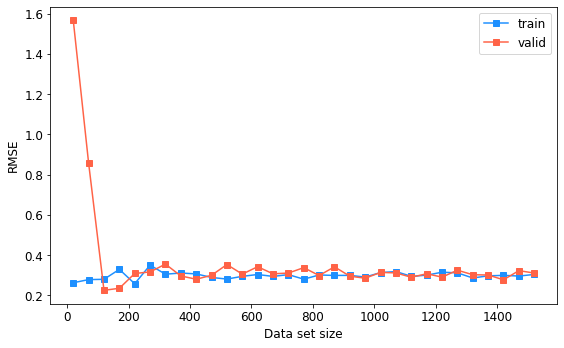

In [20]:
rms_test = [rms[i][0] for i in range(len(rms))]
rms_valid = [rms[i][1] for i in range(len(rms))]
rms_train = [rms[i][2] for i in range(len(rms))]
# print(rms_train)

plt.figure(figsize=(8,5))
# plt.style.use('seaborn-whitegrid') # nice and clean grid
# plt.plot(train_sizes,rms1_test,'-o',label='Training')

c1 = 'dodgerblue'
c2 = 'tomato'
c3 = 'limegreen'

plt.plot(nb_samples,rms_train,'s-',color=c1, label='train')
plt.plot(nb_samples,rms_valid,'s-',color=c2, label='valid')
# plt.plot(nb_samples,rms_test,'o-',color=c2, label='test')

plt.xlabel('Data set size')
plt.ylabel('RMSE')
plt.legend()
# plt.ylim(0,1)
plt.show()

## 3. Before and after the optimisation

### 1 parameters to optimise (u_var+ noise)
+ 200 observed data

Prior:      GP(-4.5 * 1, 4.0 * (1.000e+04 * EQ() + Linear()))
Prior:      GP(-4.5 * 1, 4.0 * (5.631 * EQ() + Linear()))
u_var:      2.373
noise:      0.08287


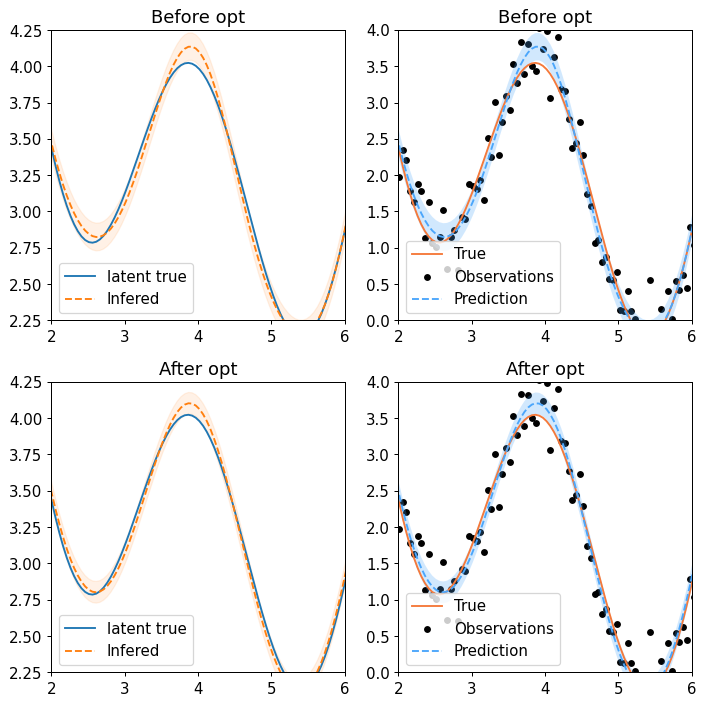

In [22]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 200

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()) + GP(Linear()) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

#pour voir avant l'optimisation
f, f2, noise = model(vs)
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)
mean_b, lower_b, upper_b = f_post(x_obs).marginal_credible_bounds()
mean2_b, lower2_b, upper2_b  = f2_post(x_obs).marginal_credible_bounds()
out.kv("Prior", f2.display(out.format))

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

# Plot result.

plt.figure(figsize=(8,8), dpi=90)
xlg = 2
xld = 6
ylb = 0
ylh = 4


plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()
plt.show()

### 4 parameters to optimise (u_var, u_var2, u_scale, u_scale2 (stretch on EQ and Linear) + noise)
Before/after optimisation

+ 200 observed data

Prior:      GP(-4.5 * 1, 4.0 * (1.000e+04 * (EQ() > 1.0) + 1.000e+04 * (Linear() > 10.0)))
Prior:      GP(-4.5 * 1, 4.0 * (13.92 * (EQ() > 1.446) + 737.3 * (Linear() > 36.83)))
u_var:      3.731
u_var2:     27.15
u_scale:    1.446
u_scale2:   36.83
noise:      0.09378


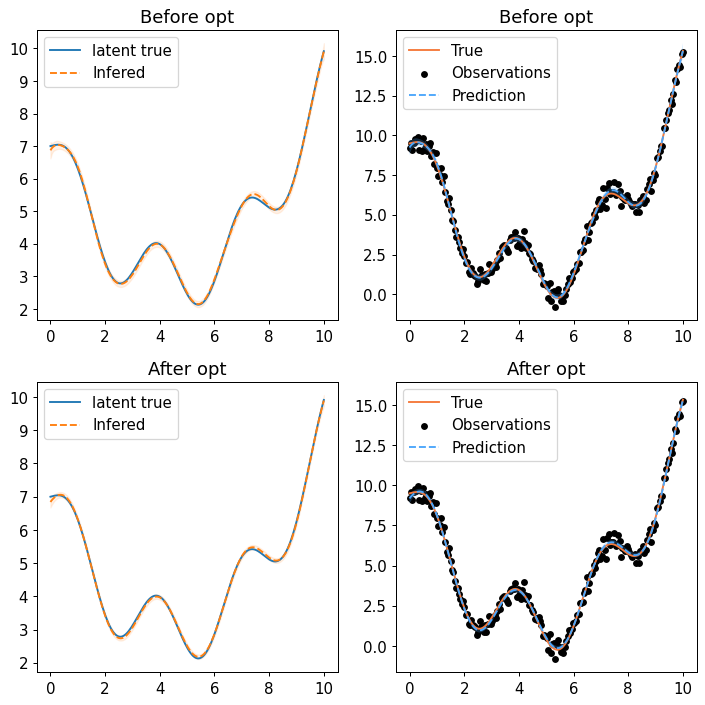

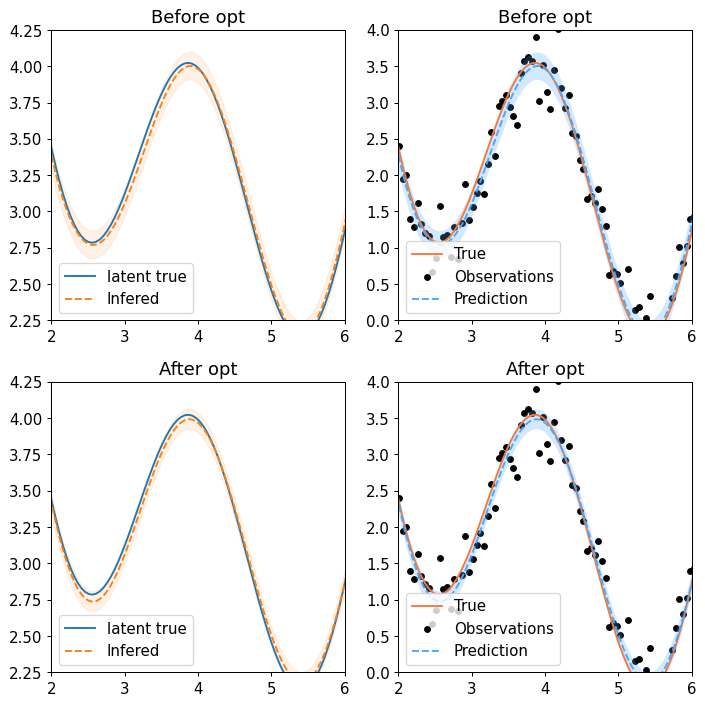

In [23]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 200

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    u_scale2: Positive = 10,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

#pour voir avant l'optimisation
f, f2, noise = model(vs)
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)
mean_b, lower_b, upper_b = f_post(x_obs).marginal_credible_bounds()
mean2_b, lower2_b, upper2_b  = f2_post(x_obs).marginal_credible_bounds()
out.kv("Prior", f2.display(out.format))

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()


# Plot result.

plt.figure(figsize=(8,8), dpi=90)
plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()

plt.figure(figsize=(8,8), dpi=90)
xlg = 2
xld = 6
ylb = 0
ylh = 4


plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()
plt.show()

+ 500 observed data

Prior:      GP(-4.5 * 1, 4.0 * (1.000e+04 * (EQ() > 1.0) + 1.000e+04 * (Linear() > 10.0)))
Prior:      GP(-4.5 * 1, 4.0 * (15.83 * (EQ() > 1.491) + 812.1 * (Linear() > 35.09)))
u_var:      3.979
u_var2:     28.5
u_scale:    1.491
u_scale2:   35.09
noise:      0.08598


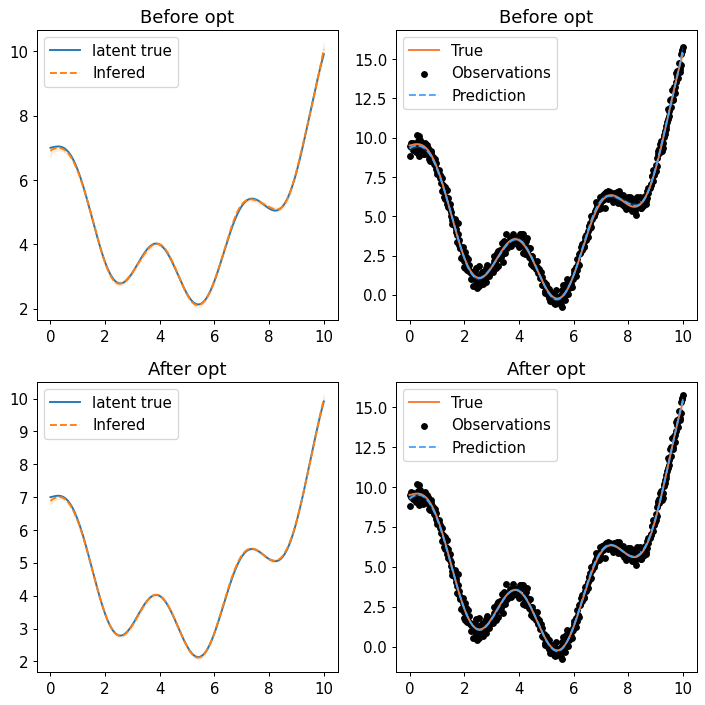

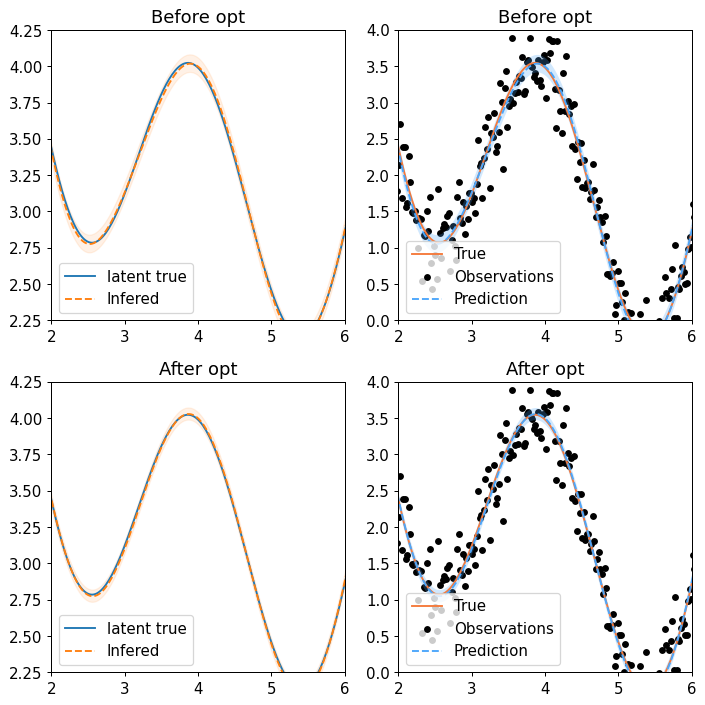

In [24]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 500

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    u_scale2: Positive = 10,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

#pour voir avant l'optimisation
f, f2, noise = model(vs)
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)
mean_b, lower_b, upper_b = f_post(x_obs).marginal_credible_bounds()
mean2_b, lower2_b, upper2_b  = f2_post(x_obs).marginal_credible_bounds()
out.kv("Prior", f2.display(out.format))

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()


# Plot result.

plt.figure(figsize=(8,8), dpi=90)
plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()

plt.figure(figsize=(8,8), dpi=90)
xlg = 2
xld = 6
ylb = 0
ylh = 4


plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()
plt.show()

+ 500 observed data
+ with an EQ periodic in addition

Prior:      GP(-4.5 * 1, 4.0 * (1.000e+04 * (EQ() > 1.0) + 1.000e+04 * (Linear() > 10.0) + EQ() per 2.0))
Prior:      GP(-4.5 * 1, 4.0 * (12.95 * (EQ() > 1.399) + 838.6 * (Linear() > 34.53) + EQ() per 2.128))
u_var:      3.599
u_var2:     28.96
u_scale:    1.399
u_scale2:   34.53
noise:      0.08952
p:          2.128


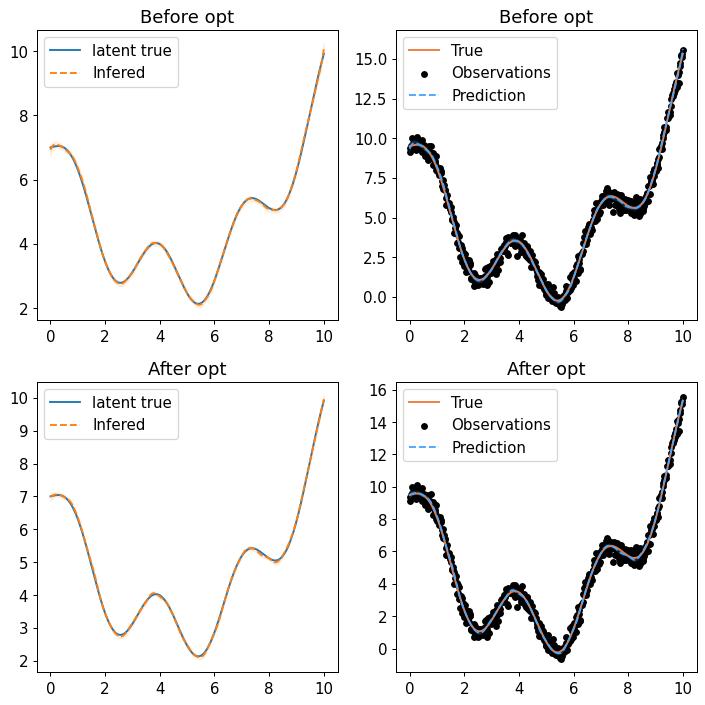

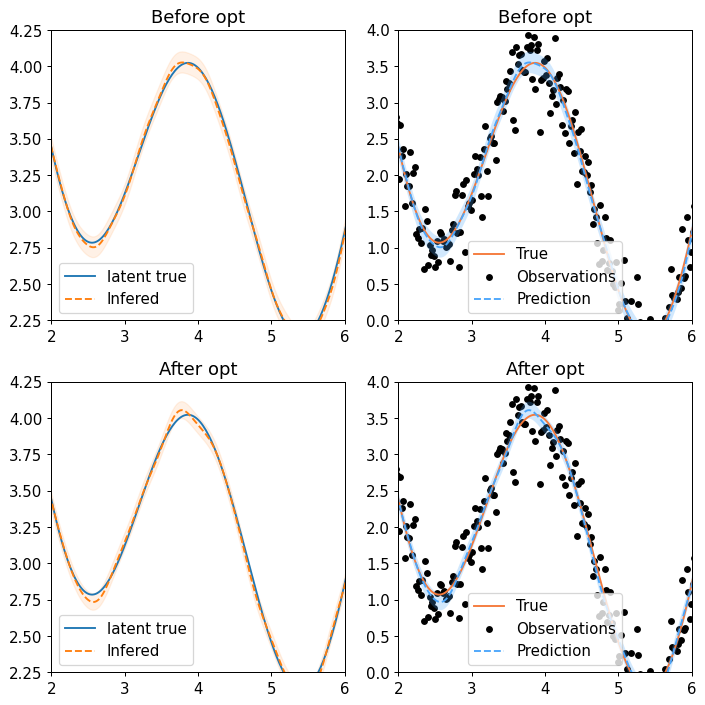

In [25]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 500

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    u_scale2: Positive = 10,
    noise: Positive = 0.1,
    p: Positive = 2,
):
    with Measure():
        f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) +GP(EQ().periodic(p)) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

#pour voir avant l'optimisation
f, f2, noise = model(vs)
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)
mean_b, lower_b, upper_b = f_post(x_obs).marginal_credible_bounds()
mean2_b, lower2_b, upper2_b  = f2_post(x_obs).marginal_credible_bounds()
out.kv("Prior", f2.display(out.format))

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()


# Plot result.

plt.figure(figsize=(8,8), dpi=90)
plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
#plt.xlim(xlg,xld)
#plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
#plt.xlim(xlg,xld)
#plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()

plt.figure(figsize=(8,8), dpi=90)
xlg = 2
xld = 6
ylb = 0
ylh = 4


plt.subplot(223)

plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower, upper, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('After opt')
plt.legend()

plt.subplot(224)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2, upper2, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('After opt')
plt.legend()

plt.subplot(221)


plt.plot(x_obs,y1,label="latent true")
plt.plot(x_obs, mean_b, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_b, upper_b, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.title('Before opt')
plt.legend()

plt.subplot(222)

plt.plot(x_obs, y2, label="True", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_b, label="Prediction", style="pred")
plt.fill_between(x_obs, lower2_b, upper2_b, style="pred")
plt.xlim(xlg,xld)
plt.ylim(ylb,ylh)
plt.title('Before opt')
plt.legend()

plt.tight_layout()
plt.show()

## 4. Making multiplot of all kernel

### predict using EQ + linear

In [26]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 1000

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100.,
    u_scale: Positive = 1,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()) # Construct Gaussian process.
         
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

RMSE = np.sqrt(mean_squared_error(y_obs, mean2))
print(RMSE)

mean_eq = mean
mean2_eq = mean2
lower_eq = lower
lower2_eq = lower2
upper_eq = upper
upper2_eq = upper2

Prior:      GP(-4.5 * 1, 4.0 * (15.8 * (EQ() > 1.456) + 0.5899 * Linear()))
u_var:      3.975
u_var2:     0.768
u_scale:    1.456
noise:      0.0912
0.29996096379646126


### predict using exp + linear

In [27]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear, Exp

# Some stupid model with a latent function
nb_samples = 1000

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100.,
    u_scale: Positive = 1,
    noise: Positive = 0.1,
):
    with Measure():
        f = u_var*GP(Exp()).stretch(u_scale) + u_var2*GP(Linear()) # Construct Gaussian process.
         
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

RMSE = np.sqrt(mean_squared_error(y_obs, mean2))
print(RMSE)

mean_exp = mean
mean2_exp = mean2
lower_exp = lower
lower2_exp = lower2
upper_exp = upper
upper2_exp = upper2

Prior:      GP(-4.5 * 1, 4.0 * (54.69 * (Matern12() > 297.7) + 0.06033 * Linear()))
u_var:      7.395
u_var2:     0.2456
u_scale:    297.7
noise:      0.08051
0.25227511840442435


### predict using periodic + linear

In [28]:
import matplotlib.pyplot as plt
import tensorflow as tf
import wbml.out as out
from varz.spec import parametrised, Positive
from varz.tensorflow import Vars, minimise_l_bfgs_b
from wbml.plot import tweak

from stheno.tensorflow import B, Measure, GP, EQ, Delta, Linear

# Some stupid model with a latent function
nb_samples = 1000

x_obs = B.linspace(0., 10., nb_samples)

# the latent functions
y1 = np.sin(x_obs*2.)+ 0.2*x_obs+2. +0.2*(x_obs-5)**2
# the final function
y2 = -4.5+2*y1
noise_ = np.random.randn(nb_samples)*0.3 # some noise
y_obs = y2 + noise_ # Observations

@parametrised
def model(
    vs,
    u_var: Positive = 100.,
    u_var2: Positive = 100,
    u_scale: Positive = 1,
    u_scale2: Positive = 1,
    noise: Positive = 0.1,
    p: Positive = 2,
):
    with Measure():
#         f = u_var*GP(EQ()).stretch(u_scale) + u_var2*GP(Linear()).stretch(u_scale2) + u_var3 * GP(EQ().periodic(p)) # Construct Gaussian process.
#         f = u_var * GP(EQ().periodic(p)) + u_var2*GP(Linear()).stretch(u_scale) # Construct Gaussian process.
        f = u_var*GP(EQ()).stretch(u_scale)+GP(EQ().periodic(p)) # Construct Gaussian process.
        f2 = -4.5+tf.cast(2.0, tf.float64)*f
        
    return f, f2, noise

# Sample a true, underlying function and observations.
vs = Vars(tf.float64)

def objective(vs):
    f, f2, noise = model(vs)
    evidence = f2(x_obs, noise).logpdf(y_obs)
    return -evidence

# Learn hyperparameters.
minimise_l_bfgs_b(objective, vs, jit=True)
f, f2, noise = model(vs)

# Print the learned parameters.
out.kv("Prior", f2.display(out.format))
vs.print()

# Condition on the observations to make predictions.
f2_post = f2 | (f2(x_obs, noise), y_obs)
f_post = f | (f2(x_obs, noise), y_obs)

#x_preds = np.linspace(0.,10.,100.)
mean, lower, upper = f_post(x_obs).marginal_credible_bounds()
mean2, lower2, upper2 = f2_post(x_obs).marginal_credible_bounds()

RMSE = np.sqrt(mean_squared_error(y_obs, mean2))
print(RMSE)

mean_per = mean
mean2_per = mean2
lower_per = lower
lower2_per = lower2
upper_per = upper
upper2_per = upper2

Prior:      GP(-4.5 * 1, 4.0 * (480.4 * (EQ() > 11.75) + EQ() per 6.283))
u_var:      21.92
u_var2:     100.0
u_scale:    11.75
u_scale2:   1.0
noise:      0.09436
p:          6.283
0.3049847994128366


### Result plotting (not zoomed in)

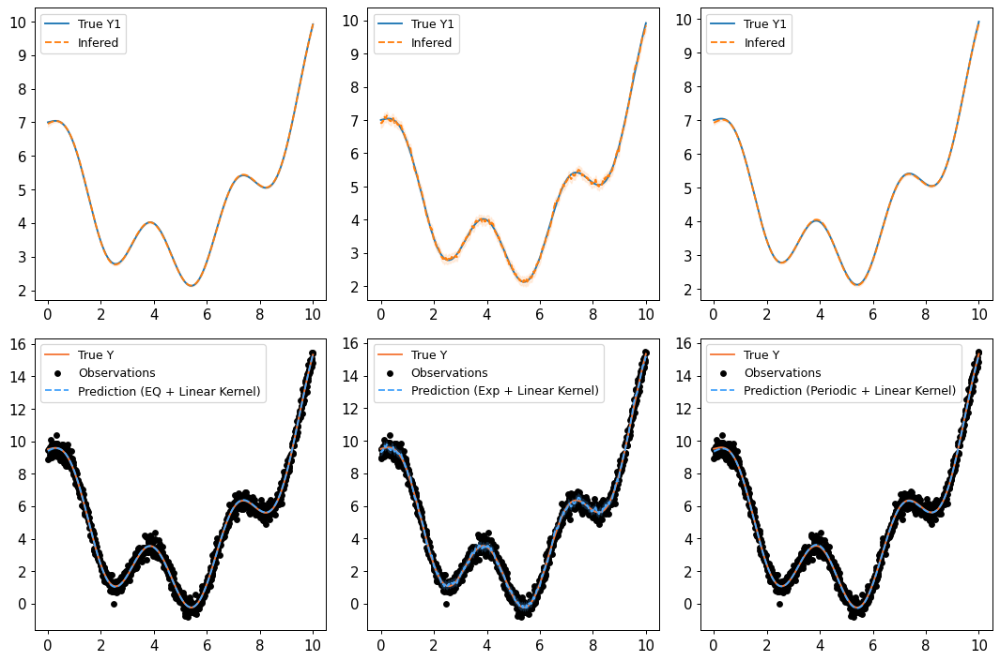

In [30]:
plt.figure(figsize=(12,8), dpi=90)

plt.subplot(231)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_eq, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_eq, upper_eq, color="C1", alpha = 0.1)
plt.xlim()
plt.legend(fontsize=10)

plt.subplot(234)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_eq, label="Prediction (EQ + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_eq, upper2_eq, style="pred")
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend(fontsize=10)

plt.subplot(232)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_exp, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_exp, upper_exp, color="C1", alpha = 0.1)
plt.xlim()
plt.legend(fontsize=10)

plt.subplot(235)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_exp, label="Prediction (Exp + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_exp, upper2_exp, style="pred")
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend(fontsize=10)

plt.subplot(233)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_per, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_per, upper_per, color="C1", alpha = 0.1)
plt.xlim()
plt.legend(fontsize=10)

plt.subplot(236)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_per, label="Prediction (Periodic + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_per, upper2_per, style="pred")
#plt.xlim(2,6)
#plt.ylim(0,4)
plt.legend(fontsize=10)


### Result plotting (zoomed in)

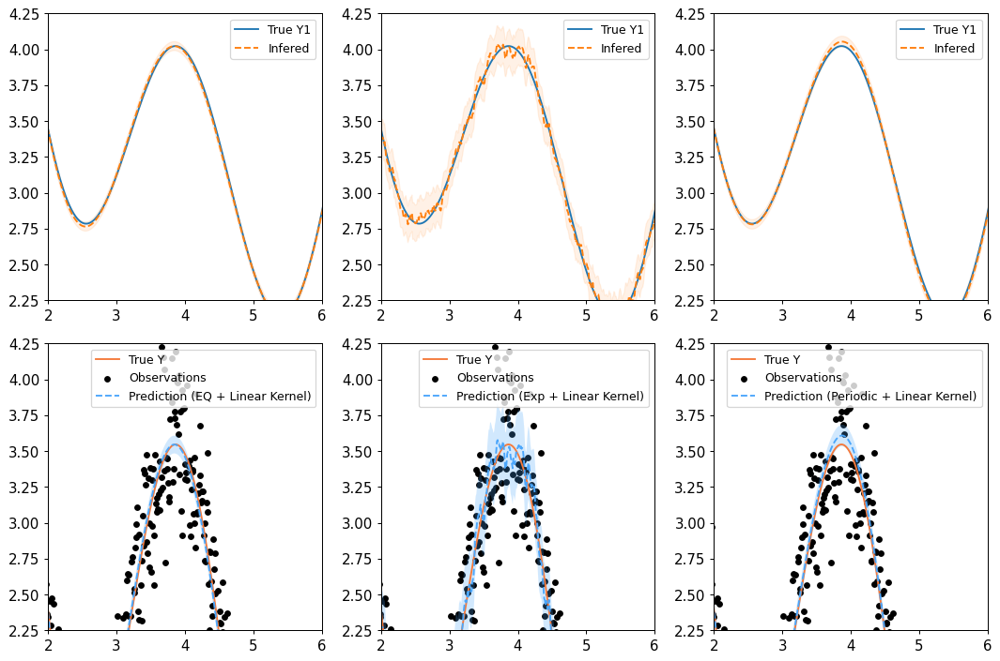

In [32]:
xlg = 2
xld = 6
ylb = 0
ylh = 4

plt.figure(figsize=(12,8), dpi=90)

plt.subplot(231)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_eq, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_eq, upper_eq, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)

plt.subplot(234)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_eq, label="Prediction (EQ + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_eq, upper2_eq, style="pred")
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)

plt.subplot(232)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_exp, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_exp, upper_exp, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)

plt.subplot(235)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_exp, label="Prediction (Exp + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_exp, upper2_exp, style="pred")
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)

plt.subplot(233)
plt.plot(x_obs,y1,label="True Y1")
plt.plot(x_obs, mean_per, "--", color="C1", label="Infered")
plt.fill_between(x_obs, lower_per, upper_per, color="C1", alpha = 0.1)
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)

plt.subplot(236)
plt.plot(x_obs, y2, label="True Y", style="test")
plt.scatter(x_obs, y_obs, label="Observations", style="train", s=20)
plt.plot(x_obs, mean2_per, label="Prediction (Periodic + Linear Kernel)", style="pred")
plt.fill_between(x_obs, lower2_per, upper2_per, style="pred")
plt.xlim(xlg,xld)
plt.ylim((ylb+4.5)/2,(ylh+4.5)/2)
plt.legend(fontsize=10)
